In [5]:
import copy
import networkx as nx
import heapq
from scipy.spatial.distance import euclidean, cityblock
from itertools import product
import numpy as np
from typing import Union
import math
from decimal import Decimal
from IPPlanerBase import PlanerBase
from IPPerfMonitor import IPPerfMonitor

from IPAStar import AStar

import IPBasicPRM
import IPVISBasicPRM
import IPVisibilityPRM
import IPVISVisibilityPRM


import IPLazyPRM
import IPVISLazyPRM

import IPAStar
import IPVISAStar
import IPAStarAdapted

# import IPTestSuite
import IPTestSuiteSS2024
import importlib

# Evaluation
import numpy as np
import os
import numpy as np
from scipy.spatial.distance import euclidean
from dataclasses import dataclass
import matplotlib.pyplot as plt

# Discretized A-Star (Task I.1)

Implementation of the discretized A*. Inherits from the old A*-class.
Contains only the methods that were adopted.

- n_steps number of steps we discretize each dimension for
- step_size for each dimension $step\_size = \frac{|upper - lower|}{n\_steps}$
- Check if the goal is close to the point due to floating point precision
- Check for line collisions
- HandleNode to calculate the neighbors according to step_size
- Update costs according to step_size of the dimension


In [6]:
class DiscretizedAStar(AStar):
    def __init__(self, collChecker = 0):
        """Contructor:
        Initialize all necessary members"""
        
        super(DiscretizedAStar,self).__init__(collChecker)
        
        self.limits = self._collisionChecker.getEnvironmentLimits()
        self.n_steps = None # number of discretization steps for each dimension
        self.step_sizes = [] # step size for each dimension
        return
    

    def _initialize_n_steps(self, n_steps: Union[int,str,None]) -> None:
        """ 
        Sets the discretization size for each configuration 
        
        n_steps: Discretization steps
        """
        if n_steps is None:
            # Default step size of 1 if not provided
            self.n_steps = [int(abs(upper_value - lower_value)) for [lower_value, upper_value] in self.limits]
        elif isinstance(n_steps, list):
            # Ensure nsteps is the same length as limits
            if len(n_steps) == len(self.limits):
                self.n_steps = n_steps
            else:
                raise ValueError("nsteps list must be the same length as limits")
        elif isinstance(n_steps, int):
            # Single step size applied to all dimensions
            self.n_steps = [n_steps] * len(self.limits)
        else:
            raise ValueError("n_steps must be a list or an int")

    def _initialize_step_sizes(self):
        for i, steps in enumerate(self.n_steps):
            (lower_bound, upper_bound) = self.limits[i]
            self.step_sizes.append(abs(upper_bound - lower_bound) / steps)

    @IPPerfMonitor
    def planPath(self, startList, goalList, config):
        """Plan a path from startList to goalList using A* algorithm"""
        # 0. reset
        self.graph.clear()
        
        # 1. Setup parameters 
        self.w = config["w"]
        self.heuristic = config["heuristic"]
        self.initial_start = copy.copy(startList[0])
        self.initial_goal = copy.copy(goalList[0])

        # MODIFIED: Set step sizes and configure if path should be checked
        n_steps = config["n_steps"]
        self._initialize_n_steps(n_steps)
        self._initialize_step_sizes()
        self.shouldCheckPath = config["shouldCheckPath"]

        # 2. check start and goal whether collision-free (s. BaseClass)
        checkedStartList, checkedGoalList = self._checkStartGoal(copy.copy(startList), copy.copy(goalList))

        if len(checkedStartList) == 0 or len(checkedGoalList) == 0:
            print("Start or end goal not valid")
            return None
        self.goal = copy.copy(checkedGoalList[0])
        self.start = copy.copy(checkedStartList[0])

        self.start = self.correct_node_position(self.start, False, self.initial_goal)
        if not self.start:
            print("Discretized start neighbors not valid")
            return None
        self.goal = self.correct_node_position(self.goal, False, self.initial_start)
        if not self.goal:
            print("Discretized goal neighbors not valid")
            return None

        self._addGraphNode(self.start)
        currentBestName = self._getBestNodeName()
        if currentBestName == None:
            print("No solution found (1)")
            return None

        while currentBestName:

            currentBest = self.graph.nodes[currentBestName]

            if not self.isInGrid(currentBestName):
                pos = currentBest["pos"]
                print(f"Node not in grid = [{pos[0]}, {pos[1]}]")

            # MODIFIED
            if self._collisionChecker.pointInCollision(currentBest["pos"]) or (self.shouldCheckPath and self._checkPathCollision(currentBestName)):
                currentBest['collision'] = 1
                currentBestName = self._getBestNodeName()
                if currentBestName == None:
                    print("No solution found (2)")
                    return None
                continue

            # Goal found
            if self._isClose(currentBest["pos"], self.goal):
                self.solutionPath = []
                self._collectPath(currentBestName, self.solutionPath)
                self.goalFound = True
                break
            currentBest["status"] = 'closed'

            self.graph.nodes[currentBestName]['collision'] = 0
            self._handleNode9(currentBestName)
            currentBestName = self._getBestNodeName()
            if currentBestName == None:
                print("No solution found (3)")
                return None
        if self.goalFound:
            return self.solutionPath
        else:
            return None

    def _getBestNodeName(self):
        """Returns the best name of best node"""
        if len(self.openList) > 0:
            return heapq.heappop(self.openList)[1]
        else:
            return None

    def isInGrid(self, nodeName):
        """Check if a node is in the grid"""
        node = self.graph.nodes[nodeName]["pos"]
        for i in range(len(node)):
            low, high = self.limits[i]  # Get the low and high limits for the current dimension
            n_steps = self.n_steps[i]
            available_steps = np.linspace(low, high, self.n_steps[i] + 1)  # Generate grid points

            isClose = False
            for j in range(len(available_steps)):
                isClose = isClose or math.isclose(node[i], available_steps[j], rel_tol=1e-03, abs_tol=1e-03)
            if not isClose:
                print("Node not in grid")
                return False
        else:
            return True

    def _isClose(self, node1, node2):
        """Check if two nodes are close to each other (floating point check)"""
        for i in range(len(node1)):
            if not math.isclose(node1[i], node2[i], rel_tol=1e-03, abs_tol=1e-03):
                return False
        return True

    @IPPerfMonitor
    def _handleNode9(self, nodeName):
        """Generates possible successor positions also in diagonal direction"""
        result = []
        node = self.graph.nodes[nodeName]
        pos_length = len(node["pos"])
       
        for i in range(pos_length):
            for step_i in [-1, 1]:
                newPos = copy.copy(node["pos"])
                newPos[i] += step_i * self.step_sizes[i]
                if not self._inLimits(newPos):
                    continue
                try:
                    # Do not do reopening! If node already in graph do not add it... Consequences?
                    self.graph.nodes[self._getNodeID(newPos)]
                    continue
                except:
                    pass
                if self._inLimits(newPos) and (not self._checkLineCollision(node["pos"], newPos) or not self.shouldCheckPath):
                    self._addGraphNode(newPos, i, nodeName)
        return result

    @IPPerfMonitor
    def _addGraphNode(self, pos, i=None, fatherName=None):
        """Add a node based on the position into the graph. Attention: Existing node is overwritten!"""
        self.graph.add_node(self._getNodeID(pos), pos=pos, status='open', g=0)
        if fatherName is not None:
            self.graph.add_edge(self._getNodeID(pos), fatherName)
            self.graph.nodes[self._getNodeID(pos)]["g"] = self.graph.nodes[fatherName]["g"] +  self.step_sizes[i]
        self._insertNodeNameInOpenList(self._getNodeID(pos))

    def _checkPathCollision(self, nodeName: str, num_steps=20) -> bool:
        """ Check for collision along the path segment between pos1 and pos2 """
        # Get nodes and positions
        father_node = self.get_father_node(nodeName)
 
        # No father exists (start node)
        if father_node is None:
            return False
 
        current_node = self.graph.nodes[nodeName]
 
        return self._checkLineCollision(current_node["pos"], father_node["pos"], num_steps)

    def get_father_node(self, node_id):
        """Retrieve the father node for a given node ID."""
        successors = list(self.graph.successors(node_id))
        if successors:
            return self.graph.nodes[successors[0]]
        return None

    def _checkLineCollision(self, pos1, pos2, num_steps=20) -> bool:
        """ Check for collision along the path segment between pos1 and pos2 """
       
        # Add intermediate position point and check this new point for collision
        for step in range(1, num_steps + 1):
            ratio = step / num_steps
            intermediate_pos = [pos1[i] + (pos2[i] - pos1[i]) * ratio for i in range(len(pos1))]
            if self._collisionChecker.pointInCollision(intermediate_pos):
                return True
        return False

    def get_neighbours(self, node):
        ''' Generate the neighbours of a given node '''
        neighbours = []
        for i in range(len(node)):
            pos = node[i]
            low, high = self.limits[i]  # Get the low and high limits for the current dimension
            step_size = self.n_steps[i]
            available_steps = np.linspace(low, high, self.n_steps[i] + 1)  # Generate grid points
 
            # Compute the absolute differences
            differences = np.abs(available_steps - pos)
            # Find the indices of the two smallest differences
            nearest_indices = np.argsort(differences)[:2]
            # Extract the values corresponding to these indices
            nearest_values = available_steps[nearest_indices]
 
            neighbours.append(nearest_values)
 
        # Generate all combinations of the nearest values from each dimension
        all_neighbours = list(product(*neighbours))
 
        # Yield the sorted combinations
        for neighbour in all_neighbours:
            yield neighbour

    def correct_node_position(self, node, sortByEuclideanDistance=True, targetNode = None):
        ''' Set each position to the nearest grid placement (discretize initial S and G) '''
        neighbors = []
        # Generate the neighbours of the current node
        for neighbour in self.get_neighbours(node):
            neighbors.append(neighbour)
            if len(neighbors) >= 1000:
                break
        if sortByEuclideanDistance:
            # Start node sort by eucidean distance
            distances = [euclidean(node, list(n)) for n in neighbors]
            sorted_nodes = [n for _, n in sorted(zip(distances, neighbors), key=lambda x: x[0])]
        else:
            # Goal node sort by heuristic distance
            distances = [euclidean(targetNode, list(n)) for n in neighbors]
            sorted_nodes = [n for _, n in sorted(zip(distances, neighbors), key=lambda x: x[0])]
 
        for current_neighbor in sorted_nodes:
            if not self._checkLineCollision(node, current_neighbor):
                for i in range(len(node)):
                    node[i] = current_neighbor[i]
                return node

        # Collision
        return None

    def aStarVisualize(planner, solution, ax = None, nodeSize = 300):
        graph = planner.graph
        collChecker = planner._collisionChecker
        # get a list of positions of all nodes by returning the content of the attribute 'pos'
        pos = nx.get_node_attributes(graph,'pos')
        color = nx.get_node_attributes(graph,'color')
        
        nodeSize = 1500 / planner.n_steps[0]
        edgeWidth = 20 / planner.n_steps[0]
        arrowSize = 100 / planner.n_steps[0]

        # draw graph (nodes colorized by degree)
        open_nodes = [node for node,attribute in graph.nodes(data=True) if attribute['status']=="open"]
        draw_nodes = nx.draw_networkx_nodes(graph, pos, node_color='#FFFFFF', nodelist=open_nodes, ax = ax, node_size=nodeSize)
        draw_nodes.set_edgecolor("b")
        closed_nodes = [node for node,attribute in graph.nodes(data=True) if attribute['status']=="closed"]
        draw_nodes = nx.draw_networkx_nodes(graph, pos, node_color='#0000FF', nodelist=closed_nodes, ax = ax, node_size=nodeSize)
        nx.draw_networkx_edges(graph,pos,
                                    edge_color='b',
                                    width=edgeWidth,
                                    arrowsize=arrowSize,
                                    style="-"
                                )

        collChecker.drawObstacles(ax)
        
        print(f"Initial start: [{planner.initial_start[0]}, {planner.initial_start[1]}]")
        print(f"Initial goal: [{planner.initial_goal[0]}, {planner.initial_goal[1]}]")
        
        if solution is not None:
            print(f"Start: [{planner.start[0]}, {planner.start[1]}]")
            print(f"Goal: [{planner.goal[0]}, {planner.goal[1]}]")
            
            # draw nodes based on solution path
            Gsp = nx.subgraph(graph,solution)
            nx.draw_networkx_nodes(Gsp,pos,
                                    node_size=nodeSize,
                                    node_color='g')
                
            # draw edges based on solution path
            nx.draw_networkx_edges(Gsp,pos,alpha=0.8,edge_color='g',width=edgeWidth,arrows=True,
                                    arrowsize=arrowSize)

            nx.draw_networkx_nodes(graph,pos,nodelist=[solution[0]],
                                    node_size=300,
                                    node_color='#00dd00',  ax = ax)
            nx.draw_networkx_labels(graph,pos,labels={solution[0]: "S"},  ax = ax)


            nx.draw_networkx_nodes(graph,pos,nodelist=[solution[-1]],
                                            node_size=300,
                                            node_color='#DD0000',  ax = ax)
            nx.draw_networkx_labels(graph,pos,labels={solution[-1]: "G"},  ax = ax)
        elif planner.start and planner.goal:
            ax.plot(planner.start[0], planner.start[1], "og", markersize=20)
            ax.plot(planner.goal[0], planner.goal[1], "or", markersize=20)

        ax.plot(planner.initial_start[0], planner.initial_start[1], "8g", markersize=20)
        ax.plot(planner.initial_goal[0], planner.initial_goal[1], "8r", markersize=20)

# Planners

Verwendet werden die Planner. Der diskretisiete A-Stern wird in unterschiedlichen Stufen verwendet. Dabei wird für jede Stufe ein A-Stern Planner erstellt.

- Visibility PRM
- Lazy PRM
- Discretized AStar (Stufen = \[10, 15, 25, 30, 100\])

In [7]:
plannerFactory = dict()

# AStars
discretizations = [10, 15,  25, 30, 50, 100, [11, 22]]

for disc in discretizations:
  astarConfig = dict()
  astarConfig["w"] = 0.5
  astarConfig["heuristic"]  = "euclidean"
  astarConfig["n_steps"] = disc
  astarConfig["shouldCheckPath"] = True
  plannerFactory[f"astar-{disc}"] = [DiscretizedAStar, astarConfig, DiscretizedAStar.aStarVisualize]

for disc in discretizations:
  astarConfig = dict()
  astarConfig["w"] = 0.5
  astarConfig["heuristic"]  = "euclidean"
  astarConfig["n_steps"] = disc
  astarConfig["shouldCheckPath"] = False
  plannerFactory[f"astar-{disc}-no-path-collision"] = [DiscretizedAStar, astarConfig, DiscretizedAStar.aStarVisualize]

# Visibility PRM
visbilityConfig = dict()
visbilityConfig["ntry"] = 300
plannerFactory["visibilityPRM"] = [IPVisibilityPRM.VisPRM, visbilityConfig, IPVISVisibilityPRM.visibilityPRMVisualize ]

# Lazy PRM
lazyConfig = dict()
lazyConfig["initialRoadmapSize"] = 10
lazyConfig["updateRoadmapSize"]  = 5 
lazyConfig["kNearest"] = 8
lazyConfig["maxIterations"] = 20
plannerFactory["lazyPRM"] = [IPLazyPRM.LazyPRM, lazyConfig, IPVISLazyPRM.lazyPRMVisualize]


In [8]:
class ResultCollection (object):
    
    def __init__(self, plannerFactoryName, planner, benchmark, solution, perfDataFrame):
        self.plannerFactoryName = plannerFactoryName
        self.planner = planner
        self.benchmark = benchmark
        self.solution = solution
        self.perfDataFrame = perfDataFrame

# Test environments

We used the already existing environments. In total, we have 11.

In [9]:
importlib.reload(IPTestSuiteSS2024)

fullBenchList = IPTestSuiteSS2024.benchList
fullBenchList = fullBenchList

print(f"Benchmarks N={len(fullBenchList)}:")

for benchmark in fullBenchList:
    print(f"  {benchmark.name}")

Benchmarks N=11:
  Trap
  Bottleneck
  Fat bottleneck
  Flower Field
  Pac-Man
  Star Obstacle
  IP Obstacle
  straight
  dots
  Narrow Crossings
  Game


# Planning

Execute all planners for each environment.

In [10]:
resultList = list()
testList = fullBenchList

for key,producer in list(plannerFactory.items()):
    print(key, producer)
    for benchmark in testList:
        print ("Planning: " + key + " - " + benchmark.name)
        planner = producer[0](benchmark.collisionChecker)
        IPPerfMonitor.clearData()

        resultList.append(ResultCollection(key,
                                        planner, 
                                        benchmark, 
                                        planner.planPath(benchmark.startList,benchmark.goalList,producer[1]),
                                        IPPerfMonitor.dataFrame()
                                        ),
                    )

astar-10 [<class '__main__.DiscretizedAStar'>, {'w': 0.5, 'heuristic': 'euclidean', 'n_steps': 10, 'shouldCheckPath': True}, <function DiscretizedAStar.aStarVisualize at 0x7f991d3bb790>]
Planning: astar-10 - Trap
Planning: astar-10 - Bottleneck
No solution found (3)
Planning: astar-10 - Fat bottleneck
No solution found (3)
Planning: astar-10 - Flower Field
Planning: astar-10 - Pac-Man
Discretized start neighbors not valid
Planning: astar-10 - Star Obstacle
Planning: astar-10 - IP Obstacle
Planning: astar-10 - straight
Planning: astar-10 - dots
Planning: astar-10 - Narrow Crossings
Discretized start neighbors not valid
Planning: astar-10 - Game
astar-15 [<class '__main__.DiscretizedAStar'>, {'w': 0.5, 'heuristic': 'euclidean', 'n_steps': 15, 'shouldCheckPath': True}, <function DiscretizedAStar.aStarVisualize at 0x7f991d3bb790>]
Planning: astar-15 - Trap
Planning: astar-15 - Bottleneck
Planning: astar-15 - Fat bottleneck
Planning: astar-15 - Flower Field
Planning: astar-15 - Pac-Man
Disc

## Planning visualization

For each result prints the environemnt and the found paths aswell as the roadmap.

In [11]:
# Options
visualize = True # print results
export = False # save prints

/home/marvin/miniconda3/envs/kitti38/lib/python3.8/site-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


Initial start: [10, 10]
Initial goal: [10, 5]
Start: [11.0, 11.0]
Goal: [11.0, 6.6000000000000005]


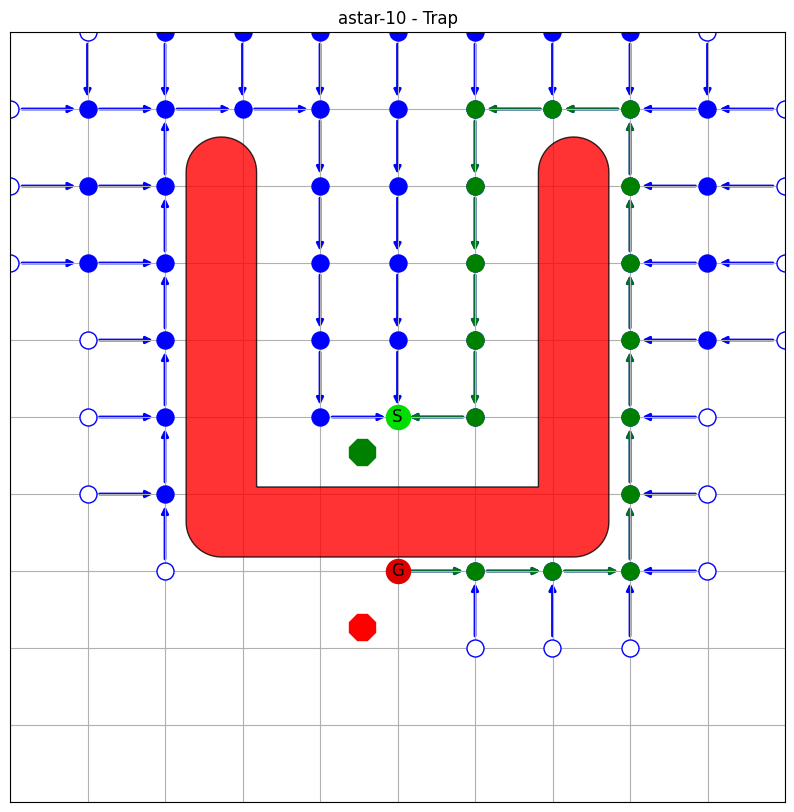

Initial start: [4, 15]
Initial goal: [18, 3]


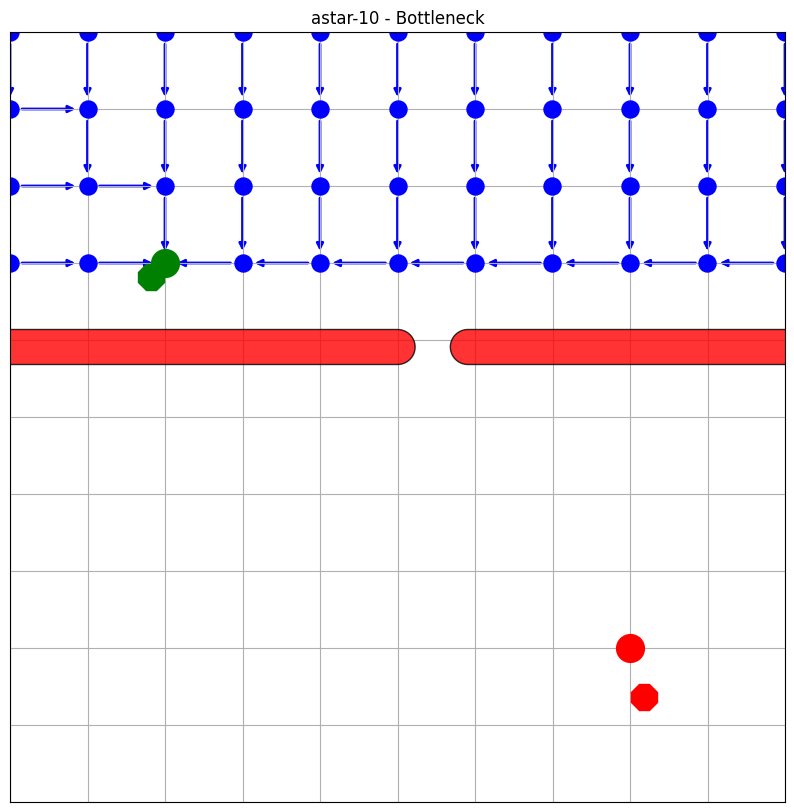

Initial start: [4, 18]
Initial goal: [18, 3]


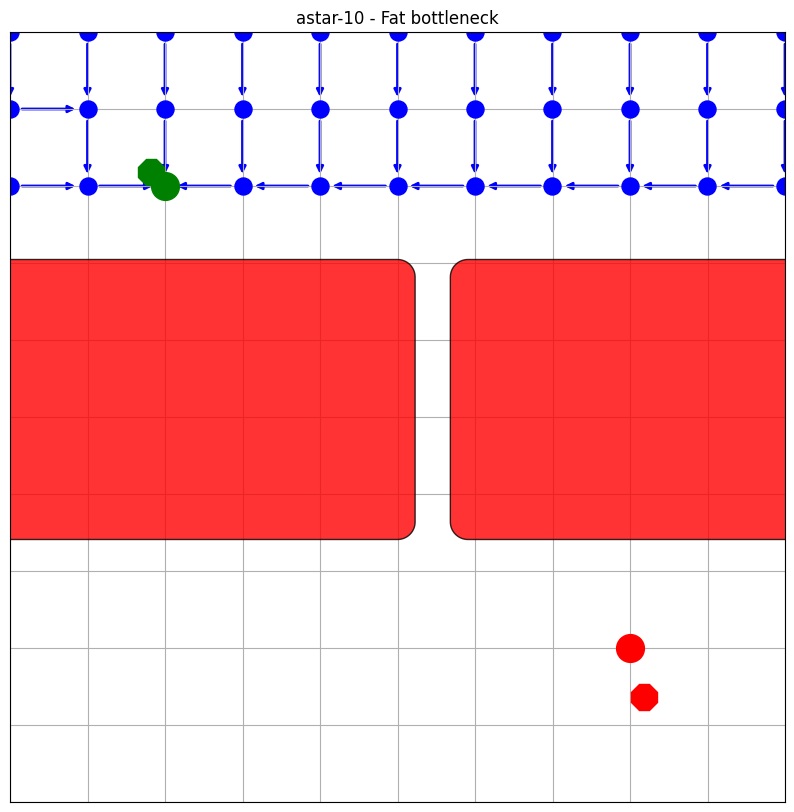

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [4.4, 8.8]
Goal: [17.6, 4.4]


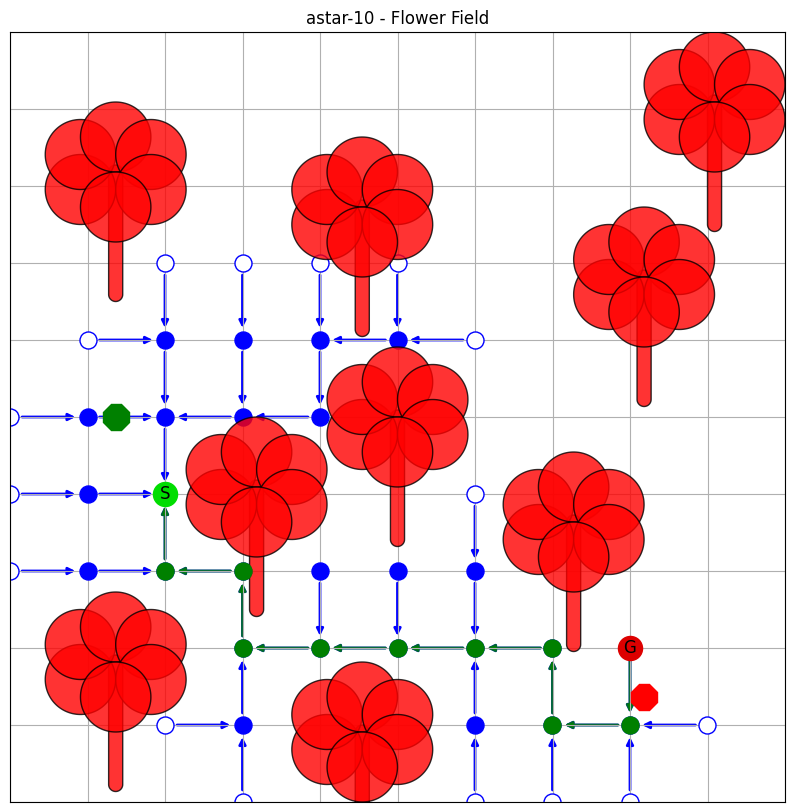

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]


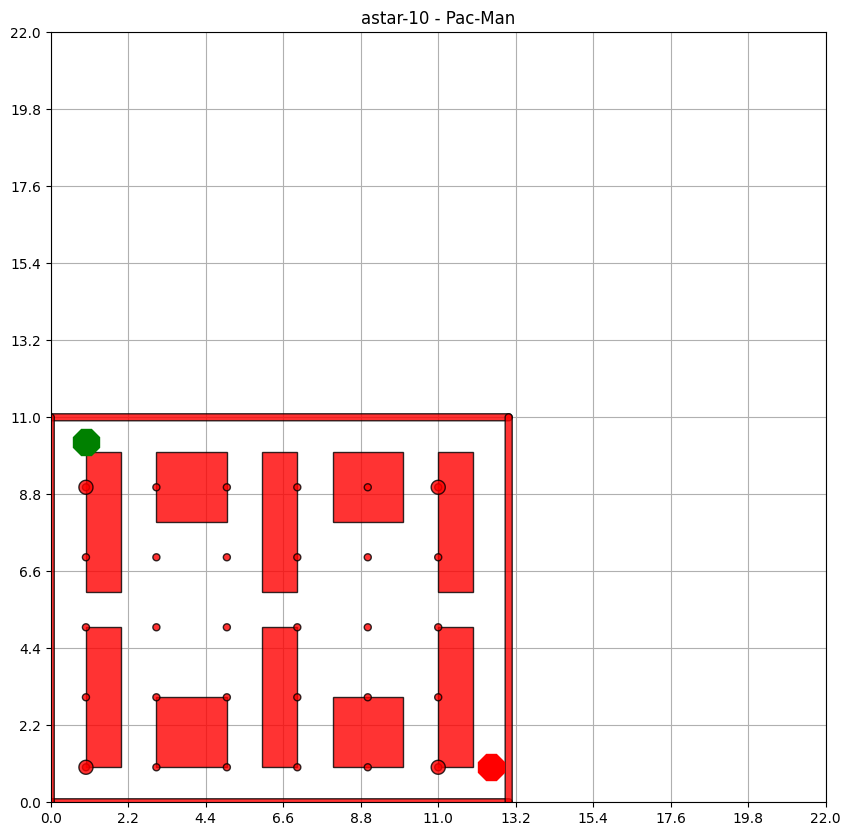

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [6.6000000000000005, 6.6000000000000005]
Goal: [19.8, 19.8]


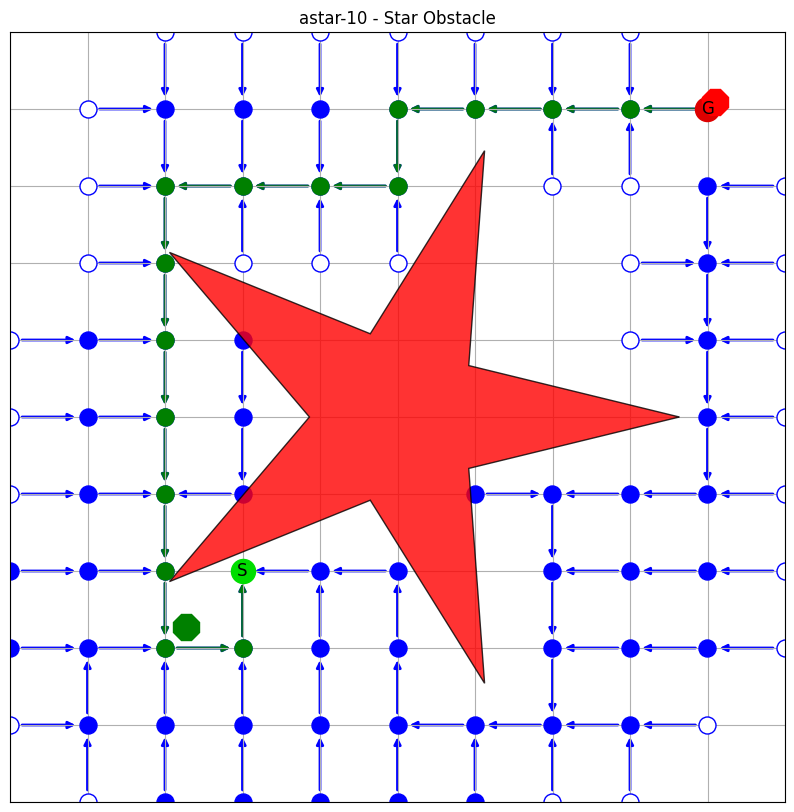

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.4, 4.4]
Goal: [19.8, 19.8]


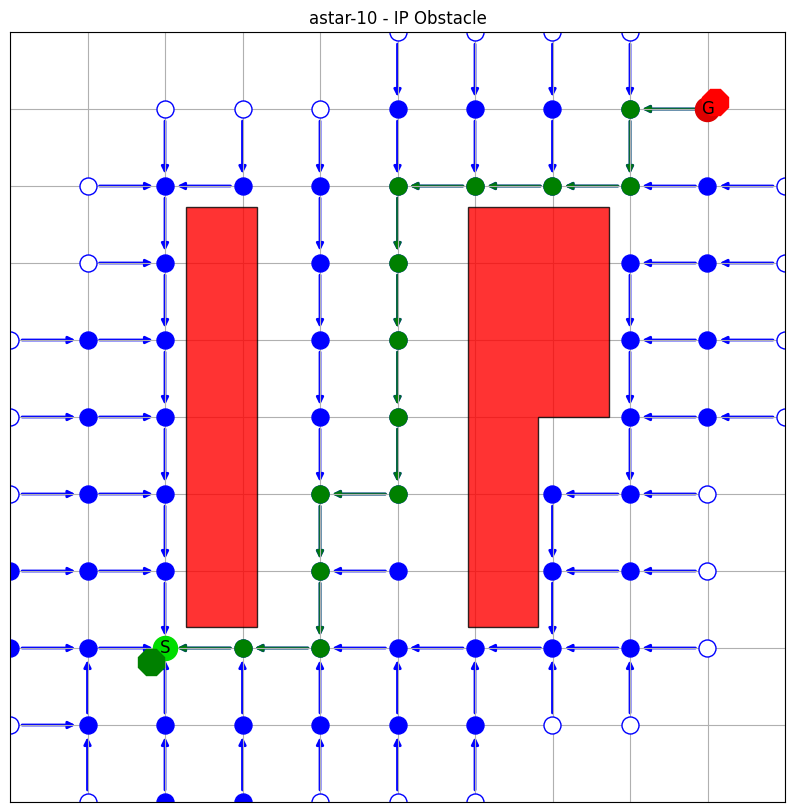

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.2]
Goal: [11.0, 19.8]


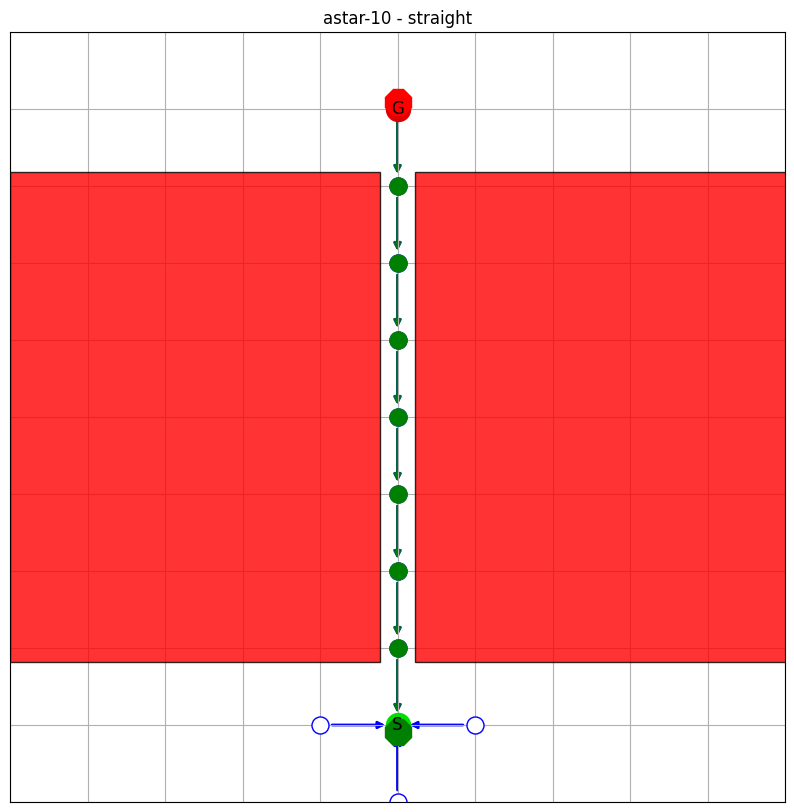

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [2.2, 2.2]
Goal: [19.8, 19.8]


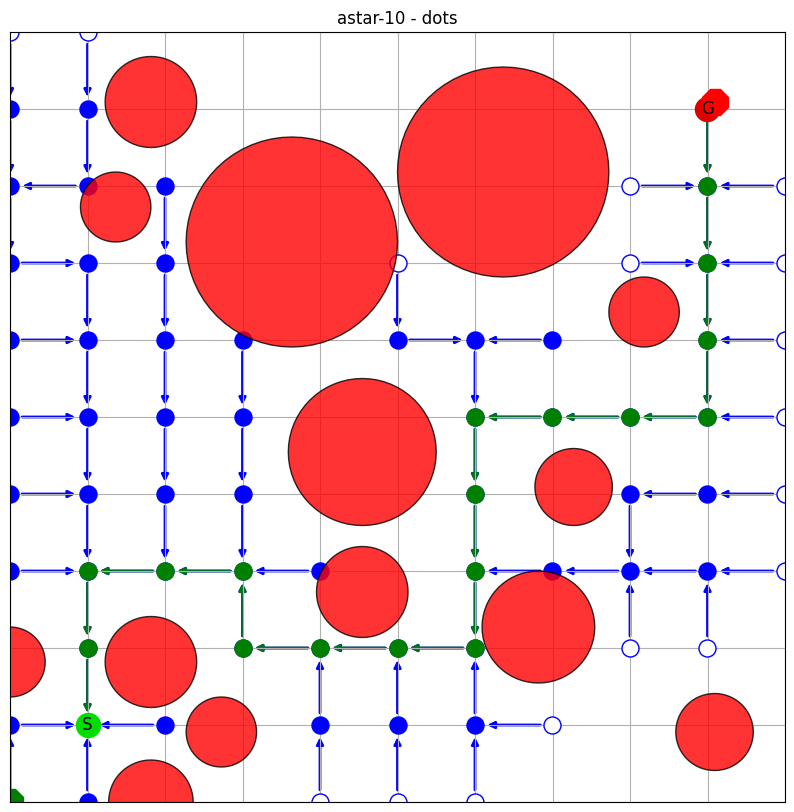

Initial start: [1.0, 5]
Initial goal: [21, 5.0]


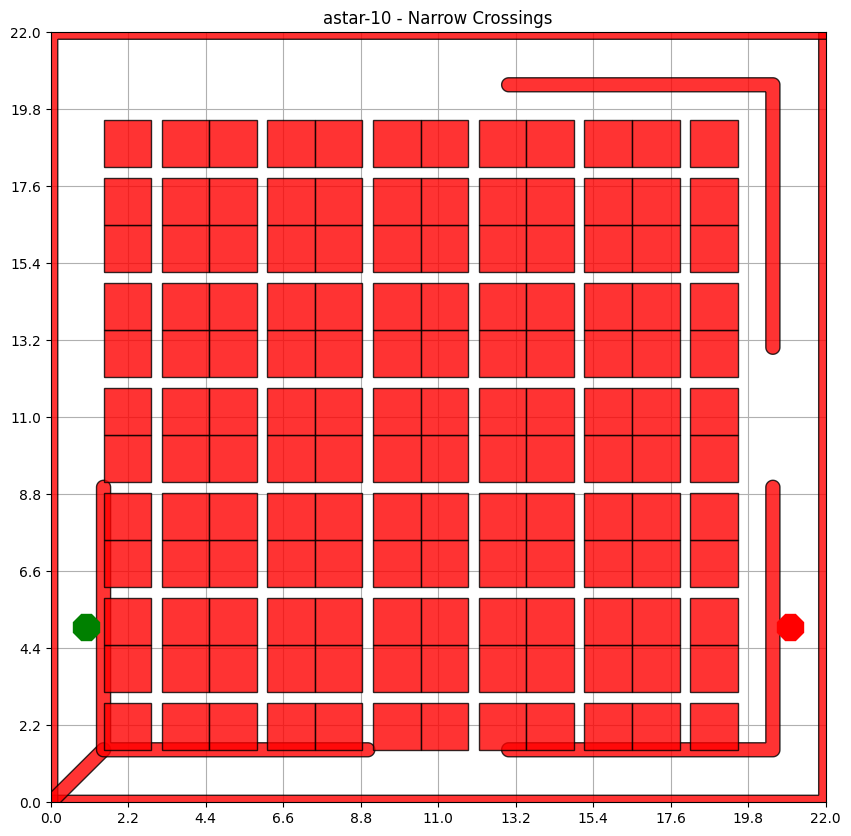

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [11.0, 2.2]
Goal: [17.6, 17.6]


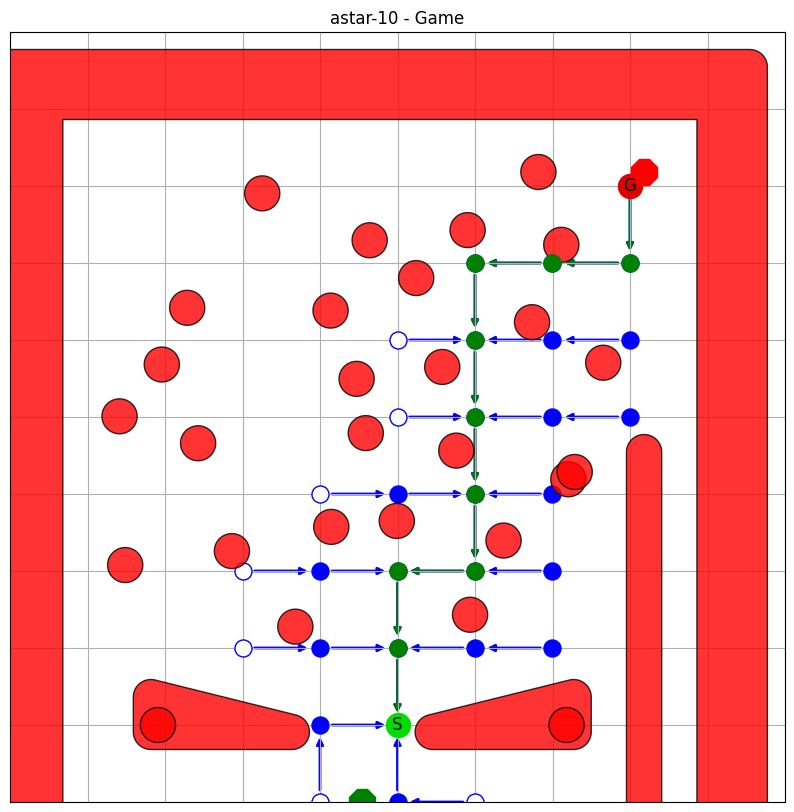

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.266666666666666, 10.266666666666666]
Goal: [10.266666666666666, 5.866666666666666]


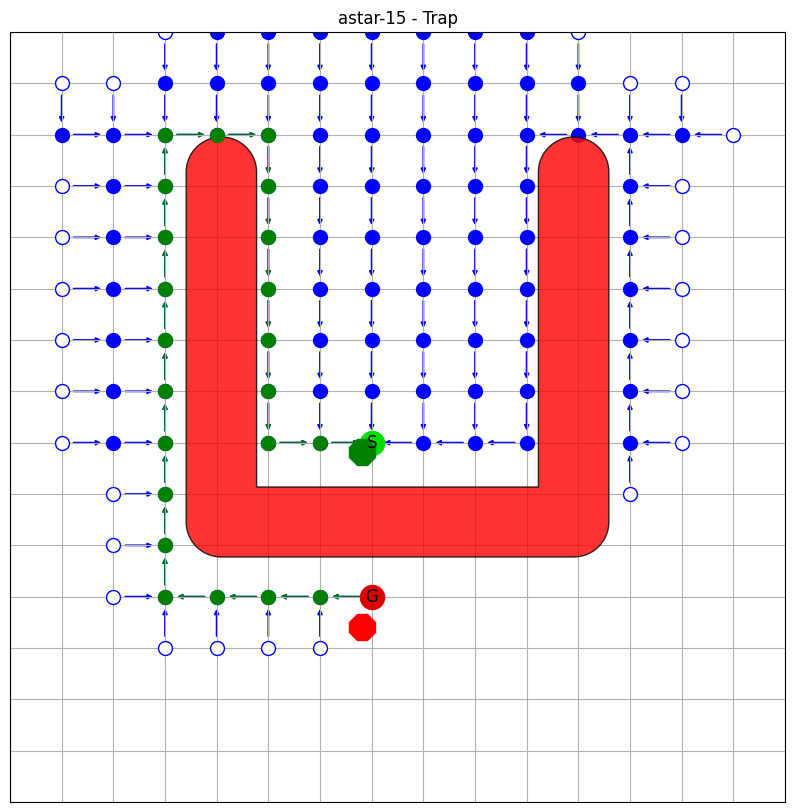

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.3999999999999995, 14.666666666666666]
Goal: [17.599999999999998, 4.3999999999999995]


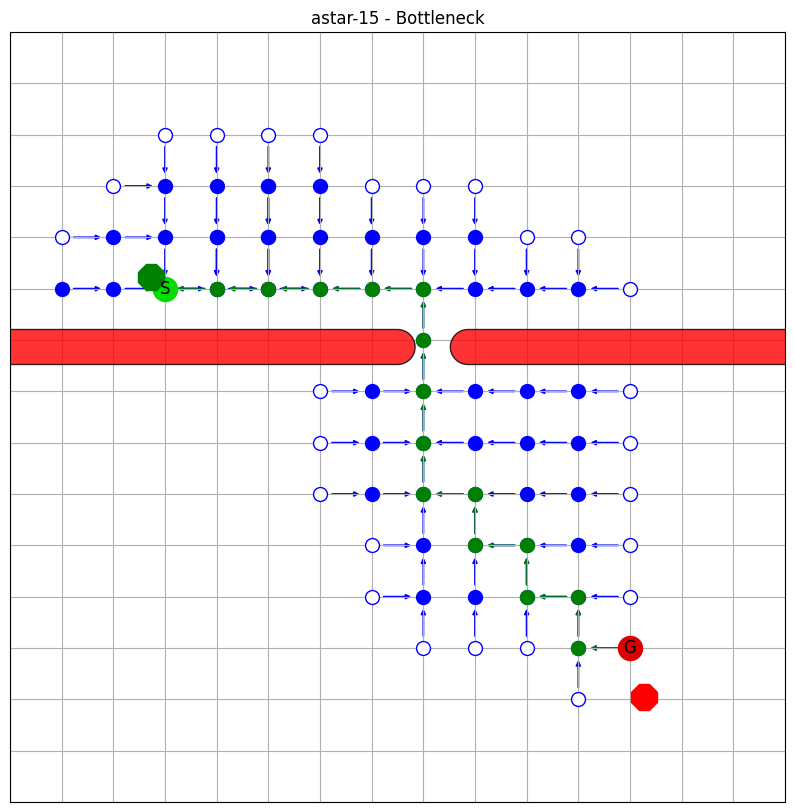

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.3999999999999995, 17.599999999999998]
Goal: [17.599999999999998, 4.3999999999999995]


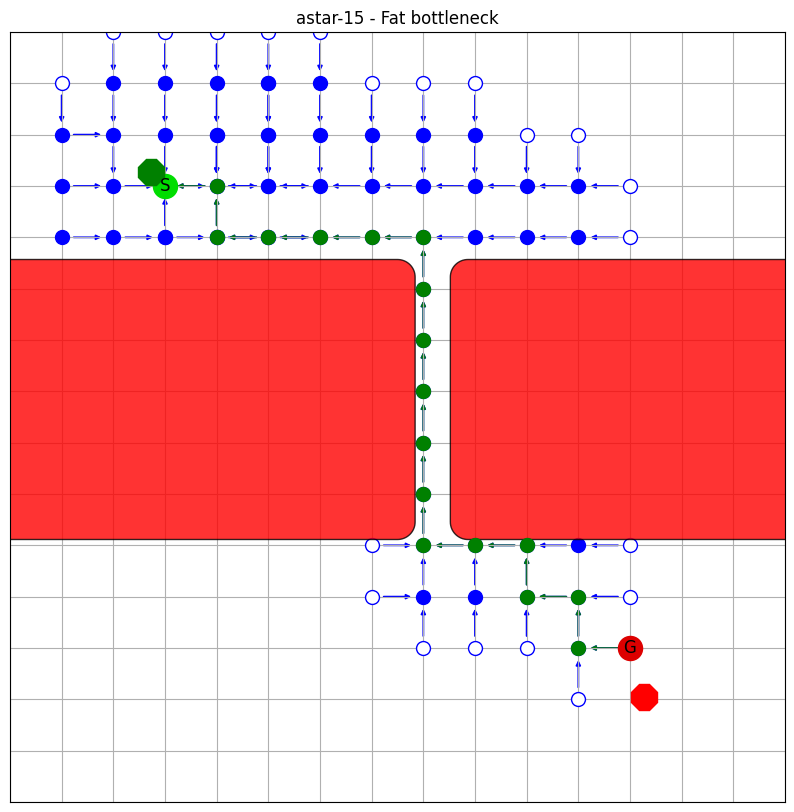

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [4.3999999999999995, 10.266666666666666]
Goal: [17.599999999999998, 4.3999999999999995]


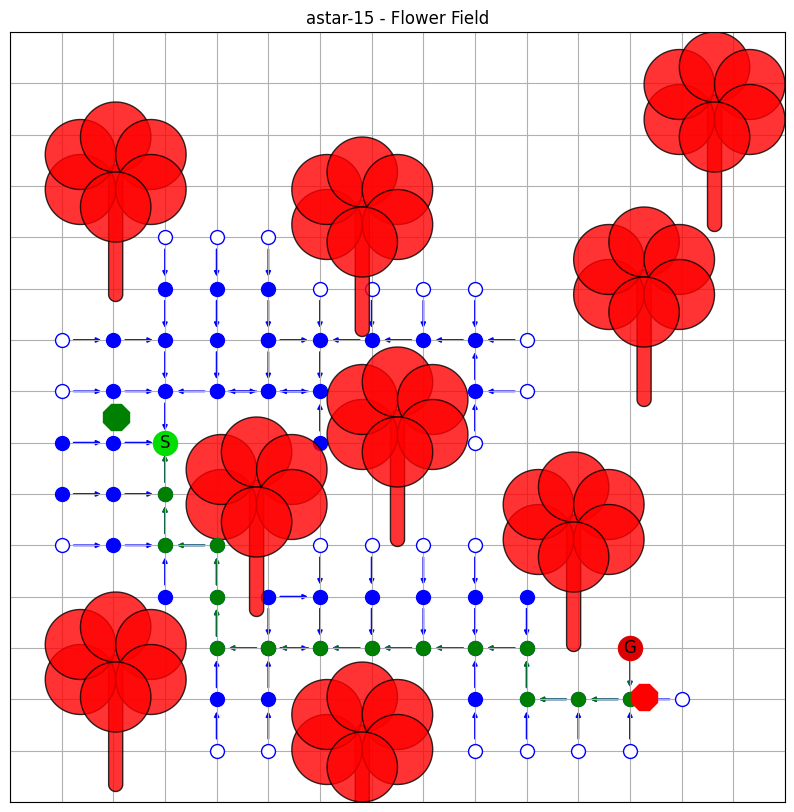

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]


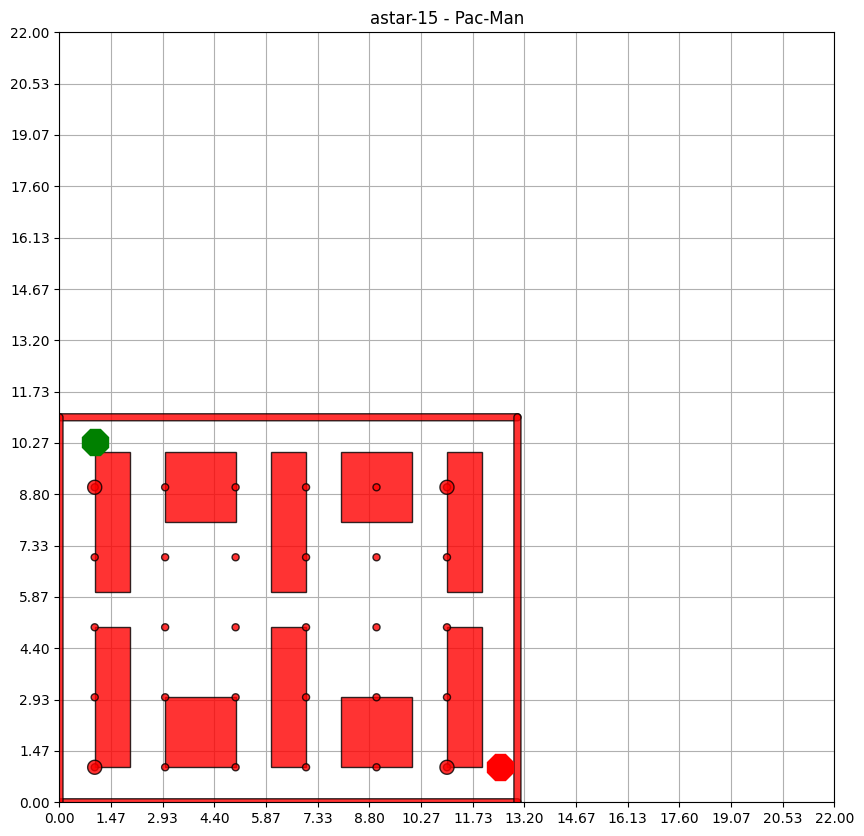

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.866666666666666, 5.866666666666666]
Goal: [19.066666666666666, 19.066666666666666]


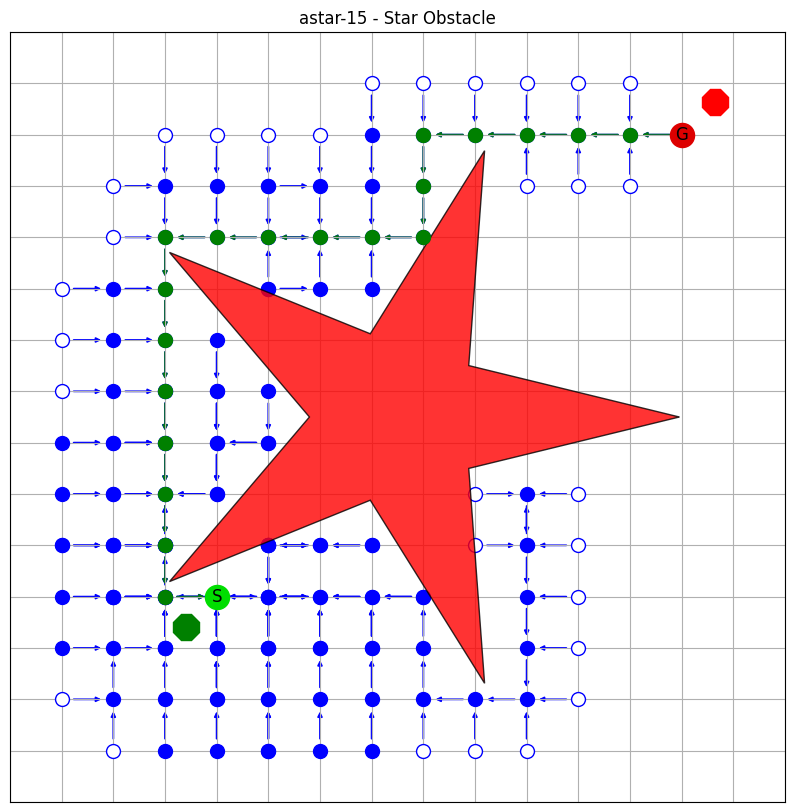

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.3999999999999995, 4.3999999999999995]
Goal: [19.066666666666666, 19.066666666666666]


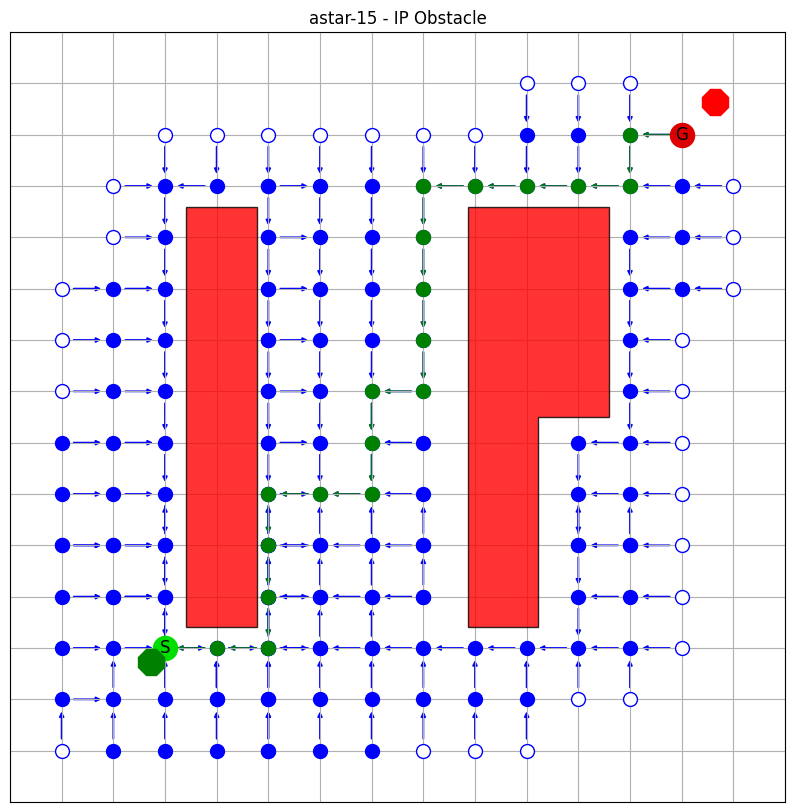

Initial start: [11, 2]
Initial goal: [11, 20]


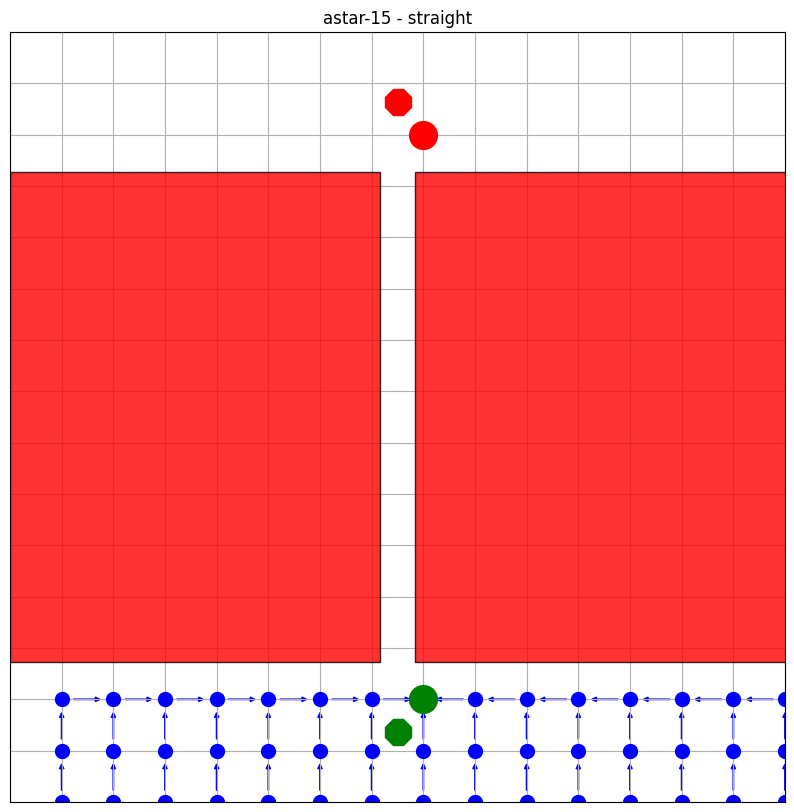

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [1.4666666666666666, 1.4666666666666666]
Goal: [19.066666666666666, 19.066666666666666]


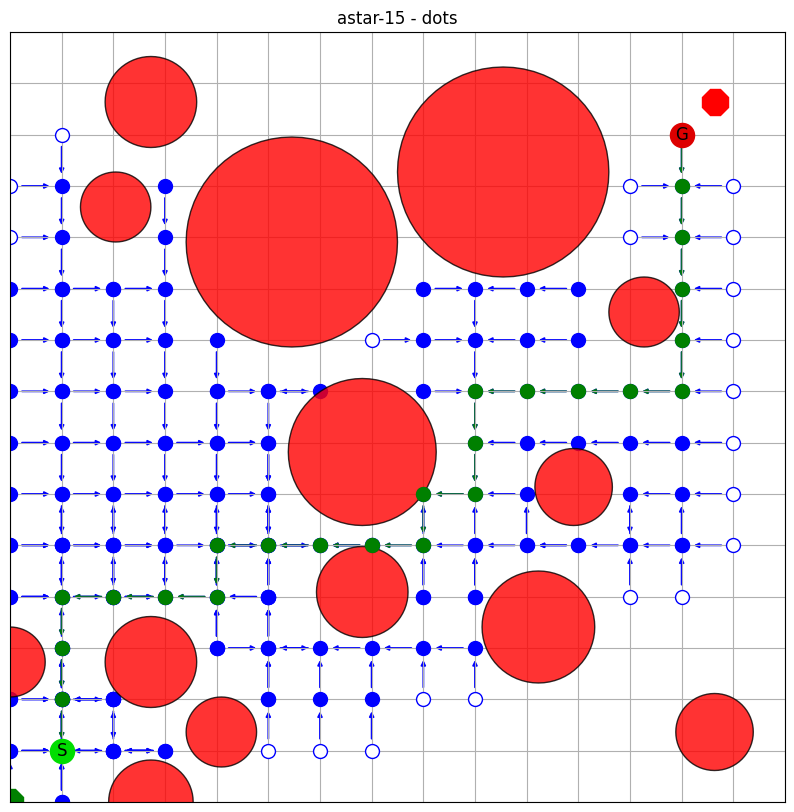

Initial start: [1.0, 5]
Initial goal: [21, 5.0]


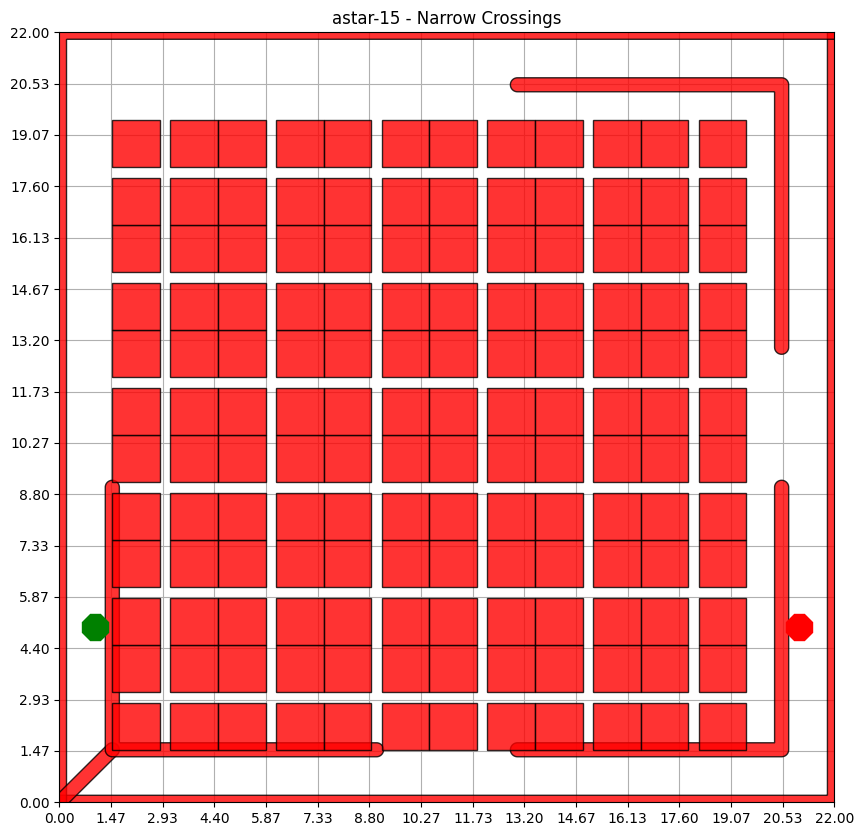

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.266666666666666, 1.4666666666666666]
Goal: [17.599999999999998, 17.599999999999998]


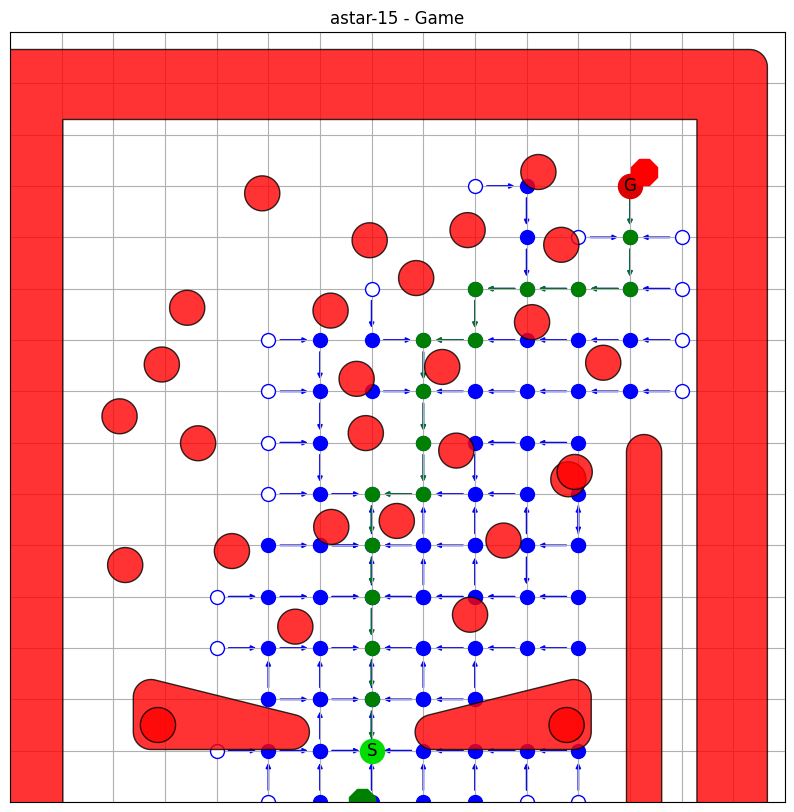

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [9.68, 9.68]
Goal: [9.68, 5.28]


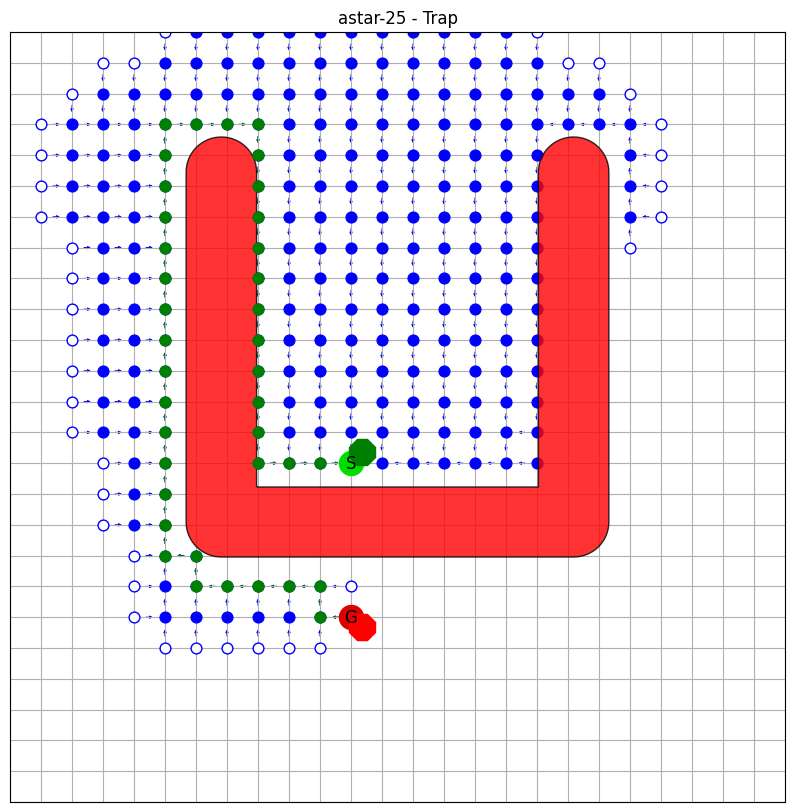

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.4, 14.96]
Goal: [17.6, 3.52]


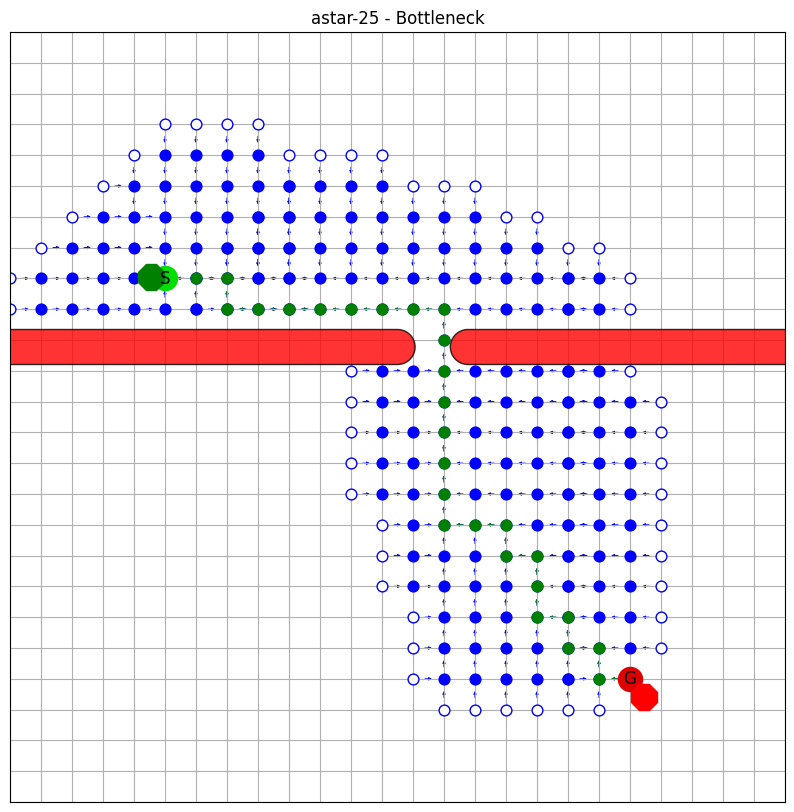

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.4, 17.6]
Goal: [17.6, 3.52]


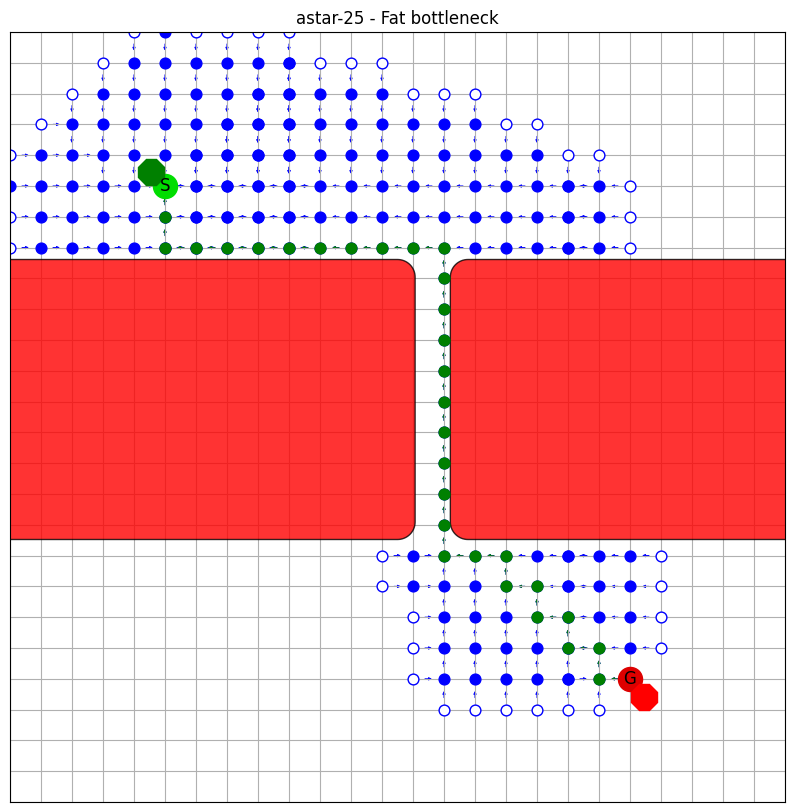

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.52, 10.56]
Goal: [17.6, 3.52]


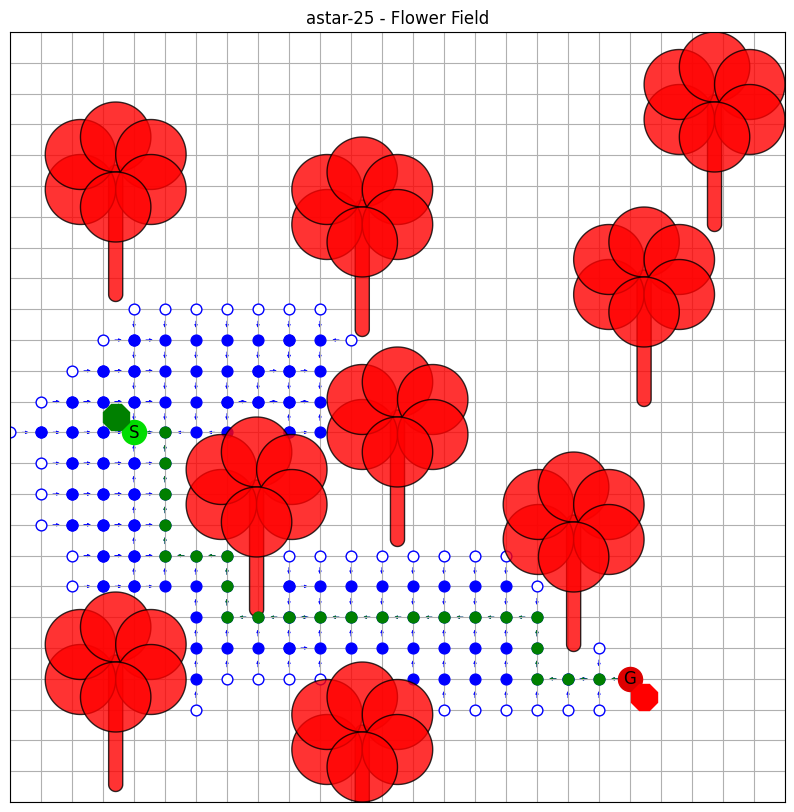

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.76, 10.56]
Goal: [12.32, 1.76]


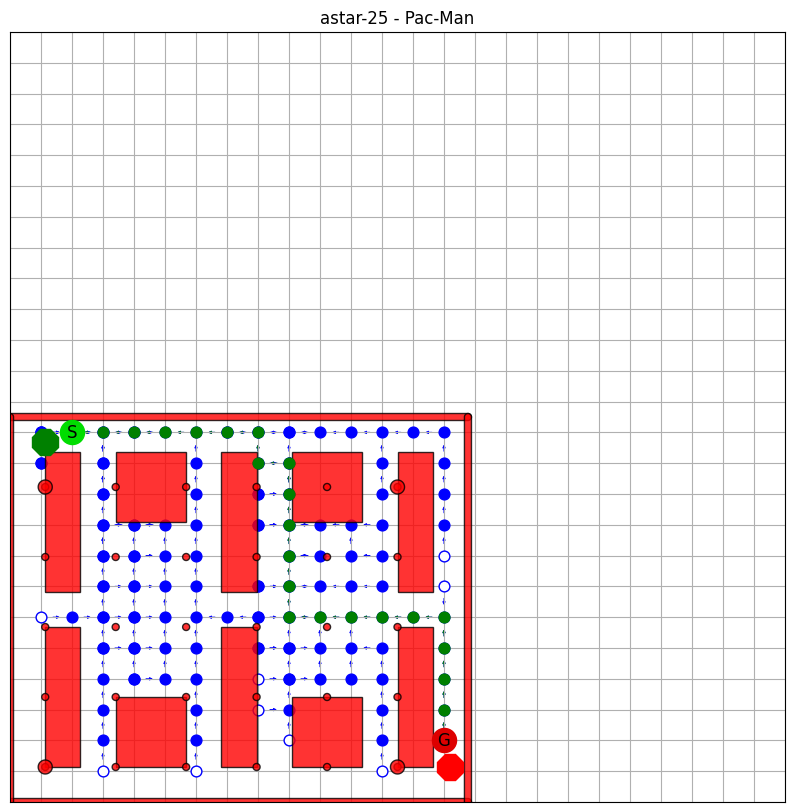

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.28, 5.28]
Goal: [19.36, 19.36]


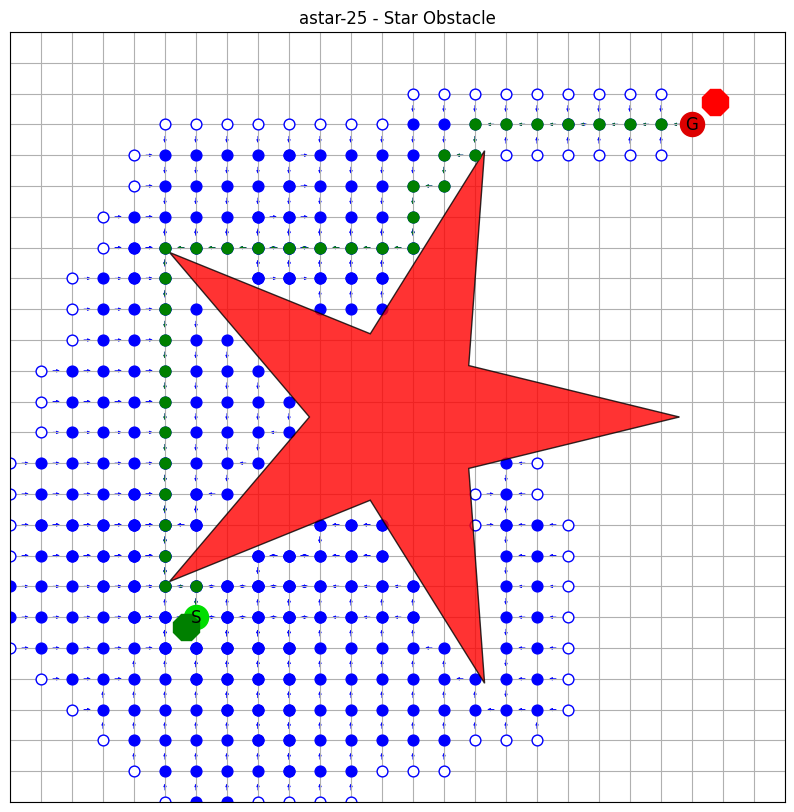

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.4, 4.4]
Goal: [19.36, 19.36]


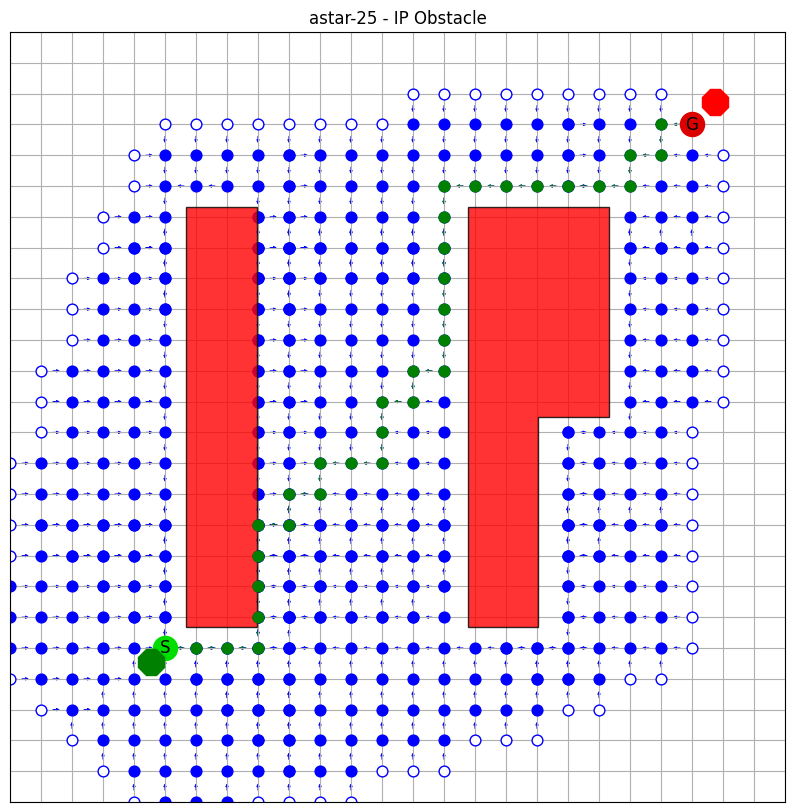

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [10.56, 2.64]
Goal: [10.56, 19.36]


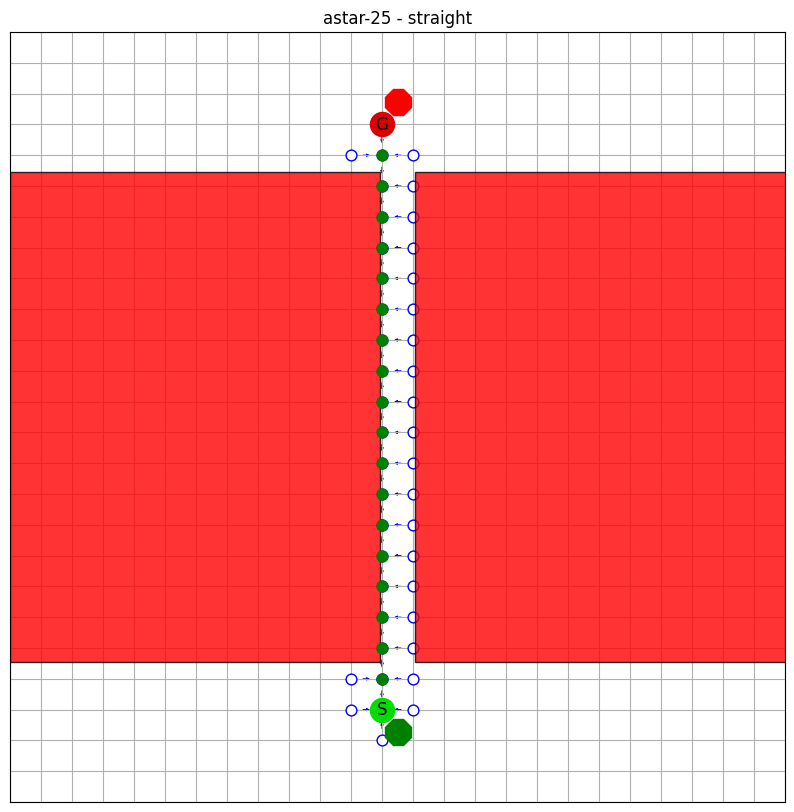

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.88, 0.88]
Goal: [19.36, 19.36]


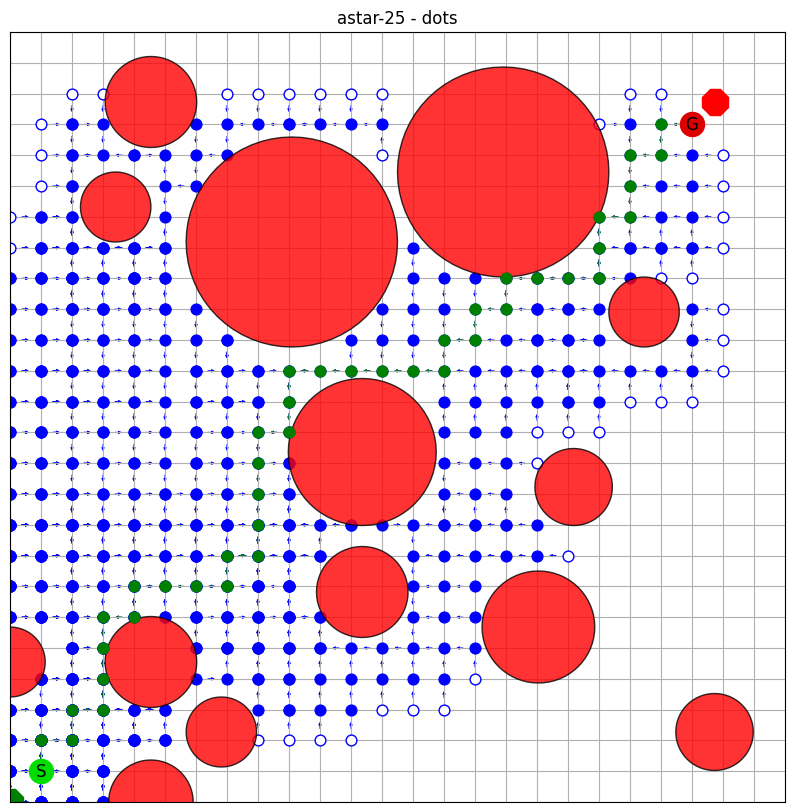

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [0.88, 5.28]
Goal: [21.12, 5.28]


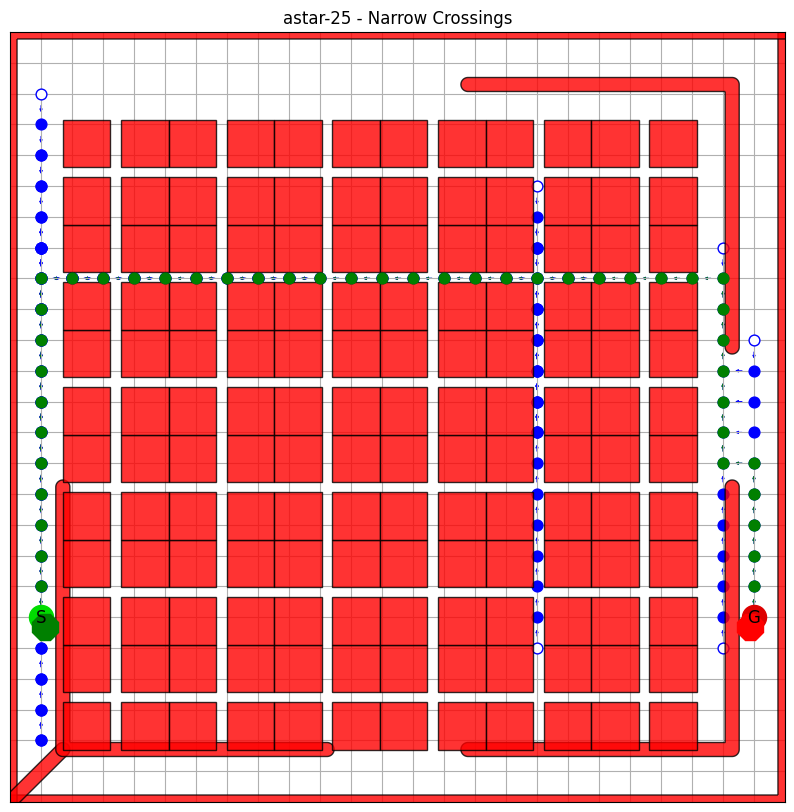

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.56, 0.88]
Goal: [17.6, 17.6]


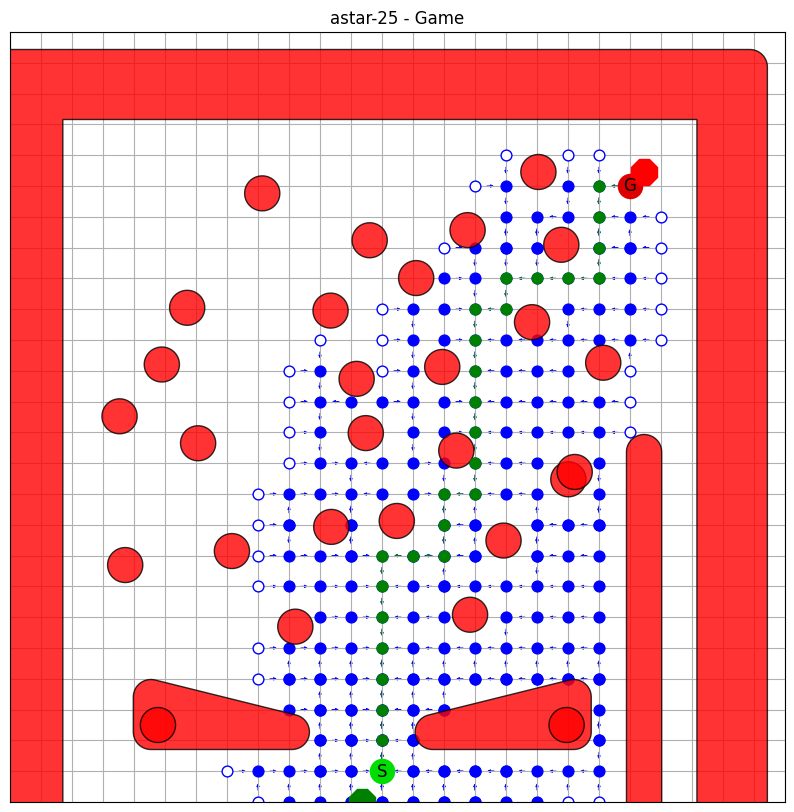

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.266666666666666, 9.533333333333333]
Goal: [10.266666666666666, 5.133333333333333]


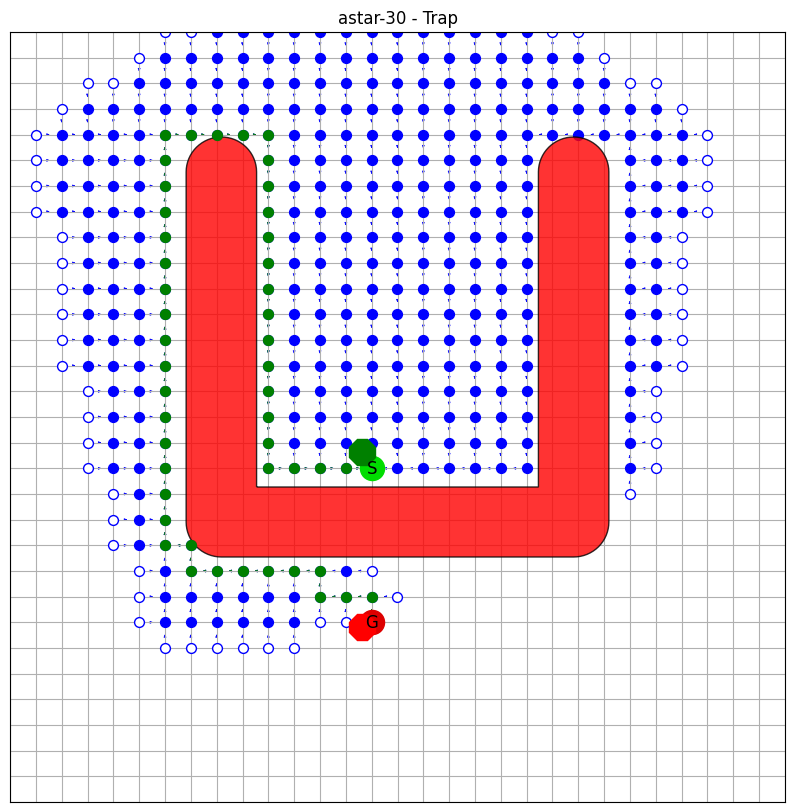

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.3999999999999995, 14.666666666666666]
Goal: [17.599999999999998, 3.6666666666666665]


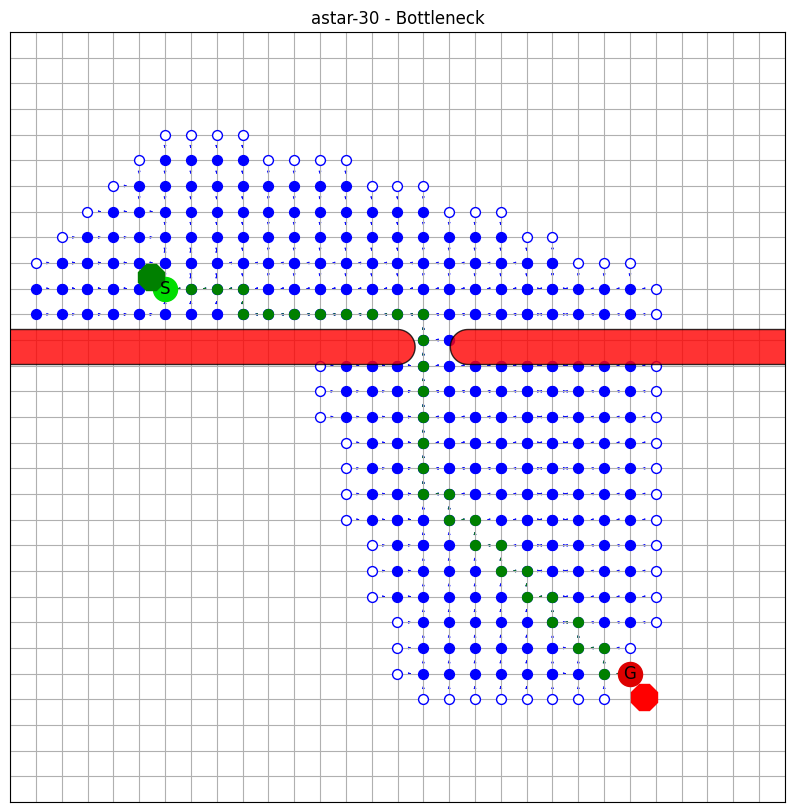

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.3999999999999995, 17.599999999999998]
Goal: [17.599999999999998, 3.6666666666666665]


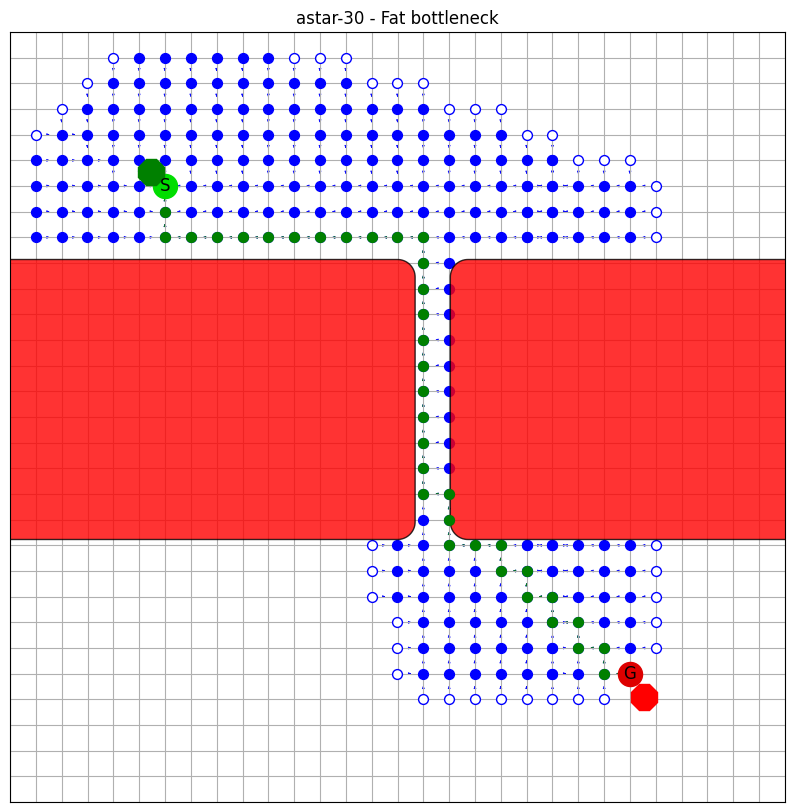

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.6666666666666665, 11.0]
Goal: [17.599999999999998, 3.6666666666666665]


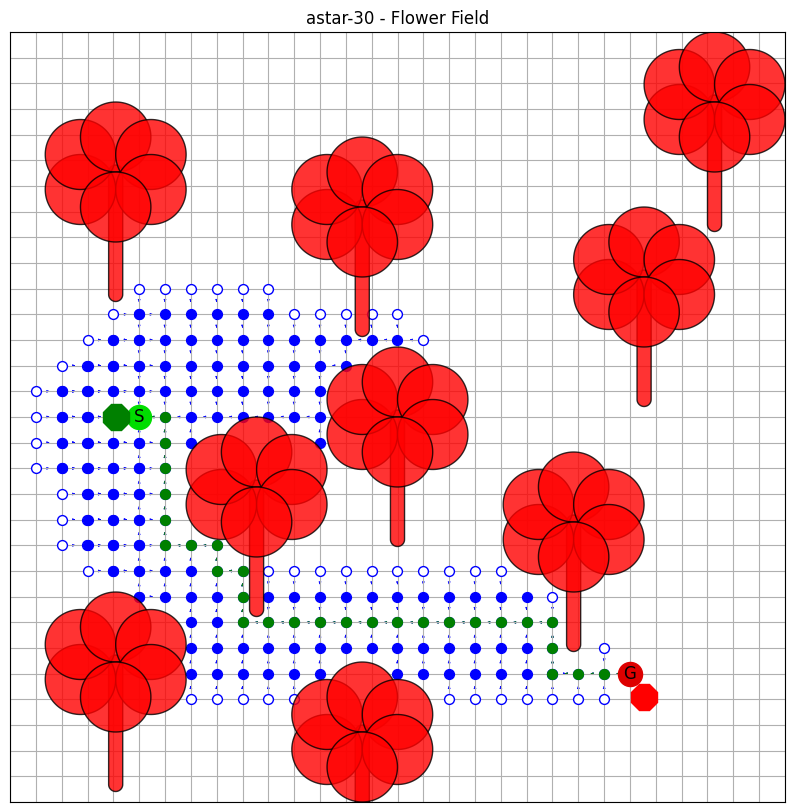

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.4666666666666666, 10.266666666666666]
Goal: [12.466666666666665, 1.4666666666666666]


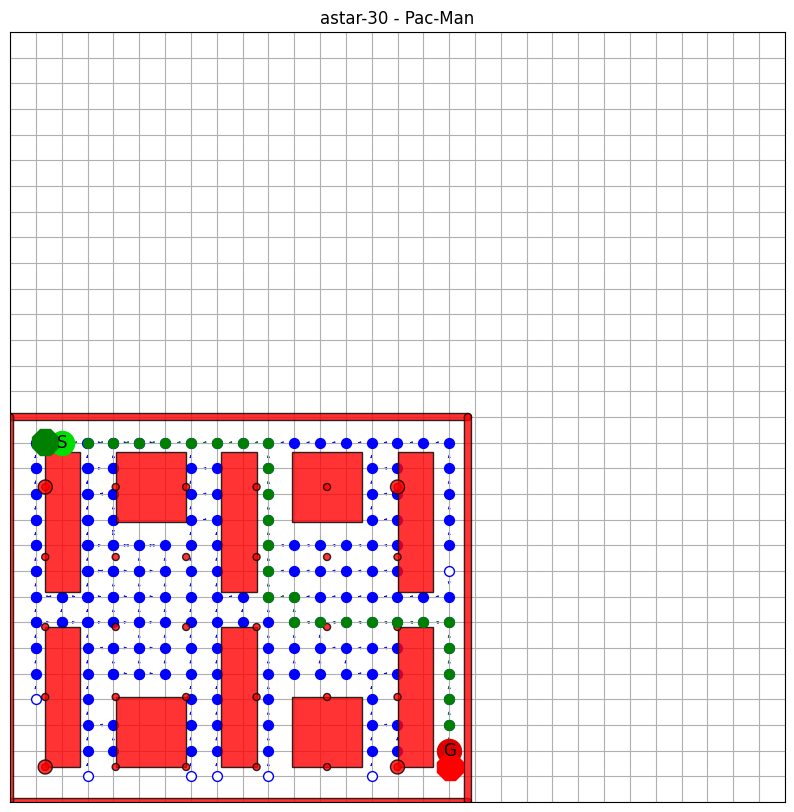

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.133333333333333, 5.133333333333333]
Goal: [19.799999999999997, 19.799999999999997]


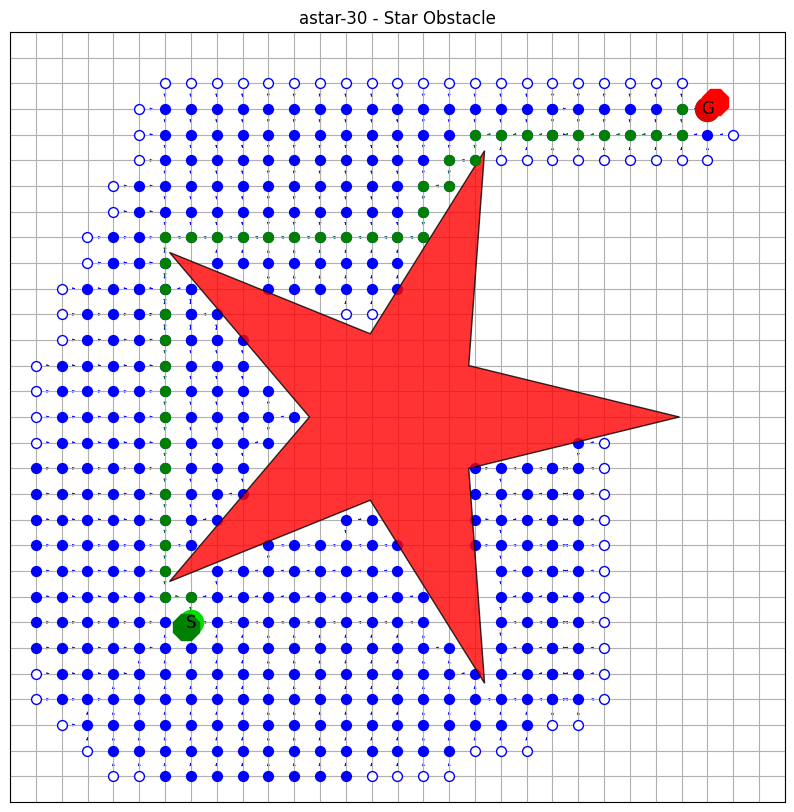

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.3999999999999995, 4.3999999999999995]
Goal: [19.799999999999997, 19.799999999999997]


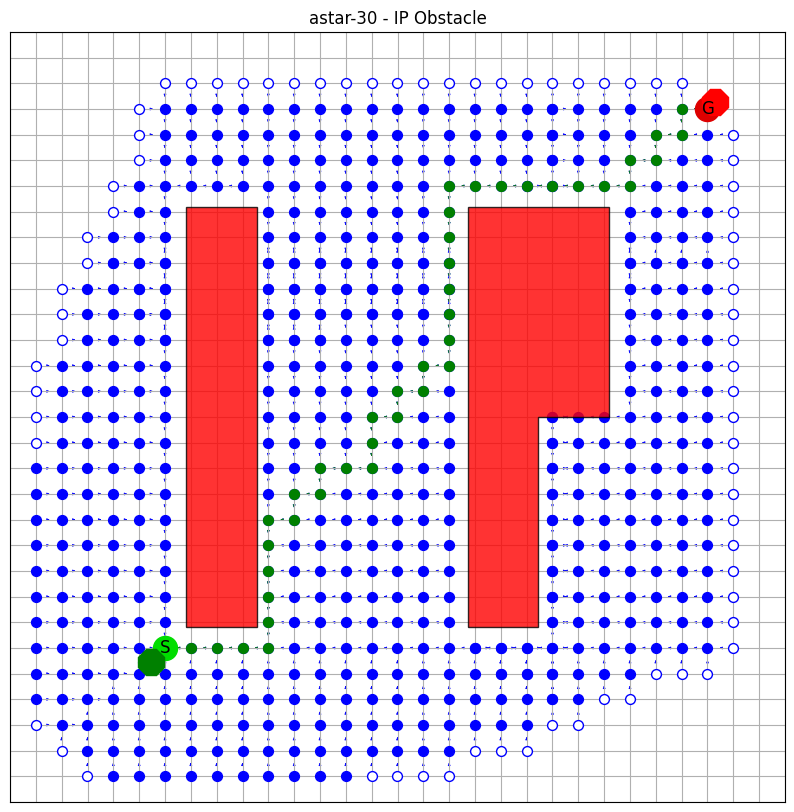

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.1999999999999997]
Goal: [11.0, 19.799999999999997]


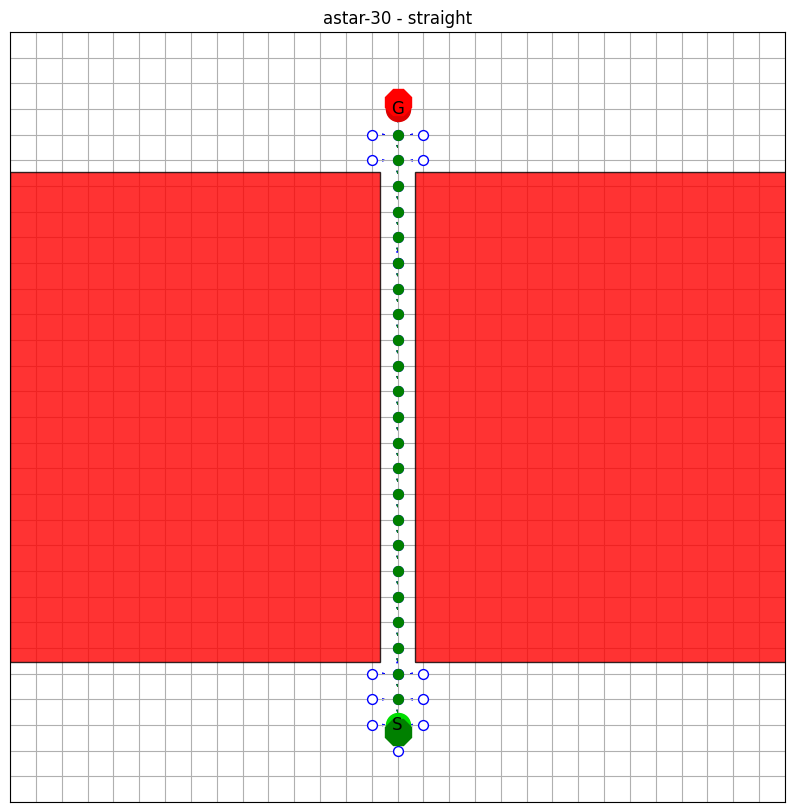

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.7333333333333333, 0.7333333333333333]
Goal: [19.799999999999997, 19.799999999999997]


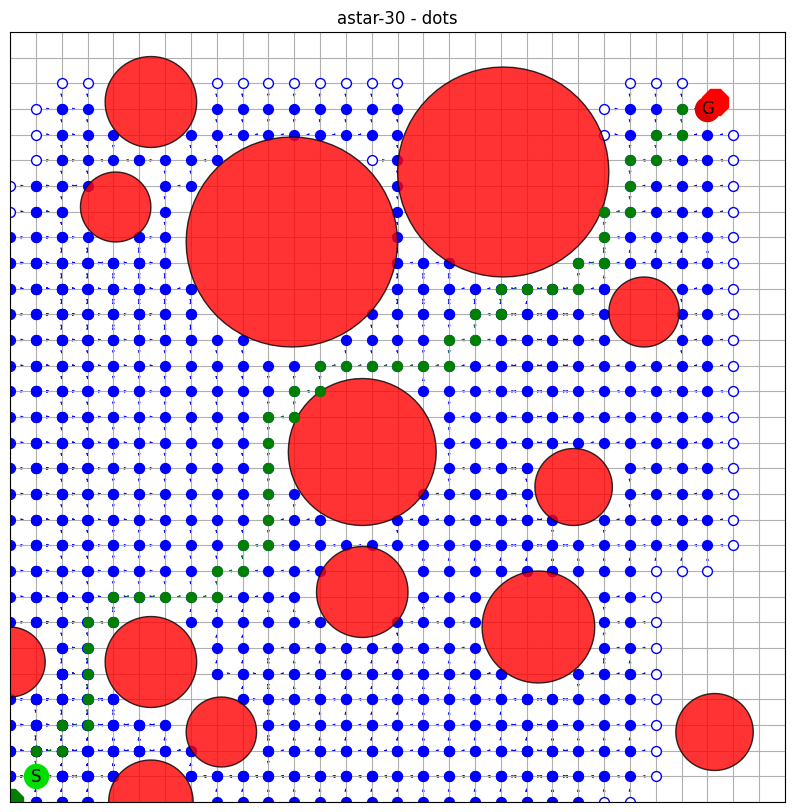

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [0.7333333333333333, 5.133333333333333]
Goal: [21.266666666666666, 5.133333333333333]


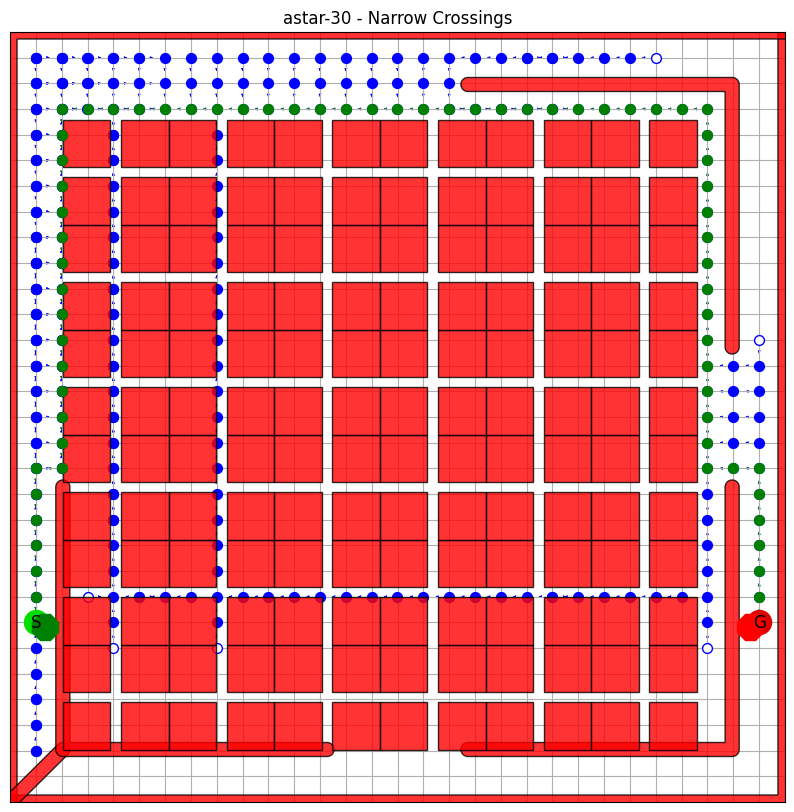

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.266666666666666, 0.7333333333333333]
Goal: [17.599999999999998, 17.599999999999998]


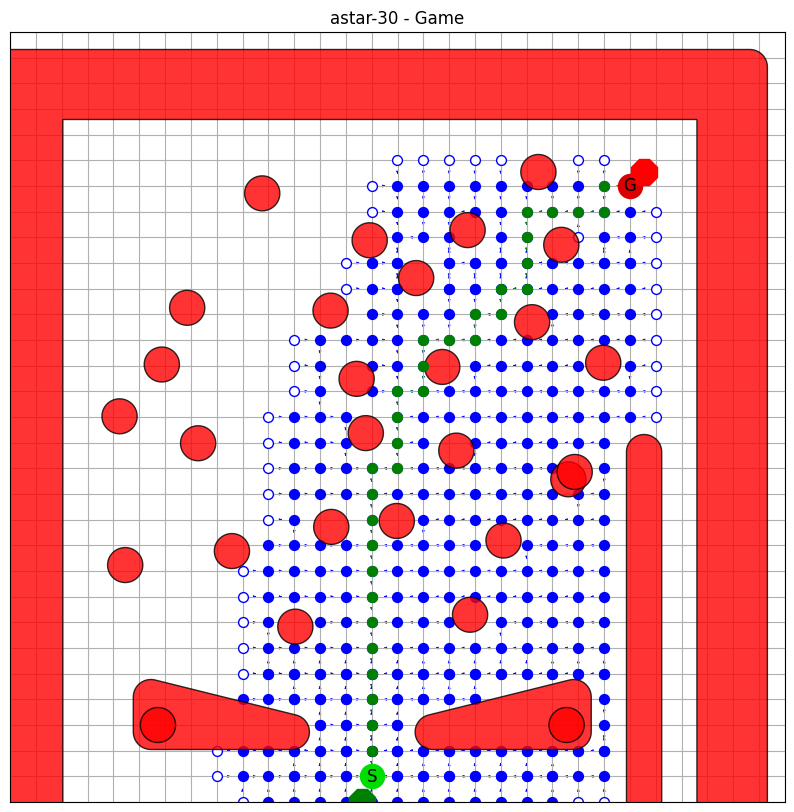

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.12, 9.68]
Goal: [10.12, 5.28]


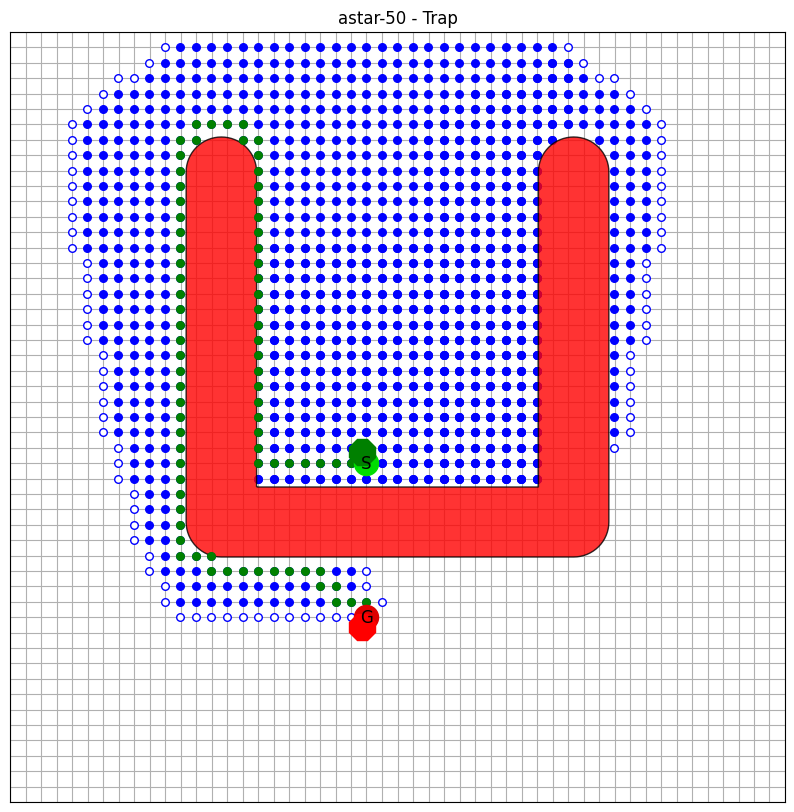

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.4, 14.96]
Goal: [17.6, 3.08]


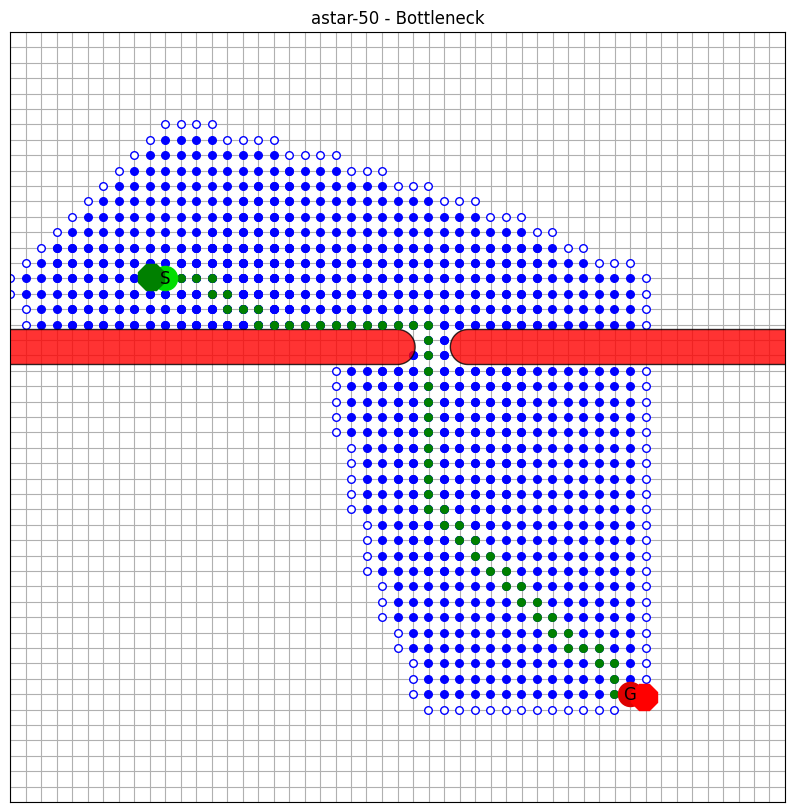

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.4, 17.6]
Goal: [17.6, 3.08]


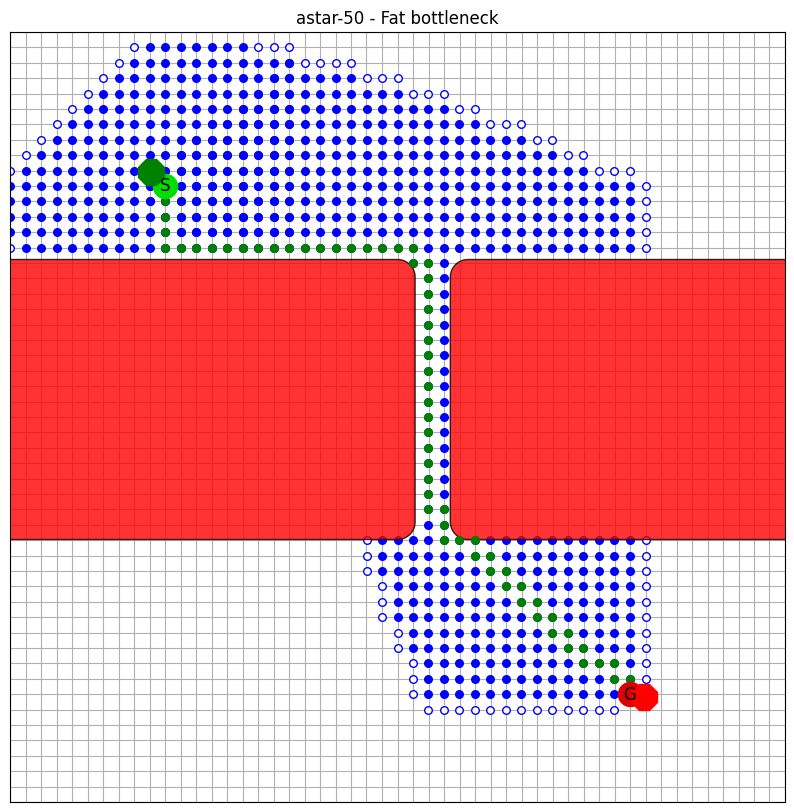

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.08, 11.0]
Goal: [17.6, 3.08]


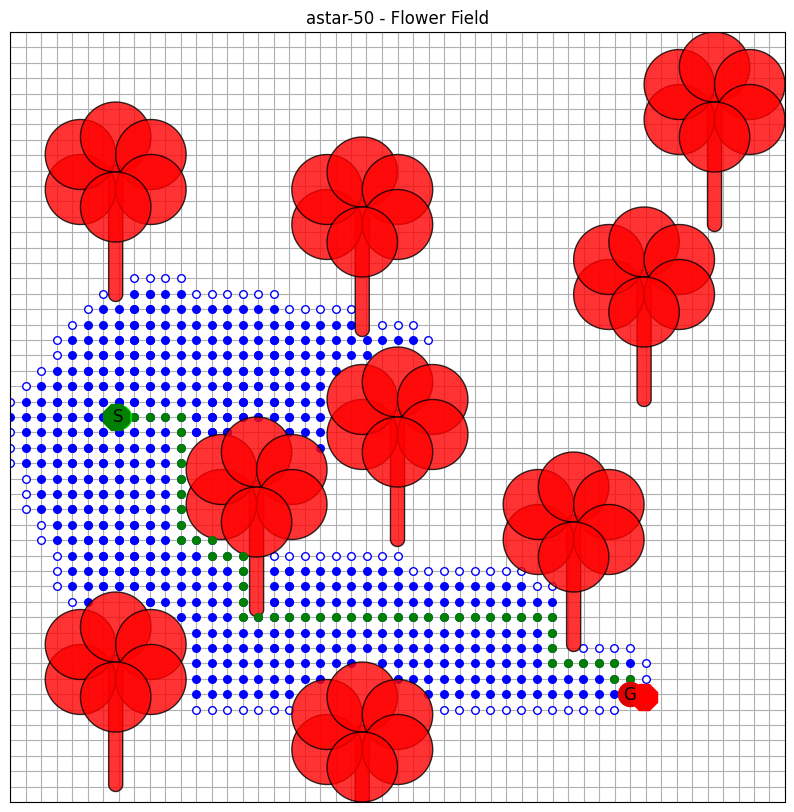

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.32, 10.12]
Goal: [12.32, 1.32]


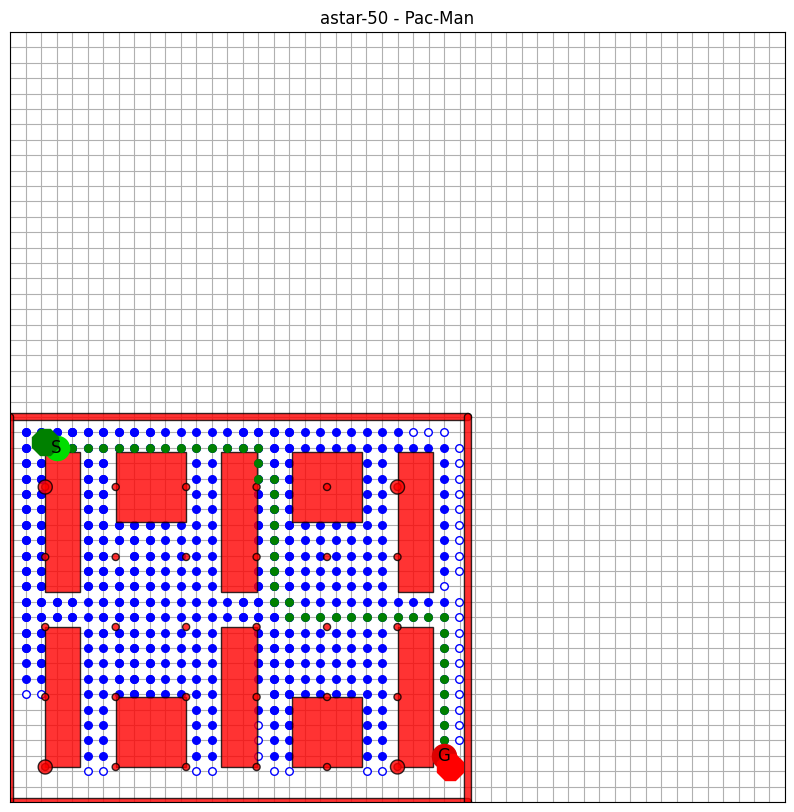

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.28, 5.28]
Goal: [19.8, 19.8]


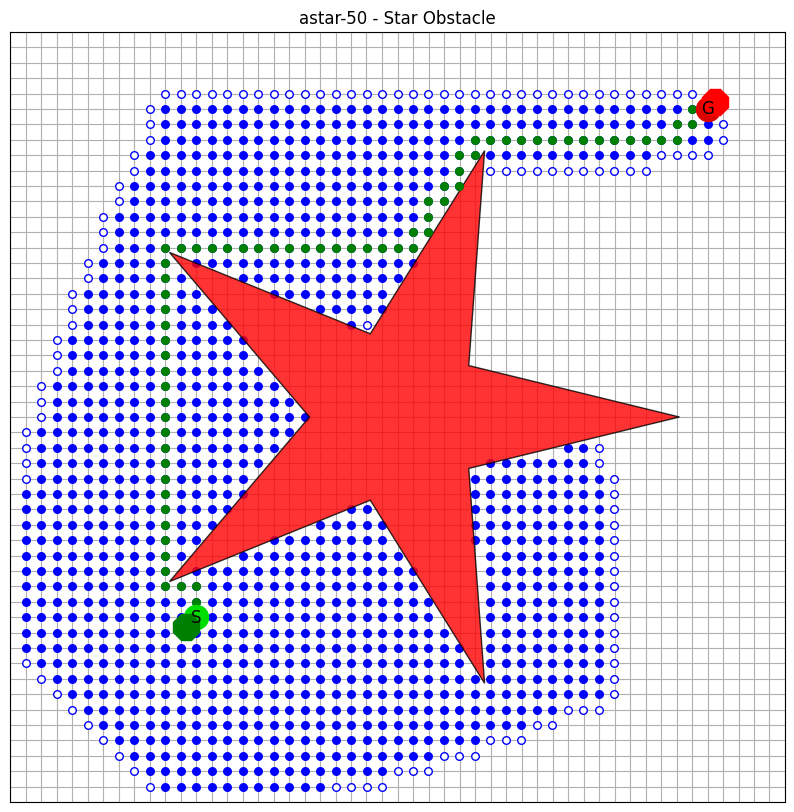

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.4, 4.4]
Goal: [19.8, 19.8]


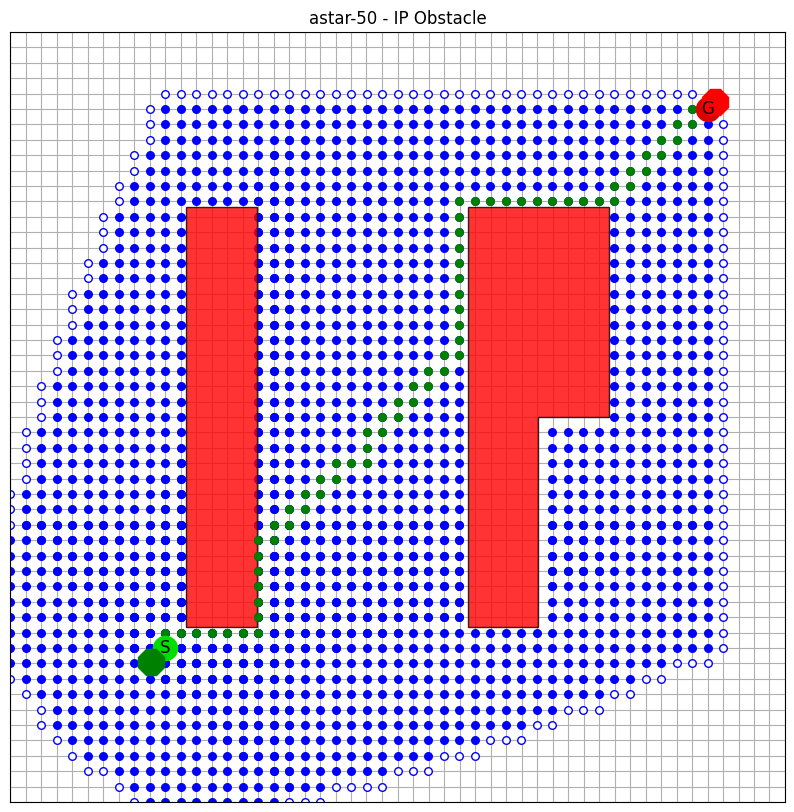

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.2]
Goal: [11.0, 19.8]


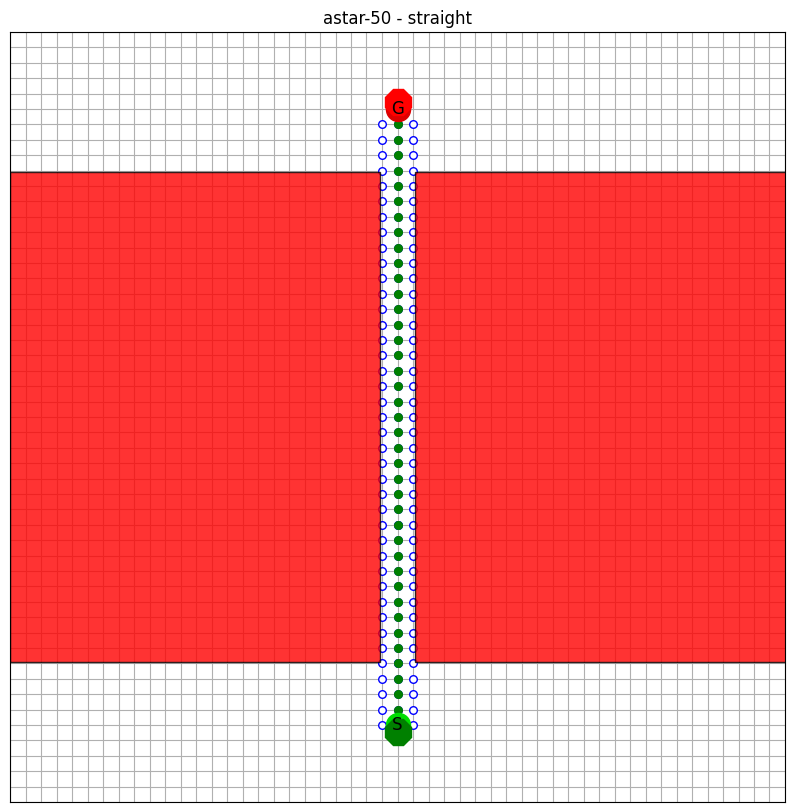

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.44, 0.44]
Goal: [19.8, 19.8]


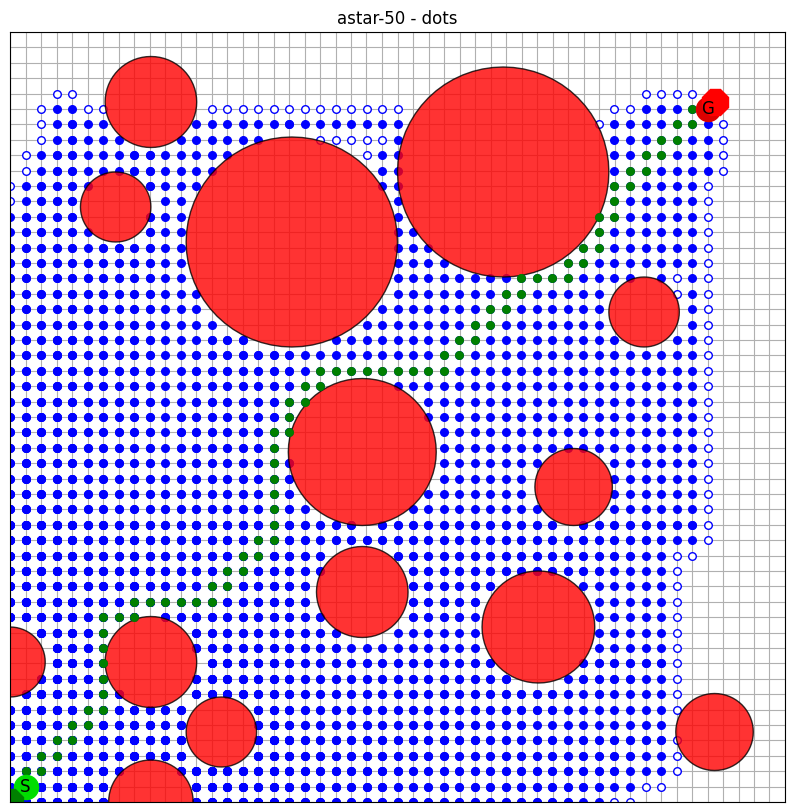

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [0.88, 4.84]
Goal: [21.12, 4.84]


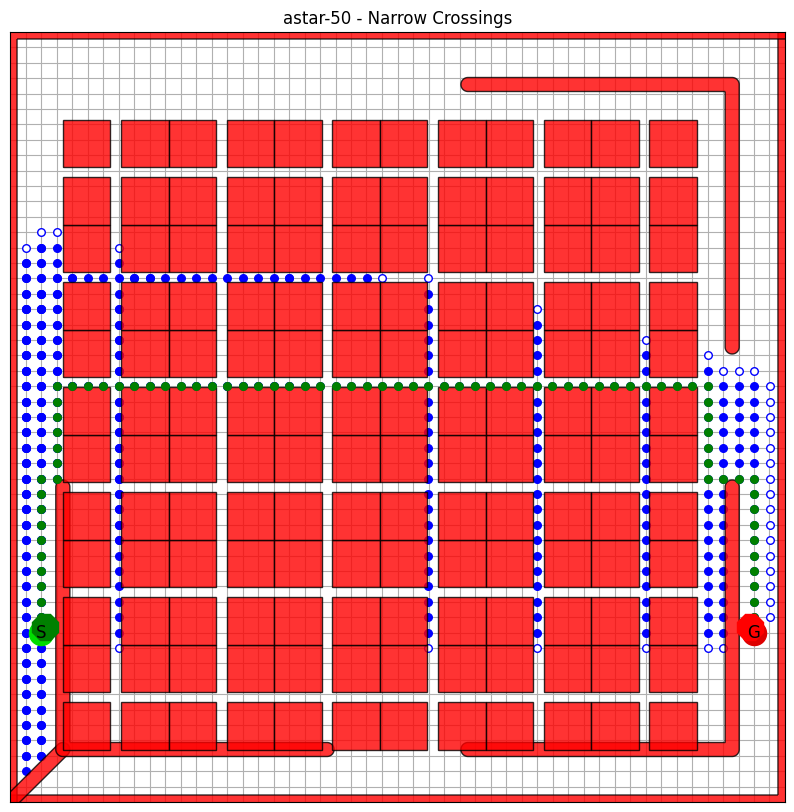

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.12, 0.44]
Goal: [17.6, 17.6]


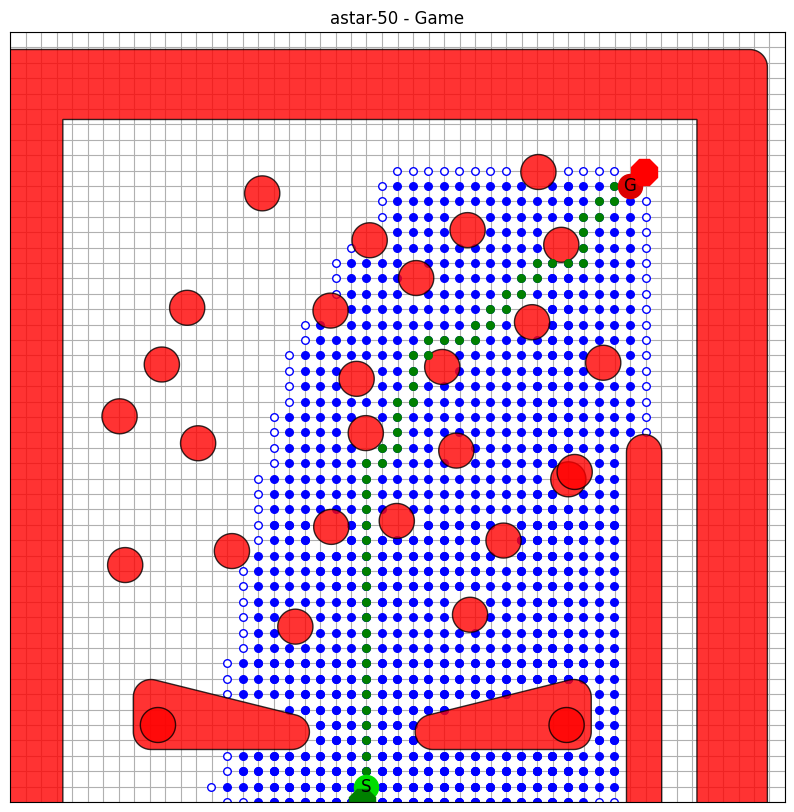

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [9.9, 9.9]
Goal: [9.9, 5.06]


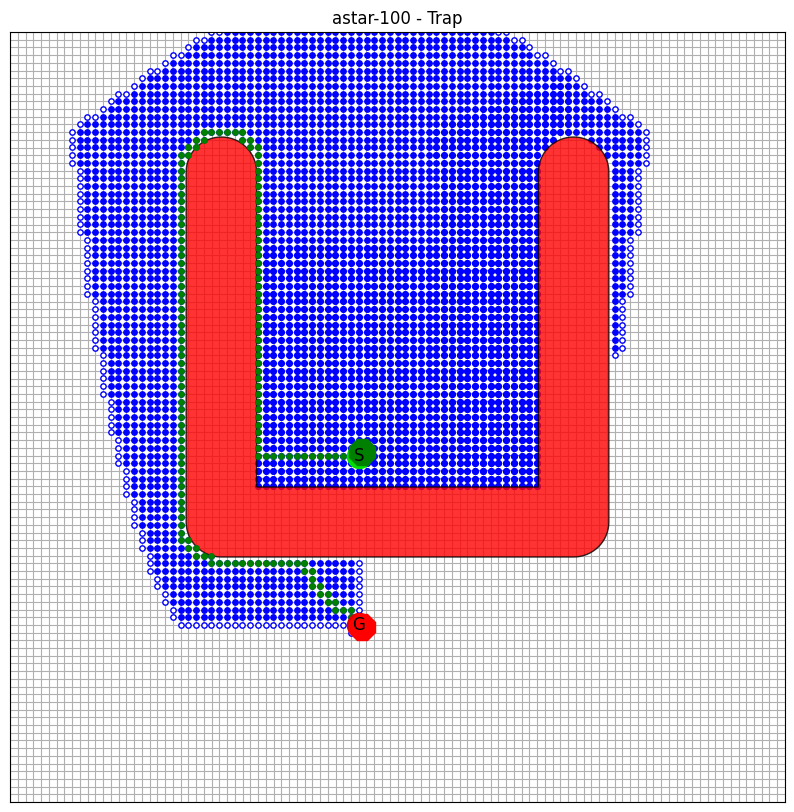

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.18, 14.96]
Goal: [17.82, 3.08]


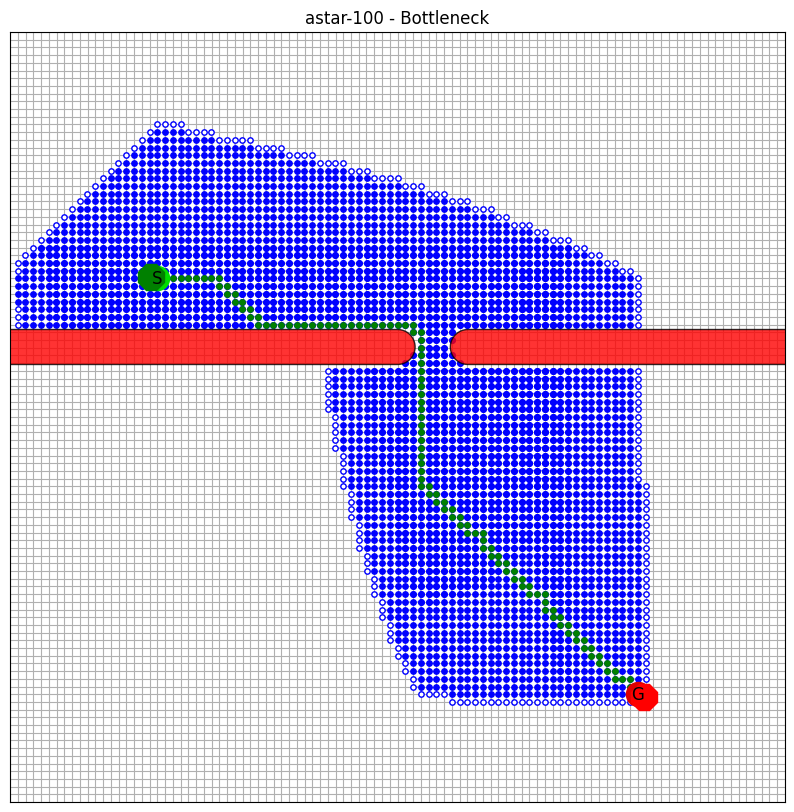

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.18, 17.82]
Goal: [17.82, 3.08]


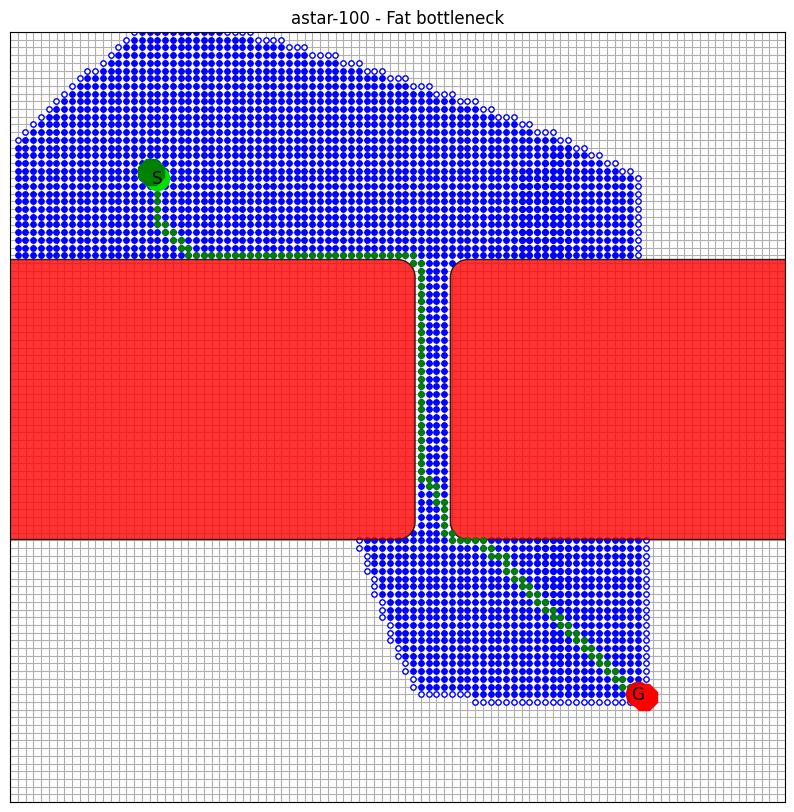

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.08, 11.0]
Goal: [17.82, 3.08]


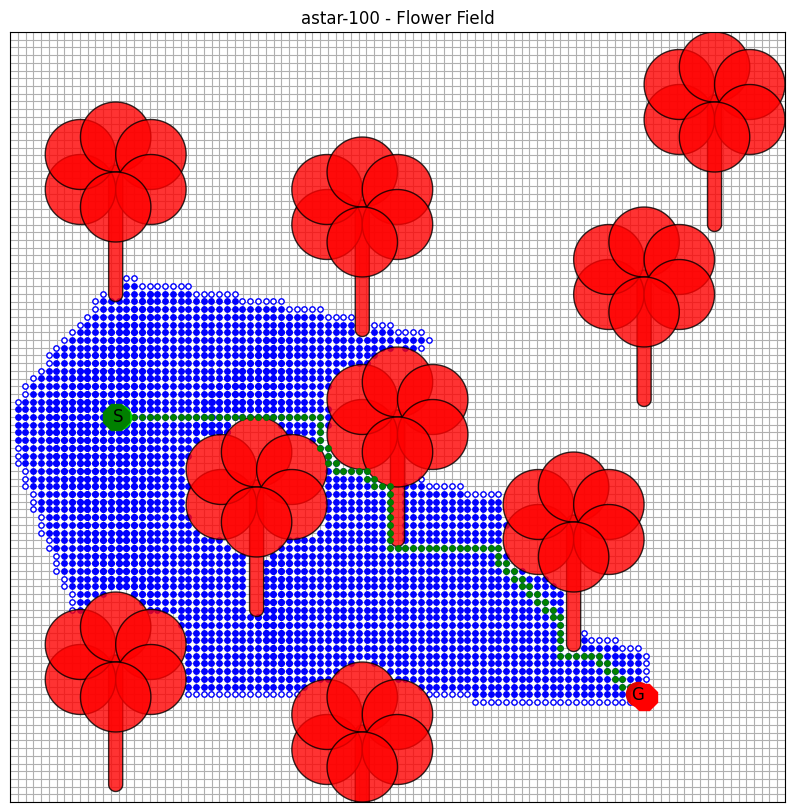

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.1, 10.12]
Goal: [12.32, 1.1]


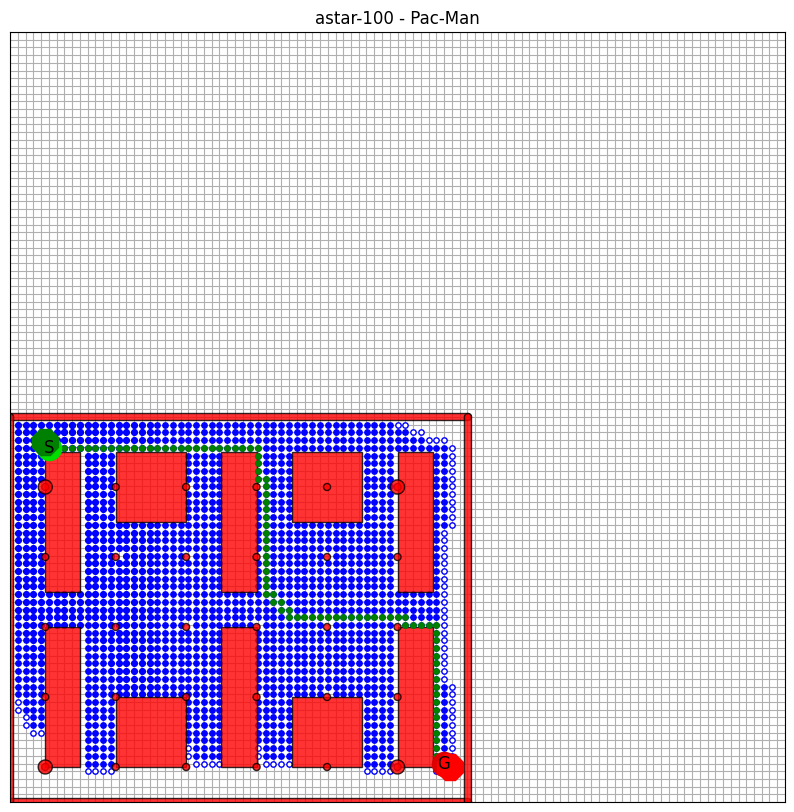

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.06, 5.06]
Goal: [19.8, 19.8]


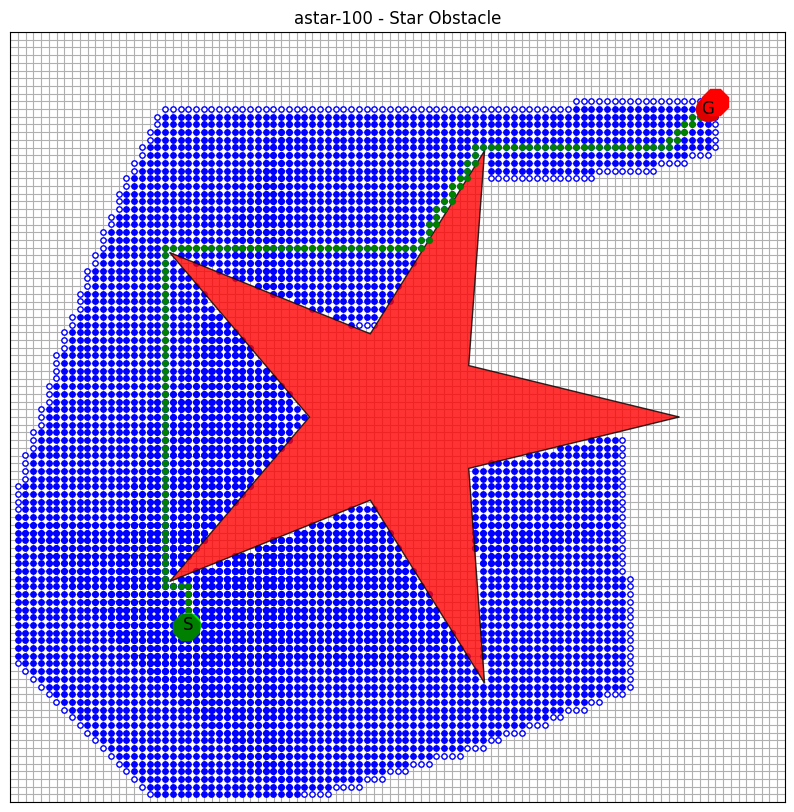

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.18, 4.18]
Goal: [19.8, 19.8]


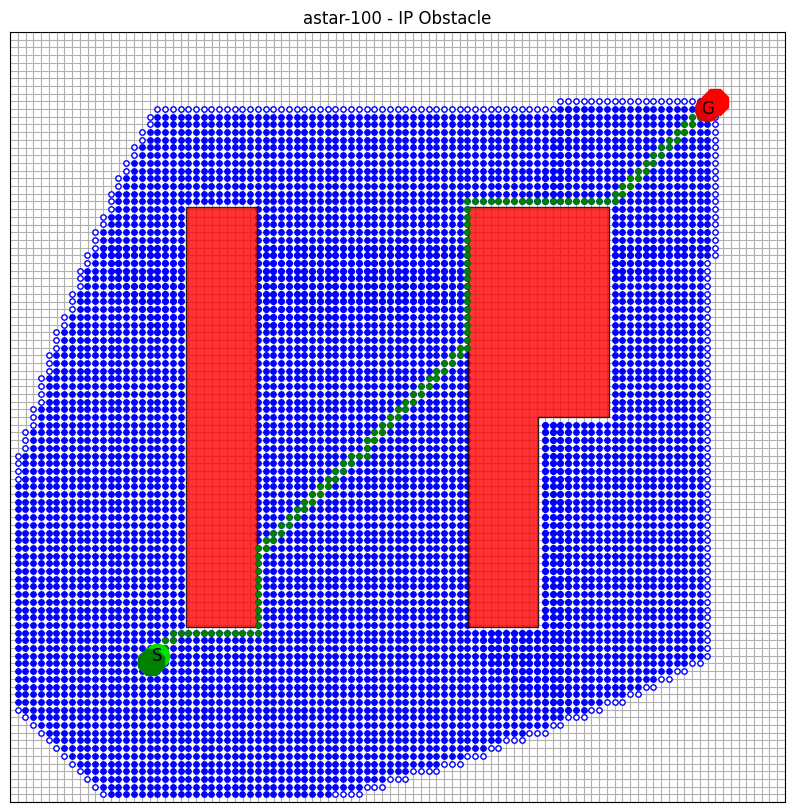

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.2]
Goal: [11.0, 19.8]


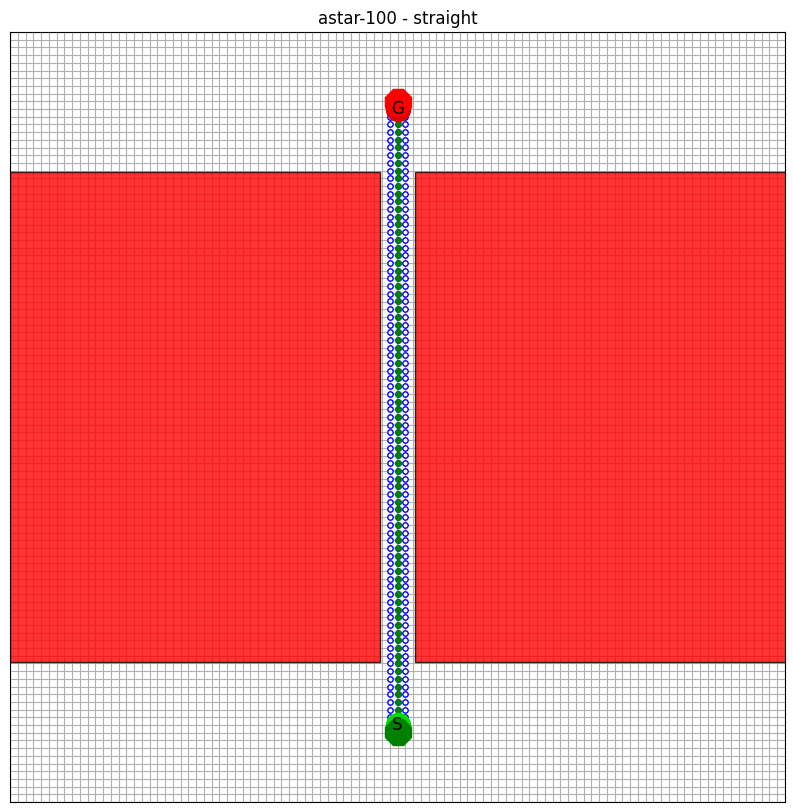

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.22, 0.22]
Goal: [19.8, 19.8]


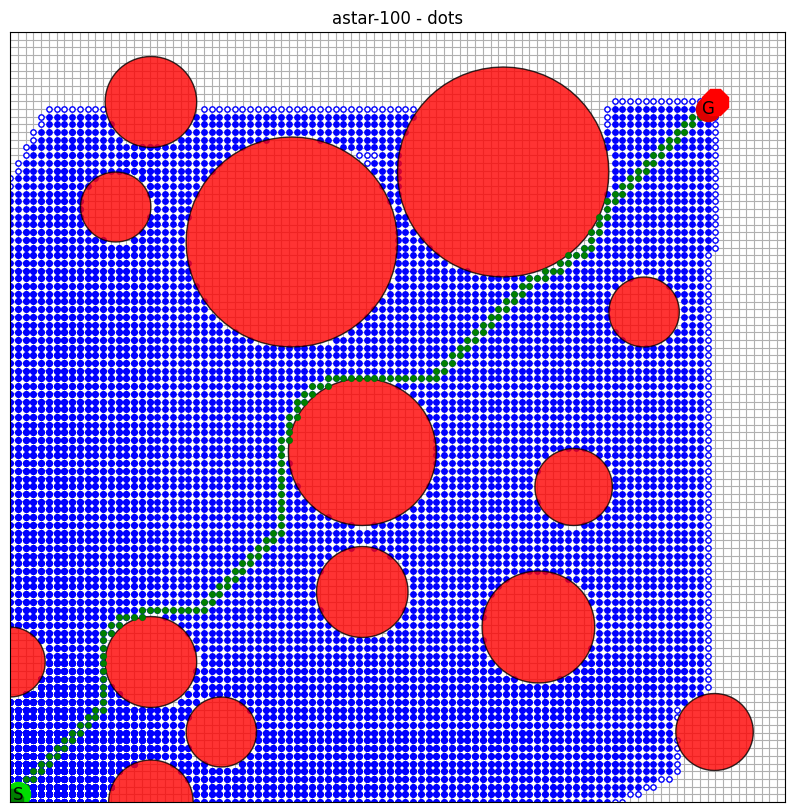

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [1.1, 5.06]
Goal: [20.9, 5.06]


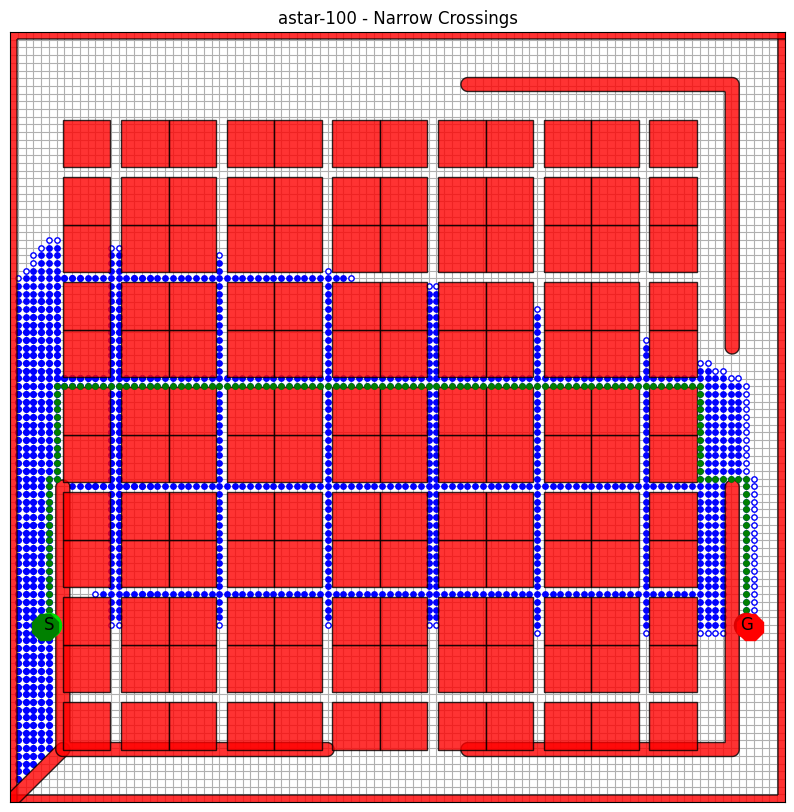

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.12, 0.22]
Goal: [17.82, 17.82]


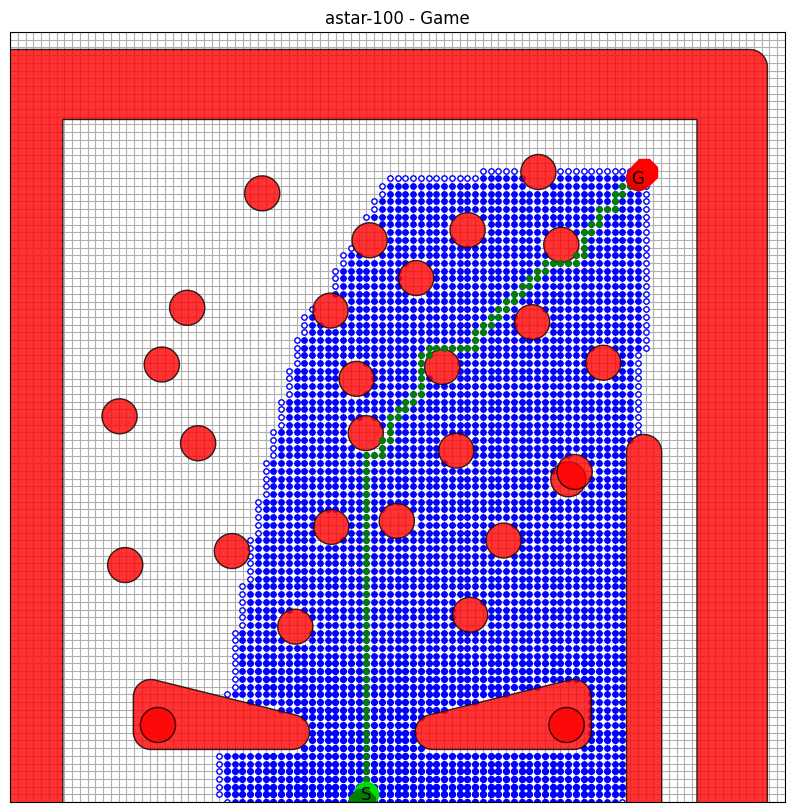

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.0, 10.0]
Goal: [10.0, 5.0]


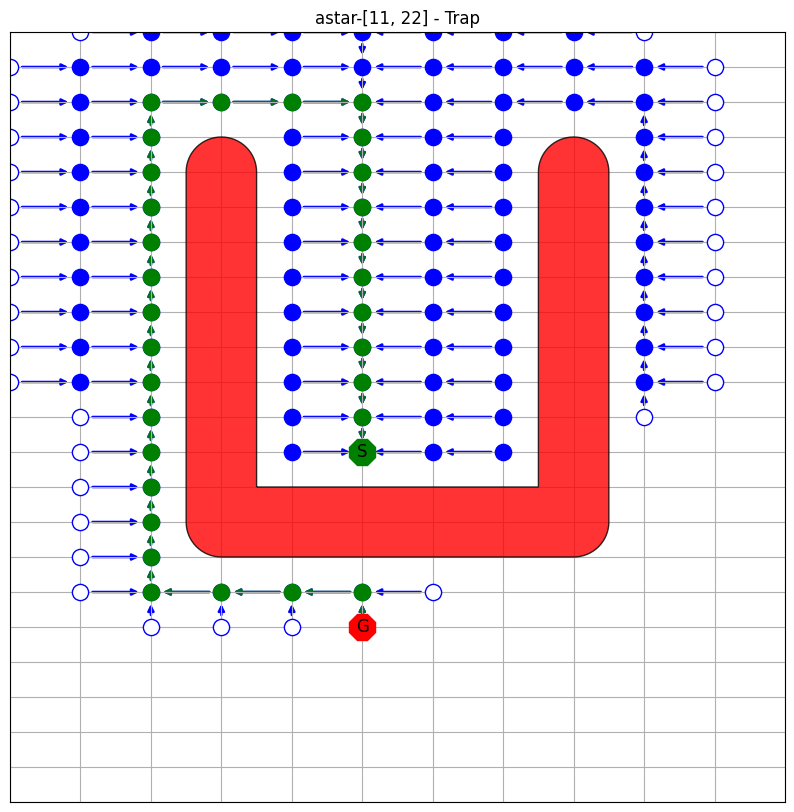

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.0, 15.0]
Goal: [16.0, 3.0]


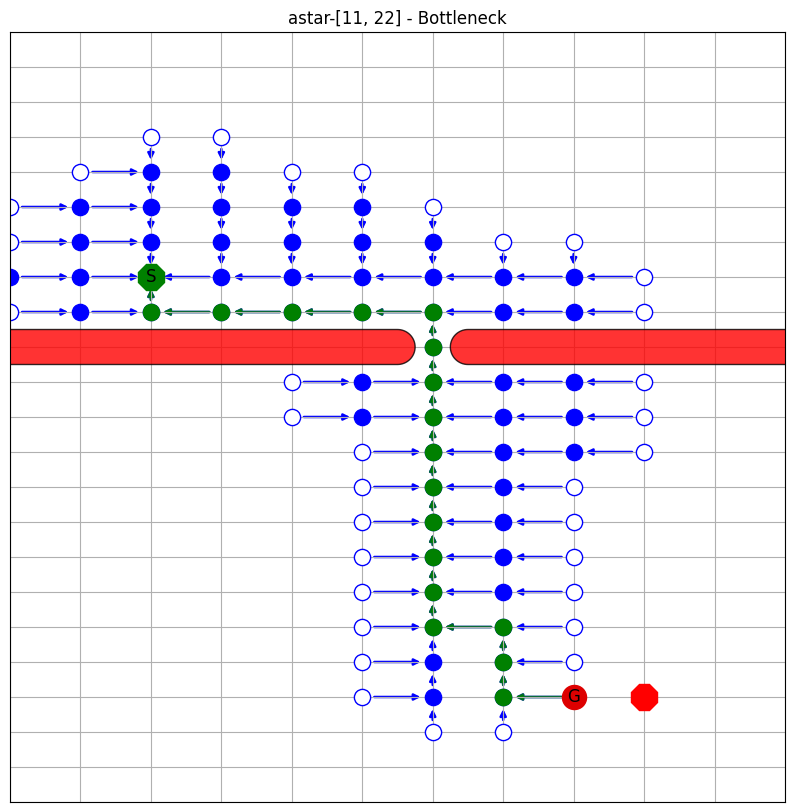

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.0, 18.0]
Goal: [16.0, 3.0]


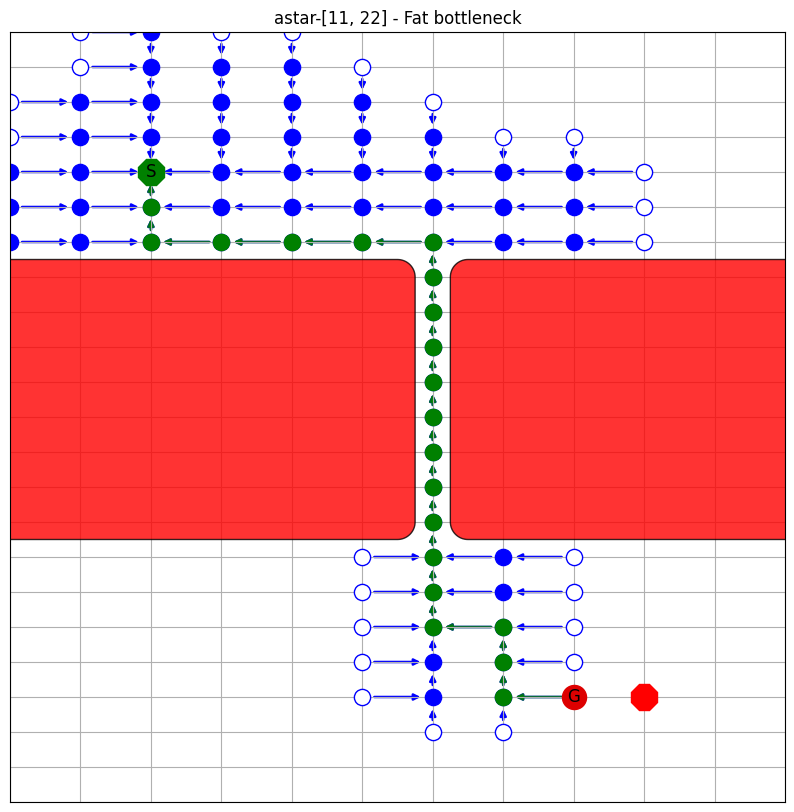

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [4.0, 11.0]
Goal: [16.0, 3.0]


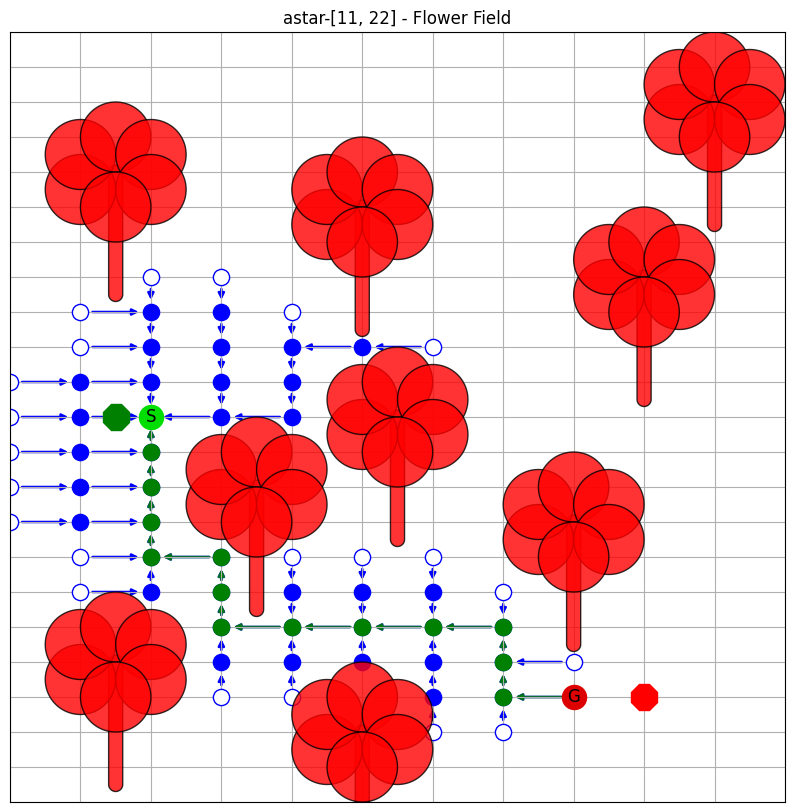

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]


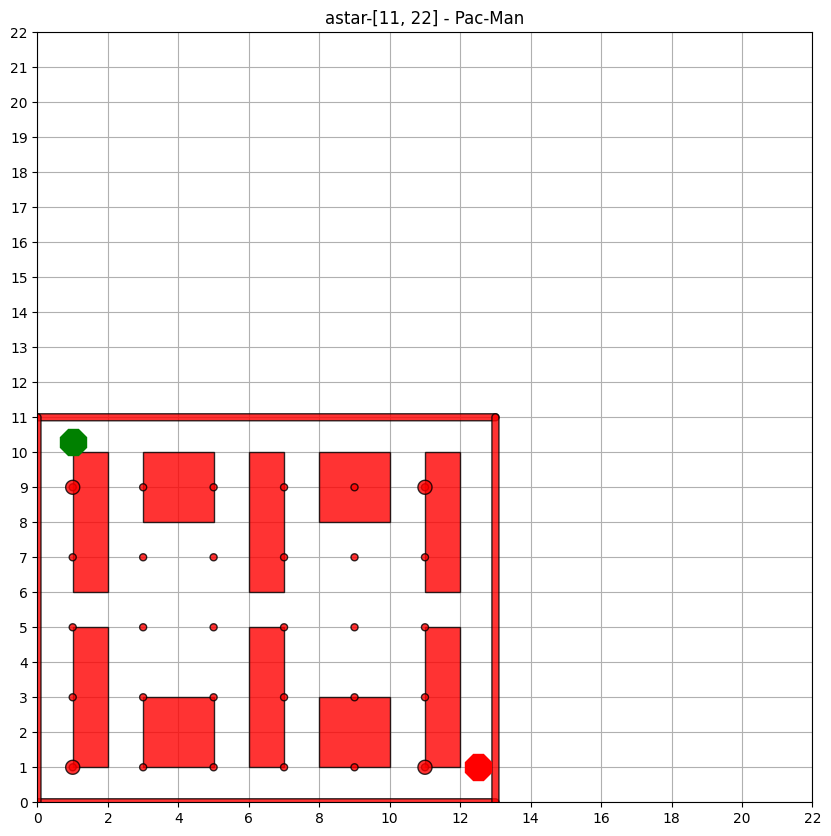

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [6.0, 5.0]
Goal: [18.0, 19.0]


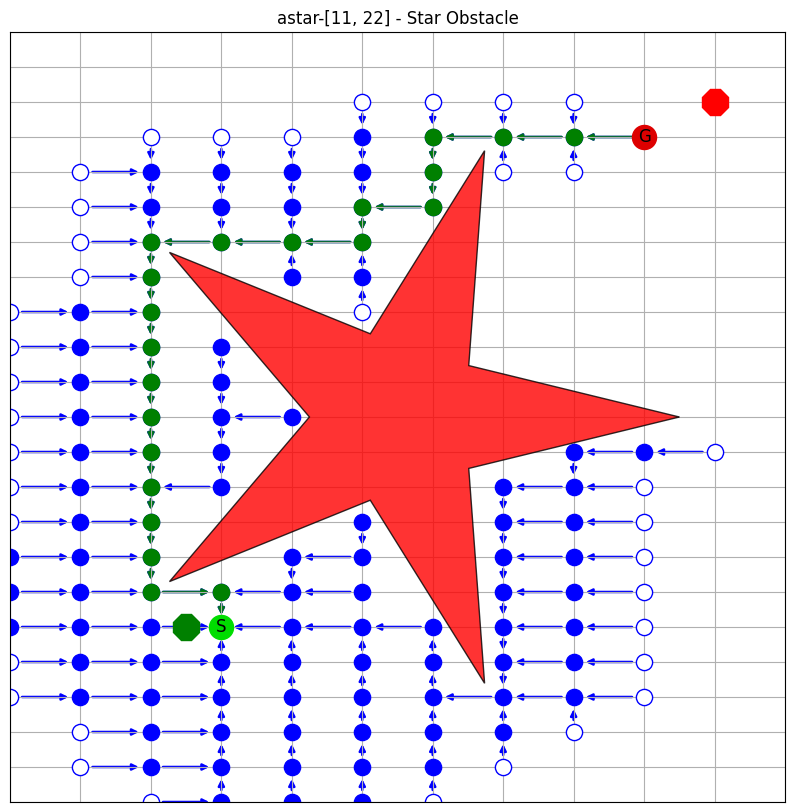

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.0, 4.0]
Goal: [18.0, 19.0]


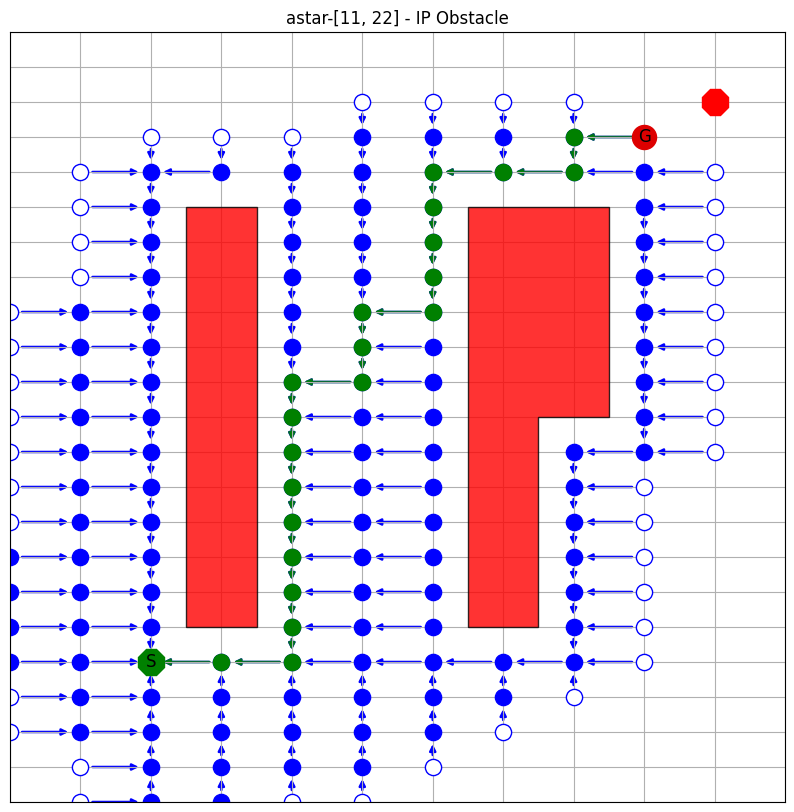

Initial start: [11, 2]
Initial goal: [11, 20]


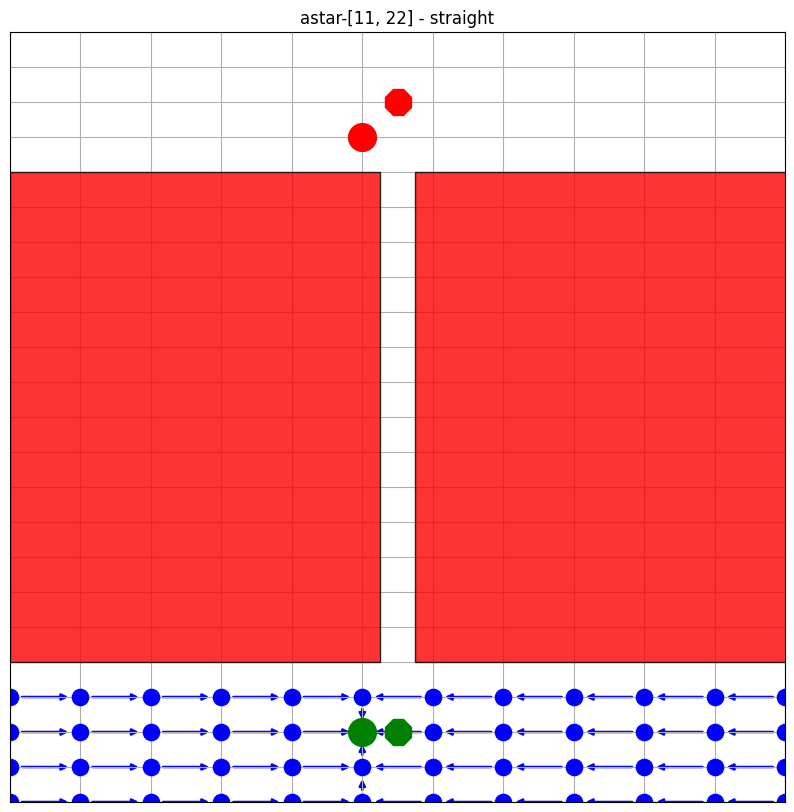

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [2.0, 1.0]
Goal: [18.0, 19.0]


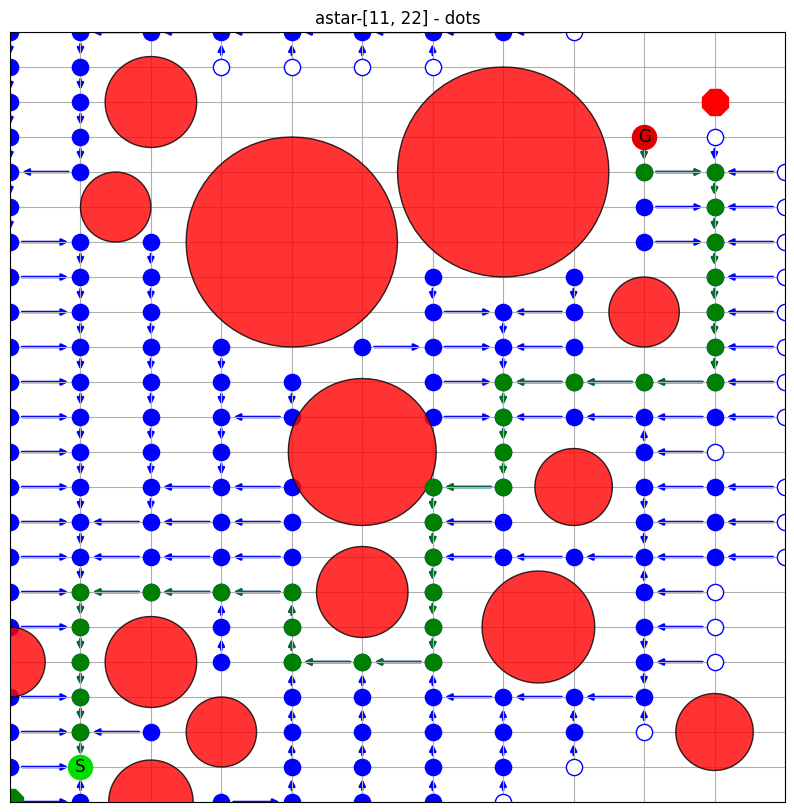

Initial start: [1.0, 5]
Initial goal: [21, 5.0]


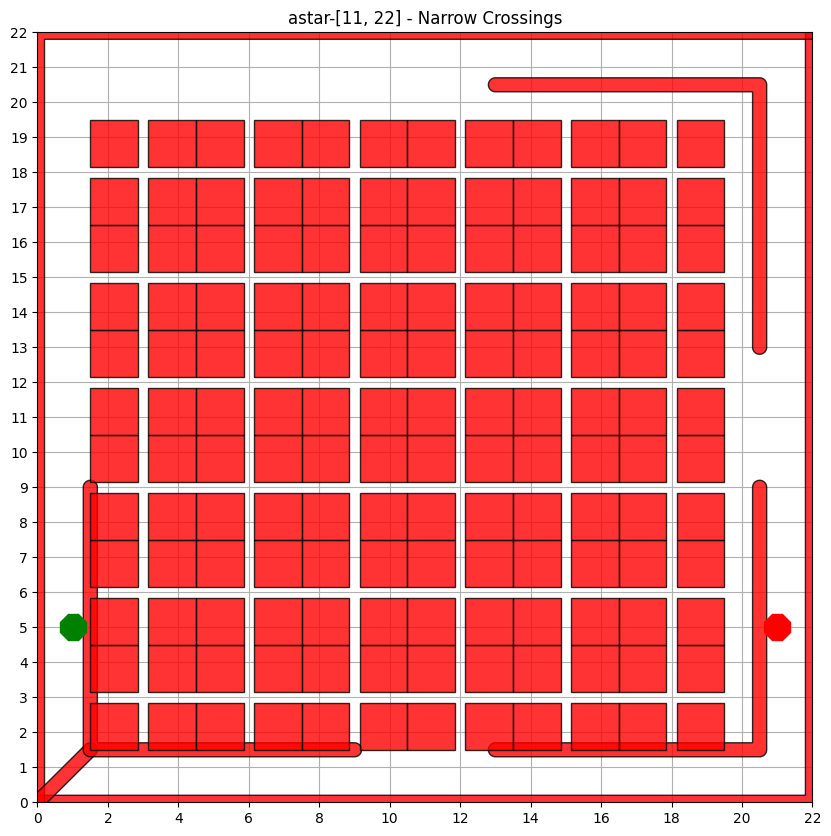

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.0, 1.0]
Goal: [16.0, 18.0]


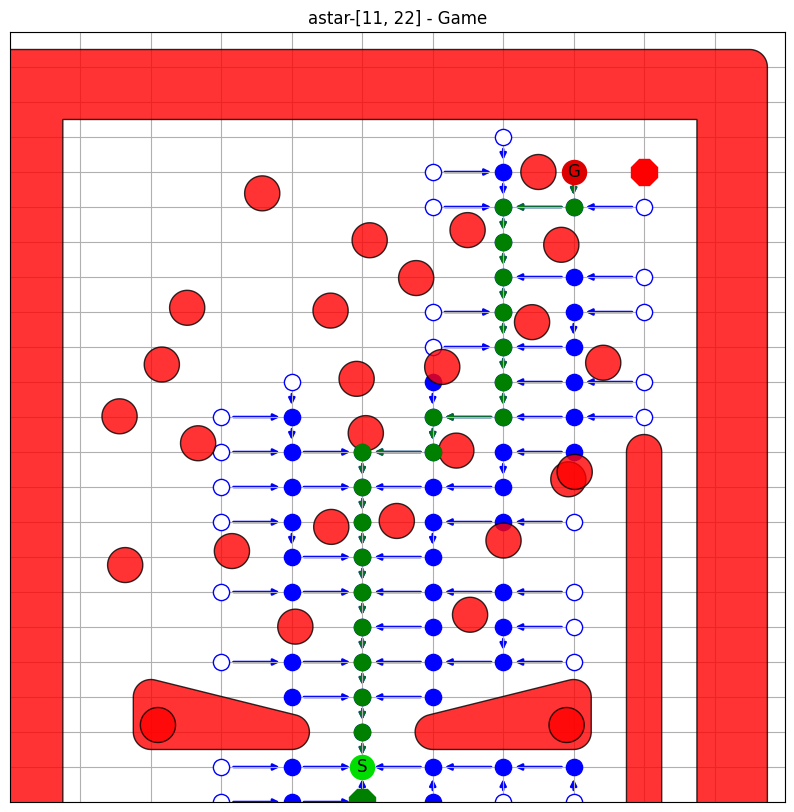

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [11.0, 11.0]
Goal: [11.0, 6.6000000000000005]


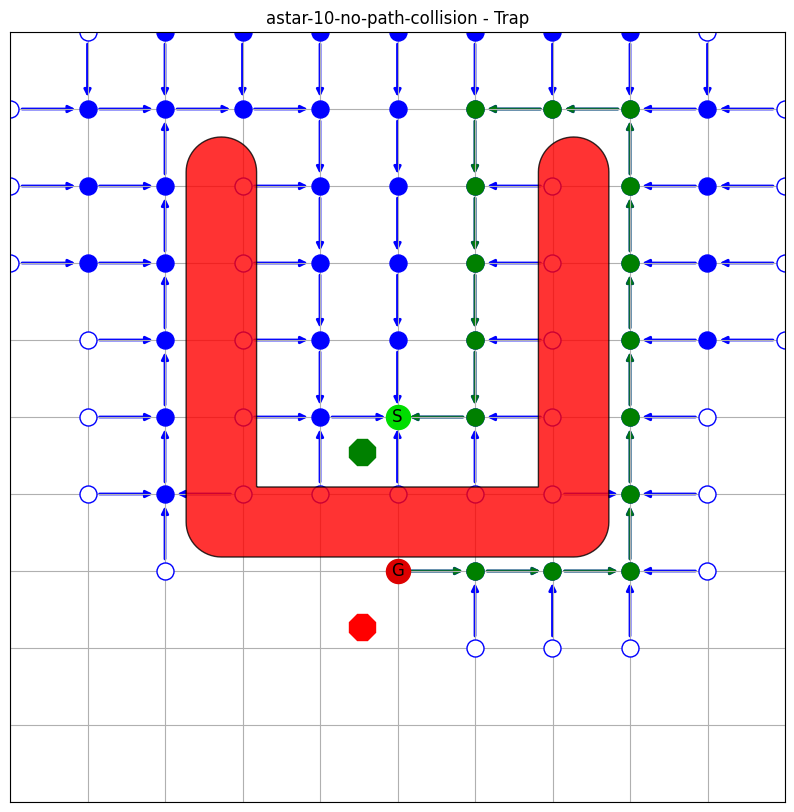

Initial start: [4, 15]
Initial goal: [18, 3]


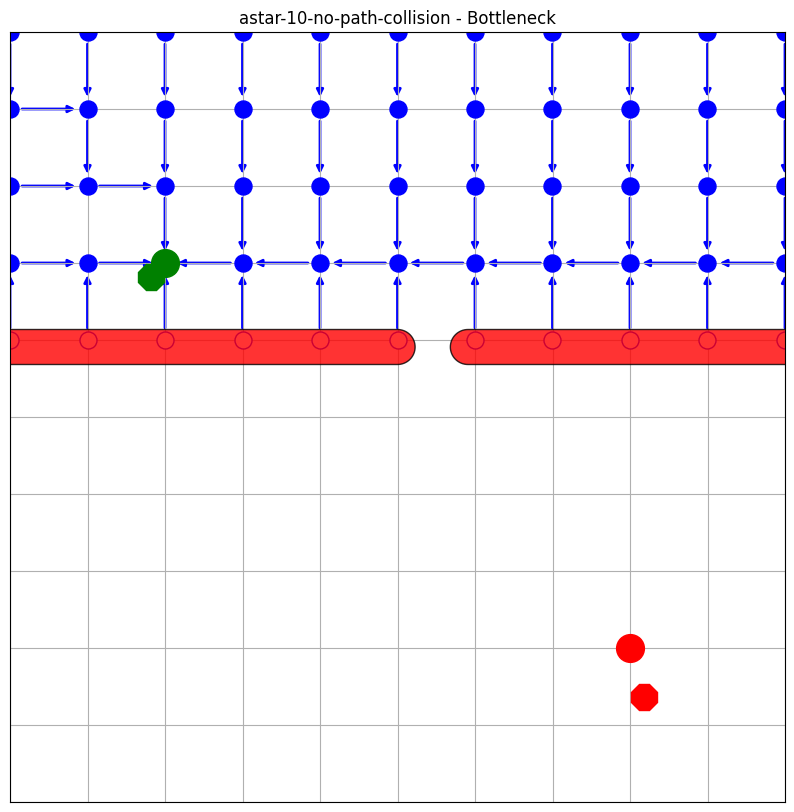

Initial start: [4, 18]
Initial goal: [18, 3]


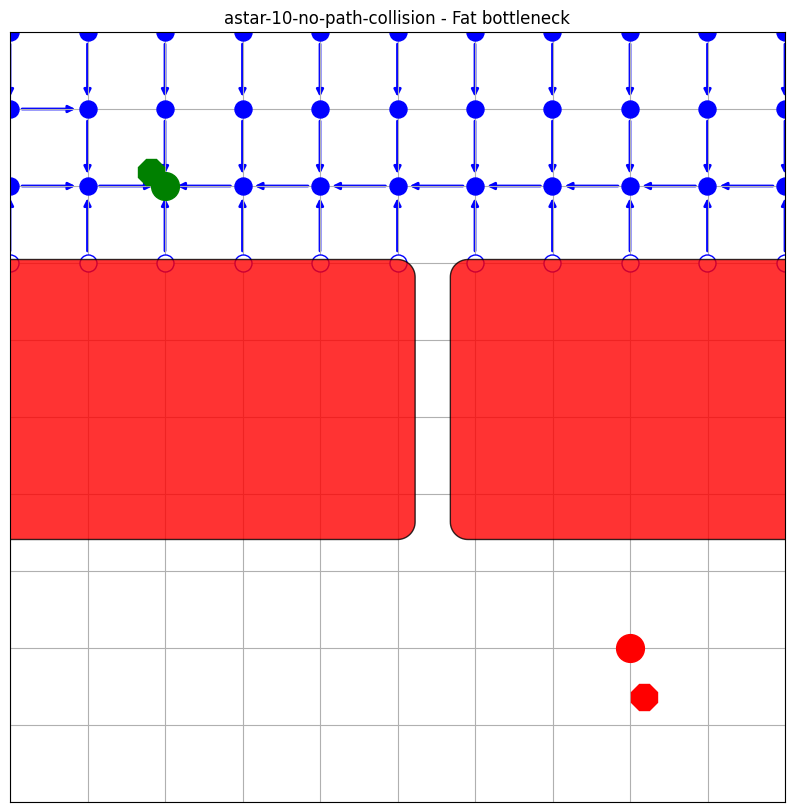

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [4.4, 8.8]
Goal: [17.6, 4.4]


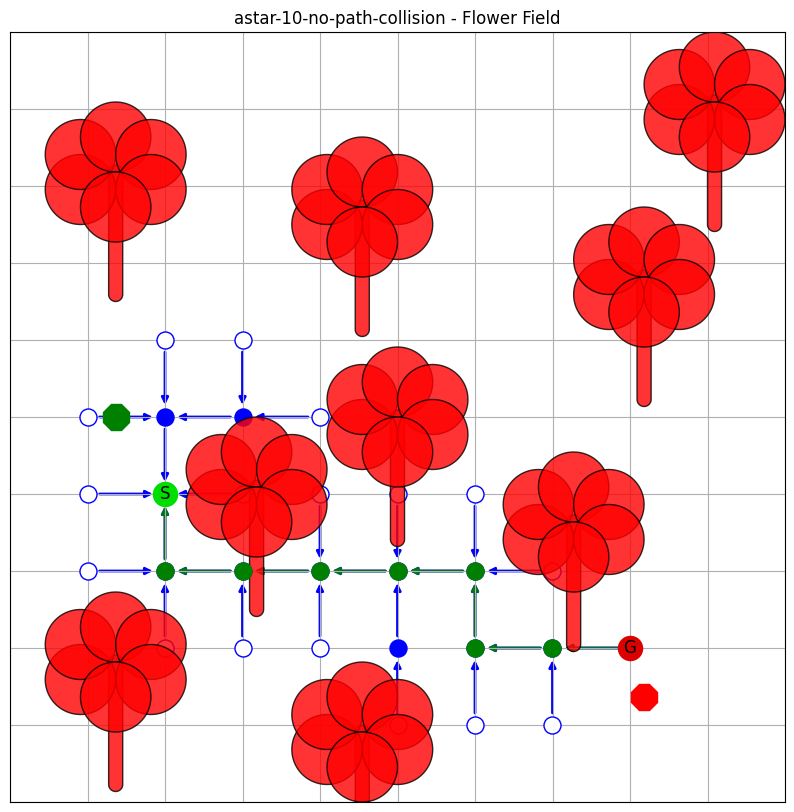

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]


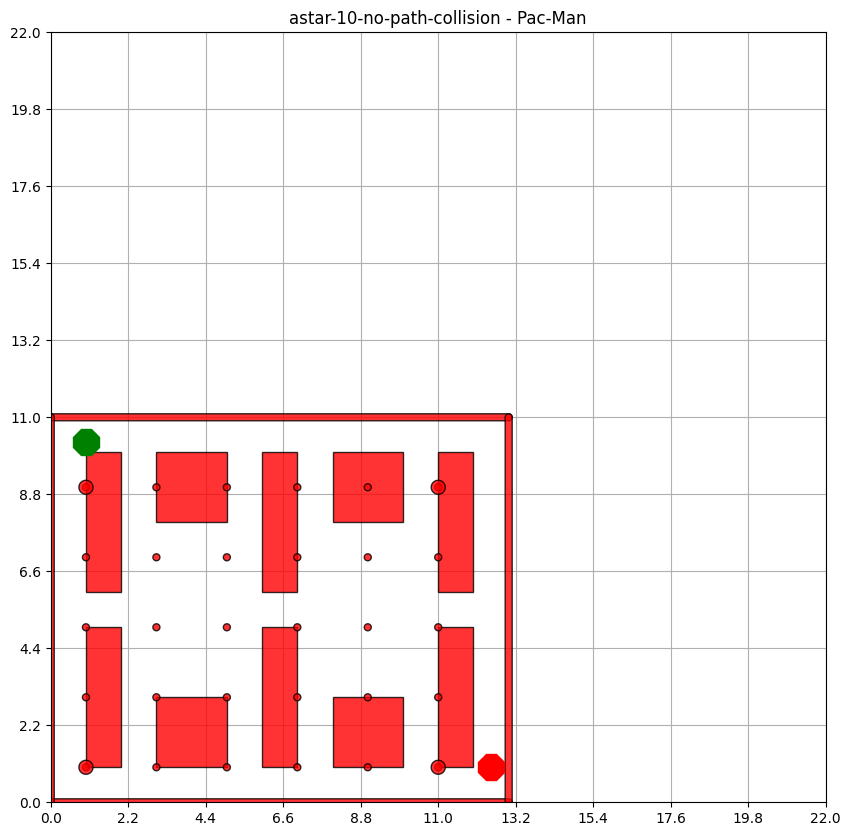

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [6.6000000000000005, 6.6000000000000005]
Goal: [19.8, 19.8]


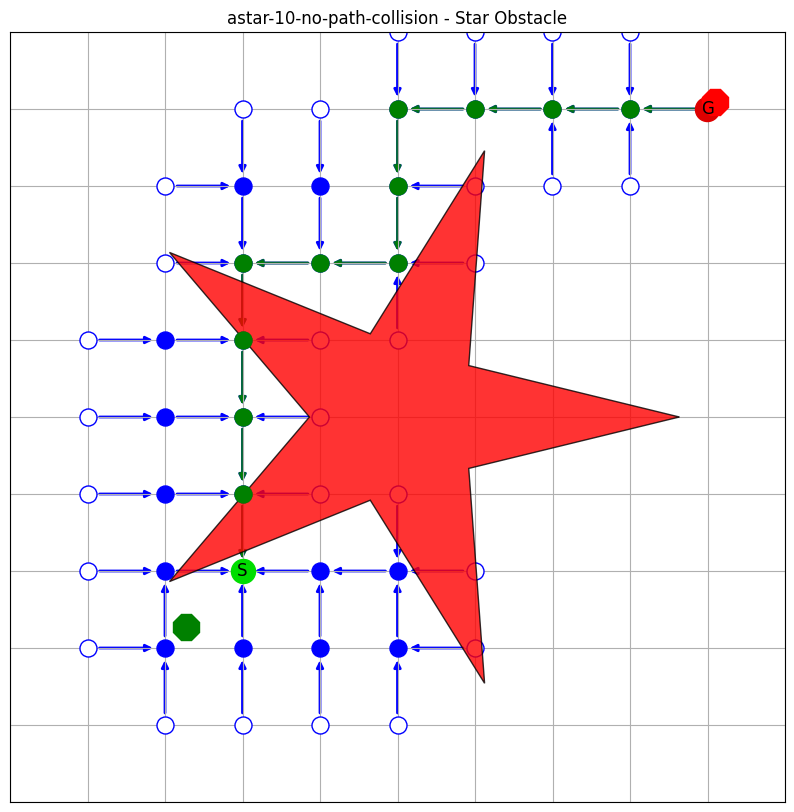

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.4, 4.4]
Goal: [19.8, 19.8]


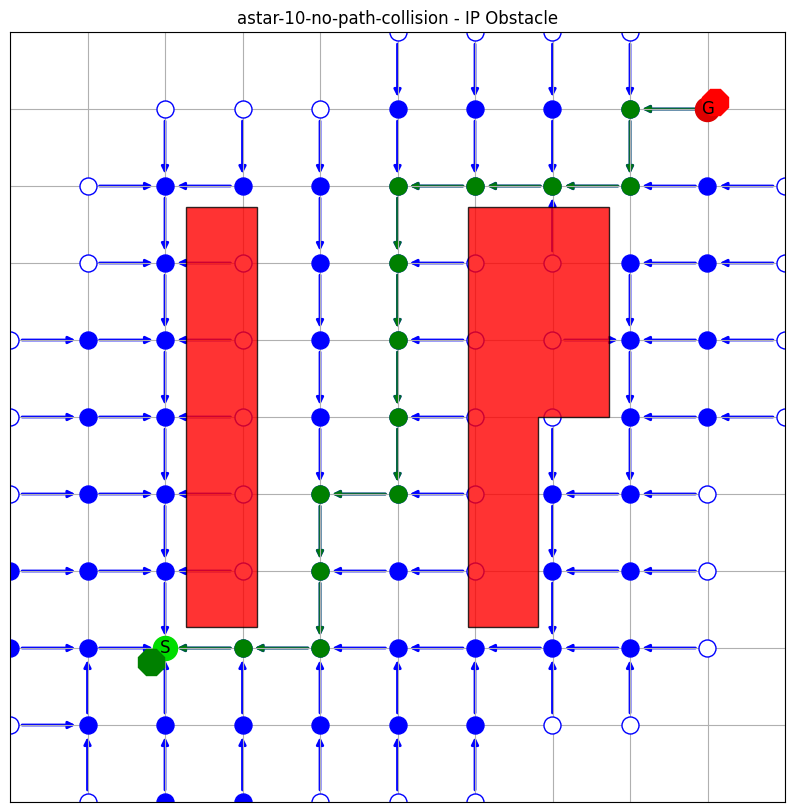

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.2]
Goal: [11.0, 19.8]


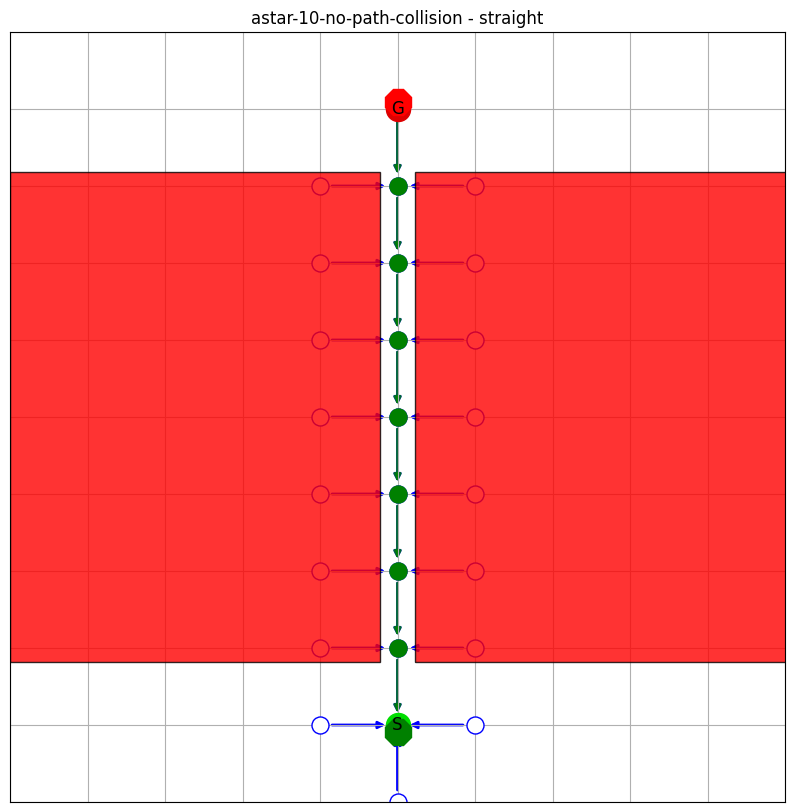

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [2.2, 2.2]
Goal: [19.8, 19.8]


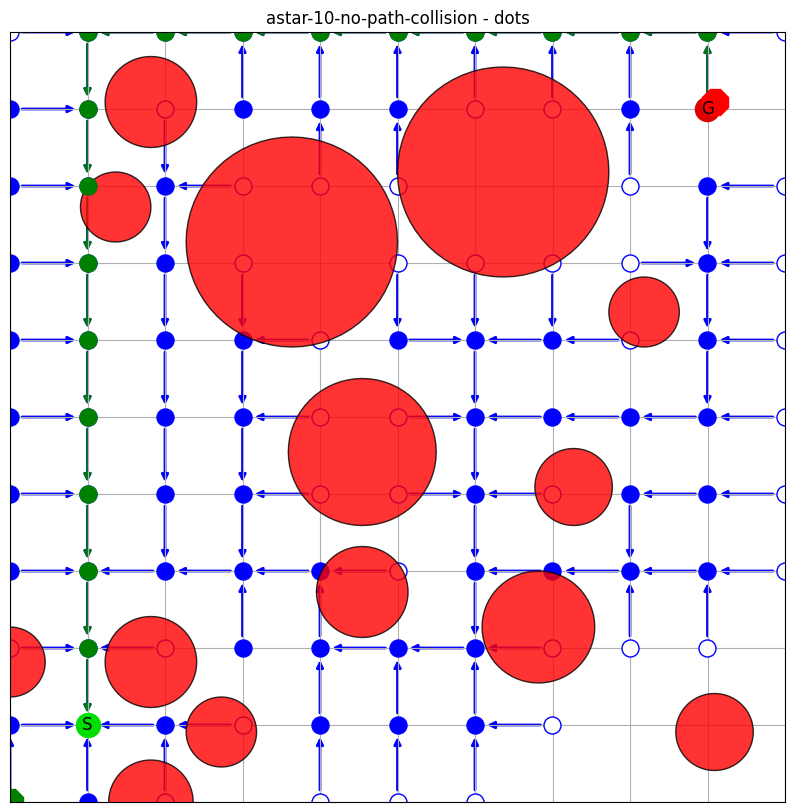

Initial start: [1.0, 5]
Initial goal: [21, 5.0]


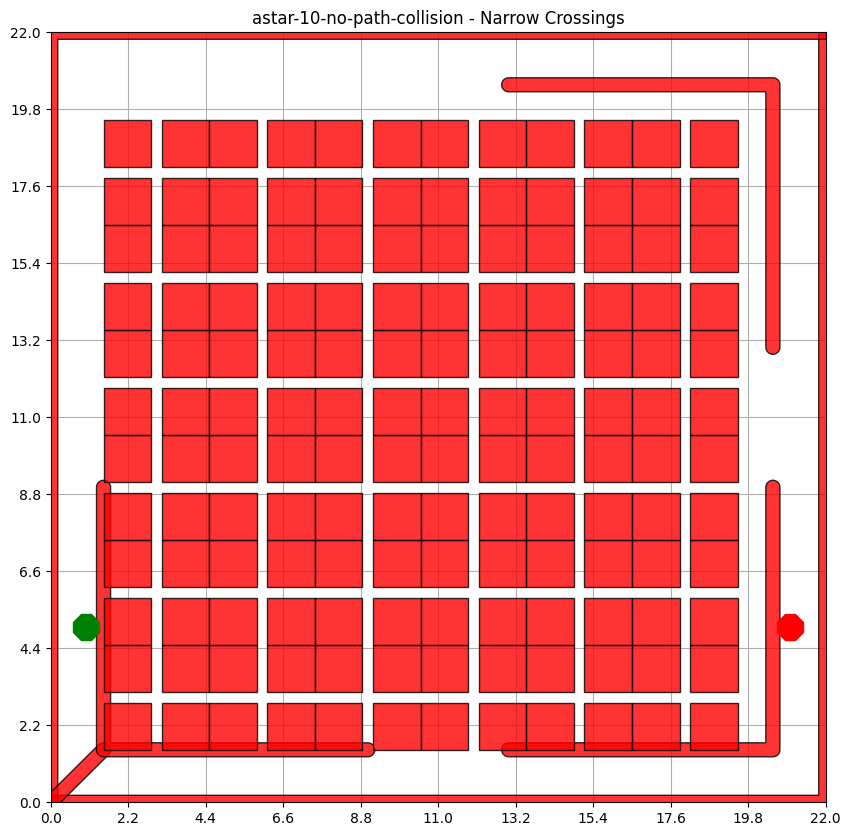

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [11.0, 2.2]
Goal: [17.6, 17.6]


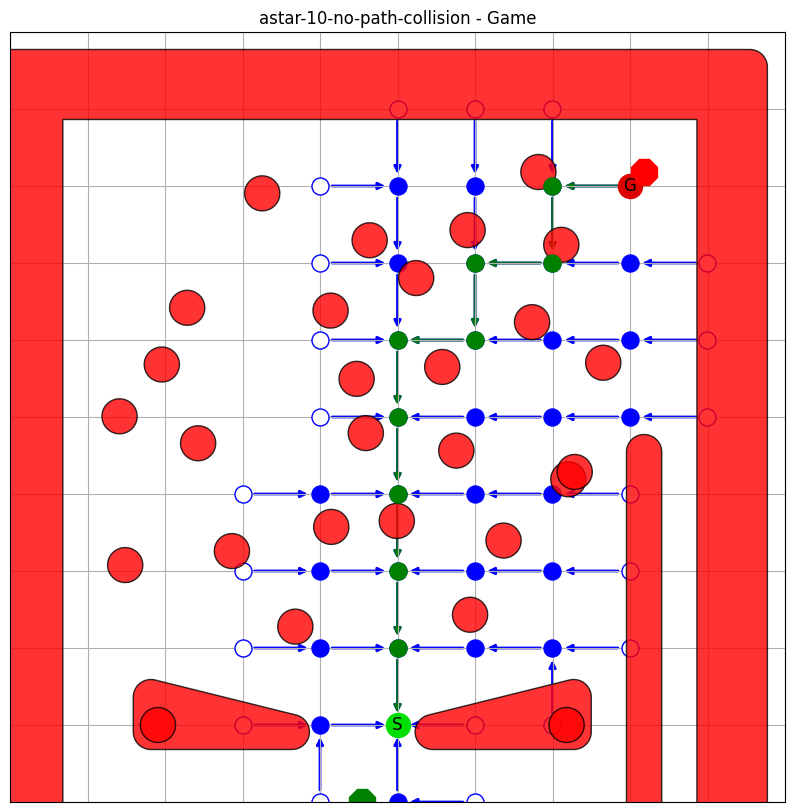

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.266666666666666, 10.266666666666666]
Goal: [10.266666666666666, 5.866666666666666]


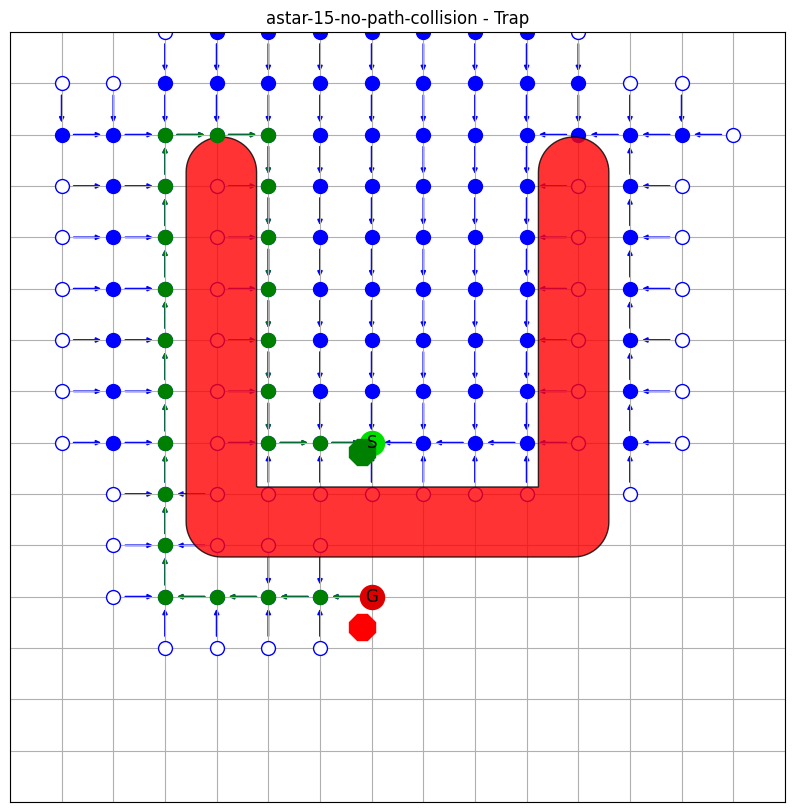

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.3999999999999995, 14.666666666666666]
Goal: [17.599999999999998, 4.3999999999999995]


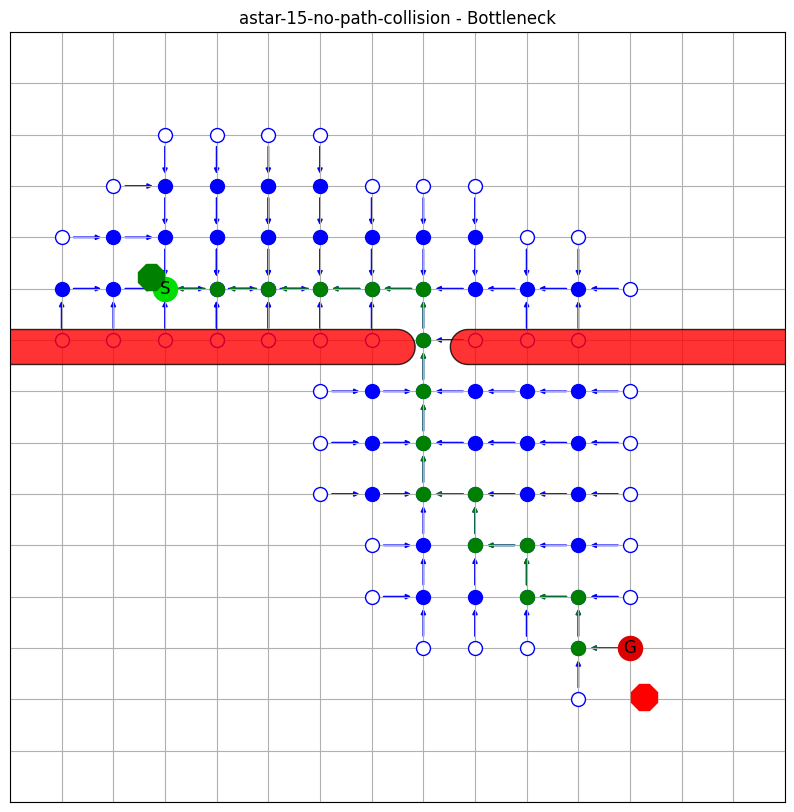

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.3999999999999995, 17.599999999999998]
Goal: [17.599999999999998, 4.3999999999999995]


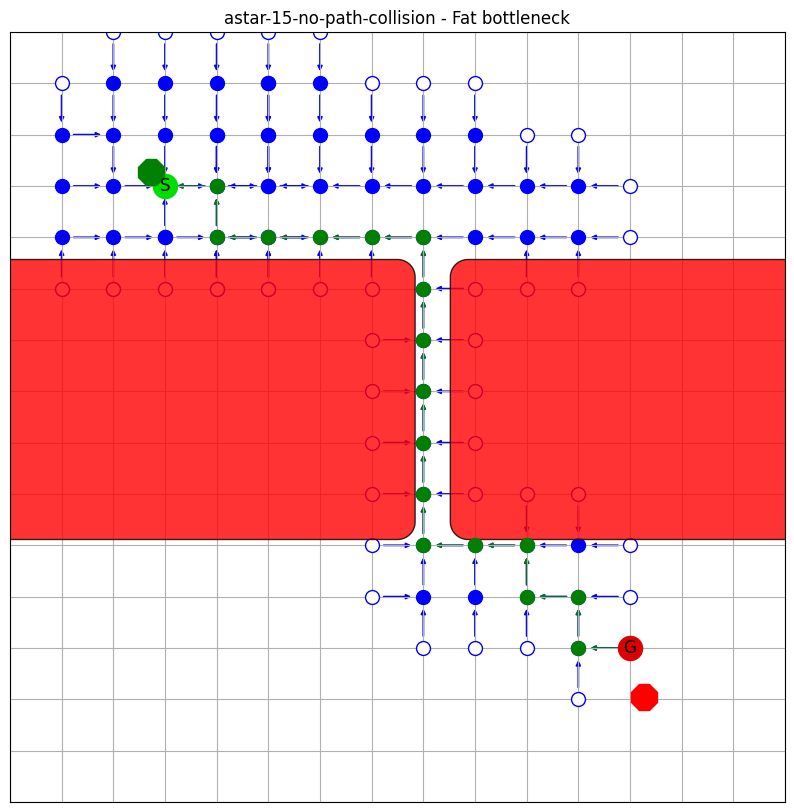

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [4.3999999999999995, 10.266666666666666]
Goal: [17.599999999999998, 4.3999999999999995]


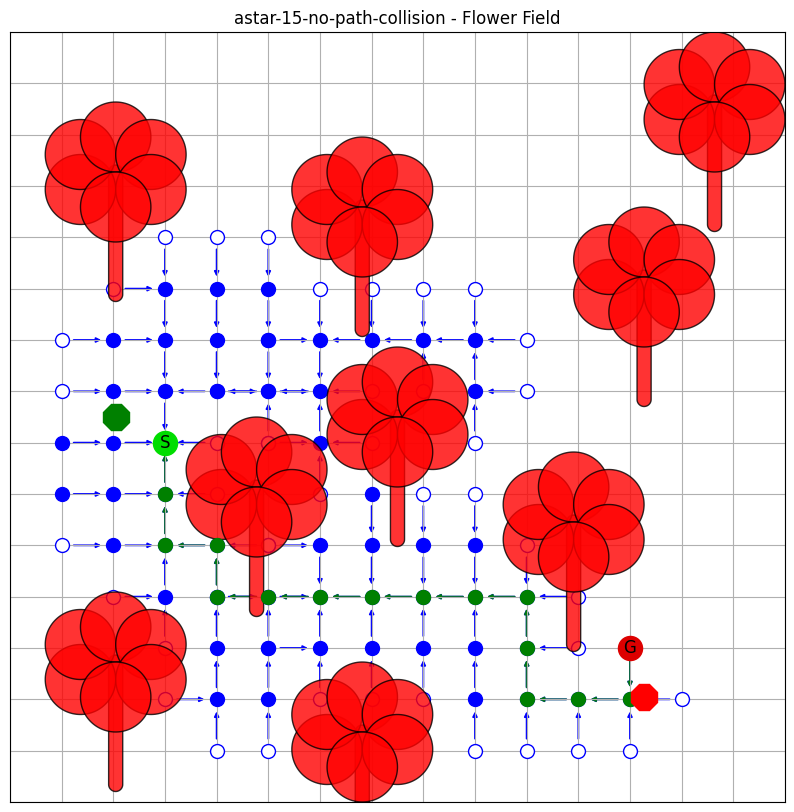

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]


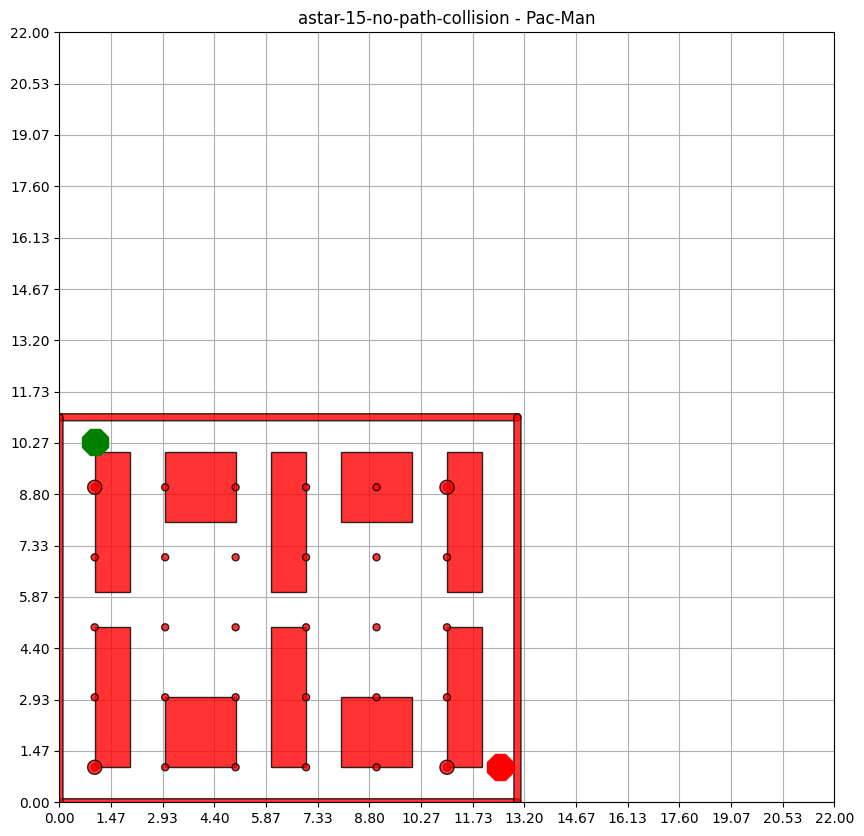

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.866666666666666, 5.866666666666666]
Goal: [19.066666666666666, 19.066666666666666]


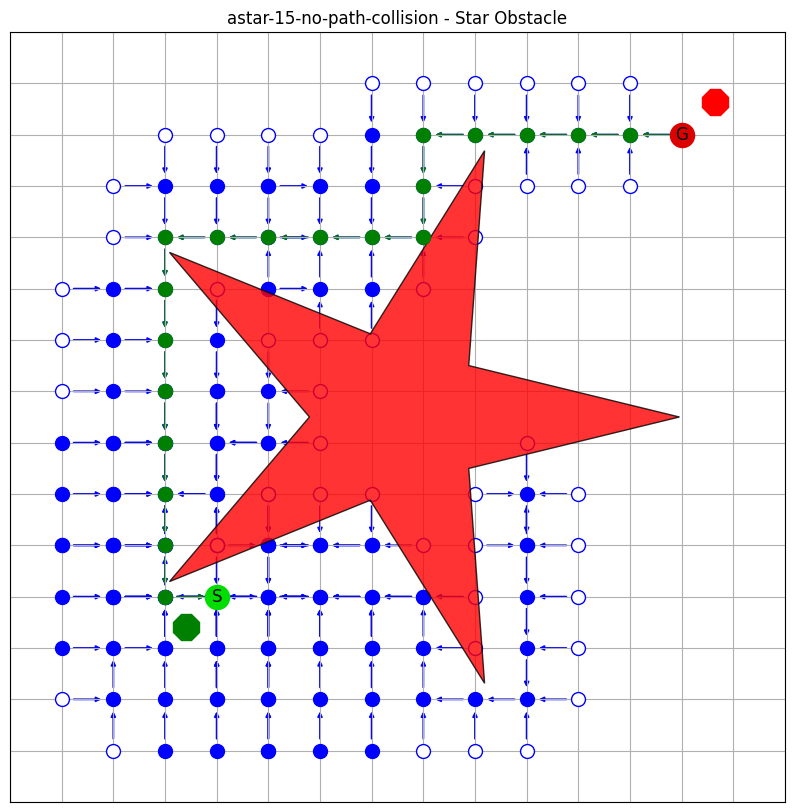

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.3999999999999995, 4.3999999999999995]
Goal: [19.066666666666666, 19.066666666666666]


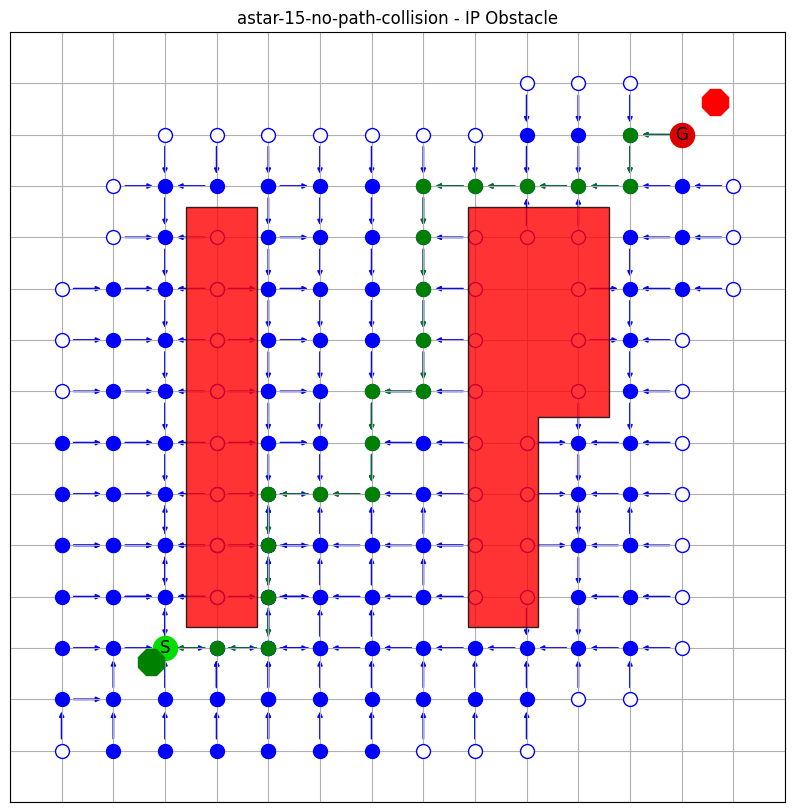

Initial start: [11, 2]
Initial goal: [11, 20]


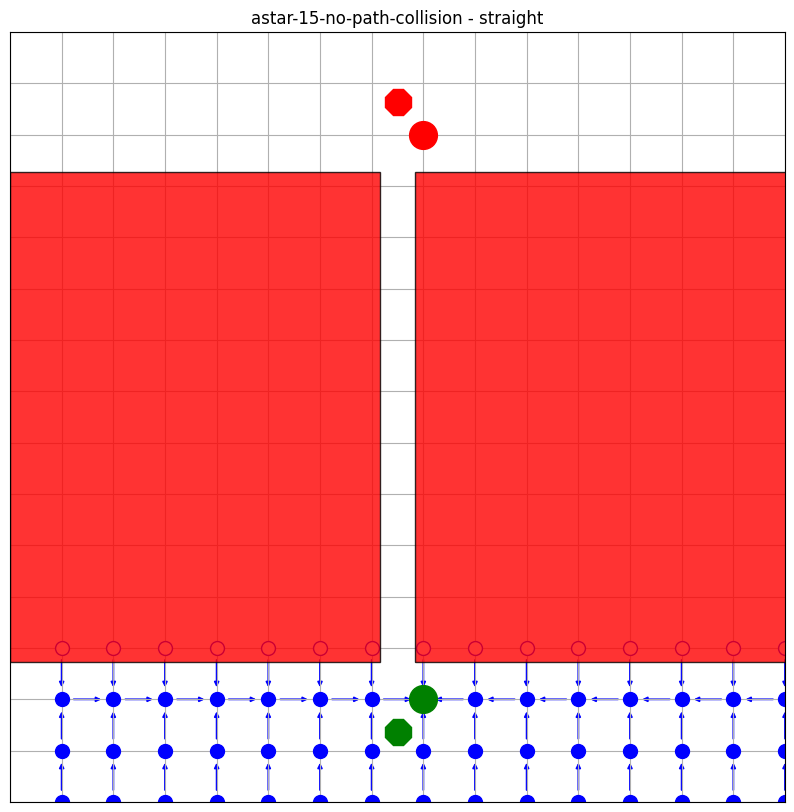

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [1.4666666666666666, 1.4666666666666666]
Goal: [19.066666666666666, 19.066666666666666]


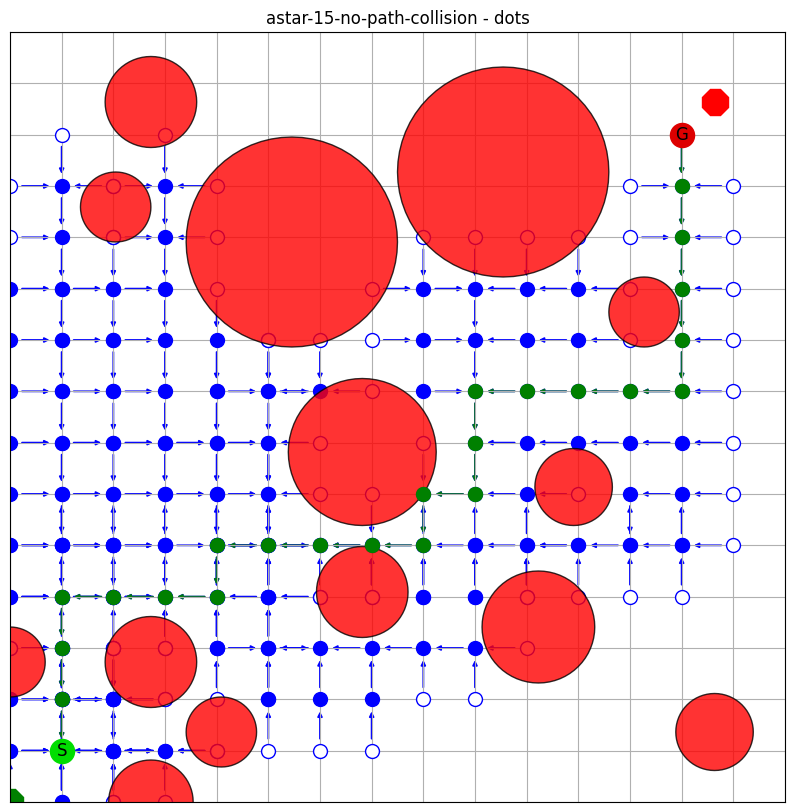

Initial start: [1.0, 5]
Initial goal: [21, 5.0]


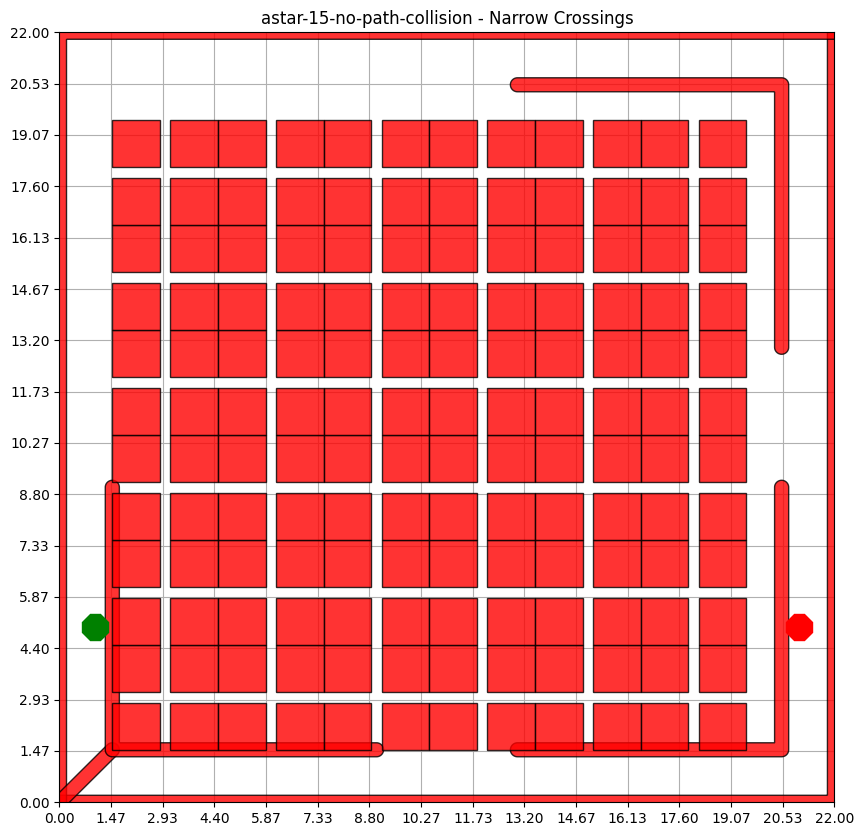

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.266666666666666, 1.4666666666666666]
Goal: [17.599999999999998, 17.599999999999998]


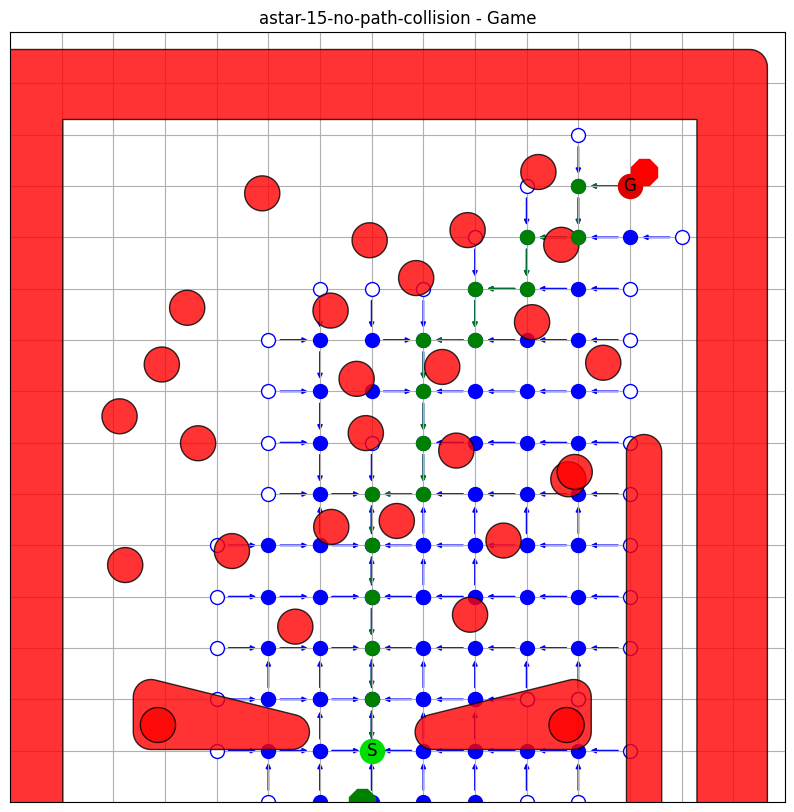

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [9.68, 9.68]
Goal: [9.68, 5.28]


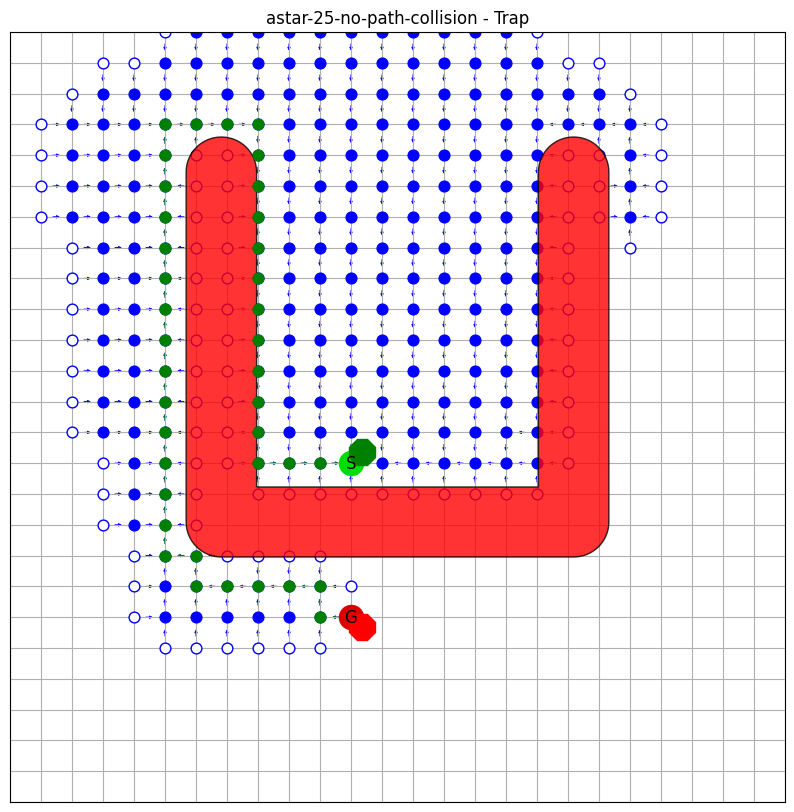

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.4, 14.96]
Goal: [17.6, 3.52]


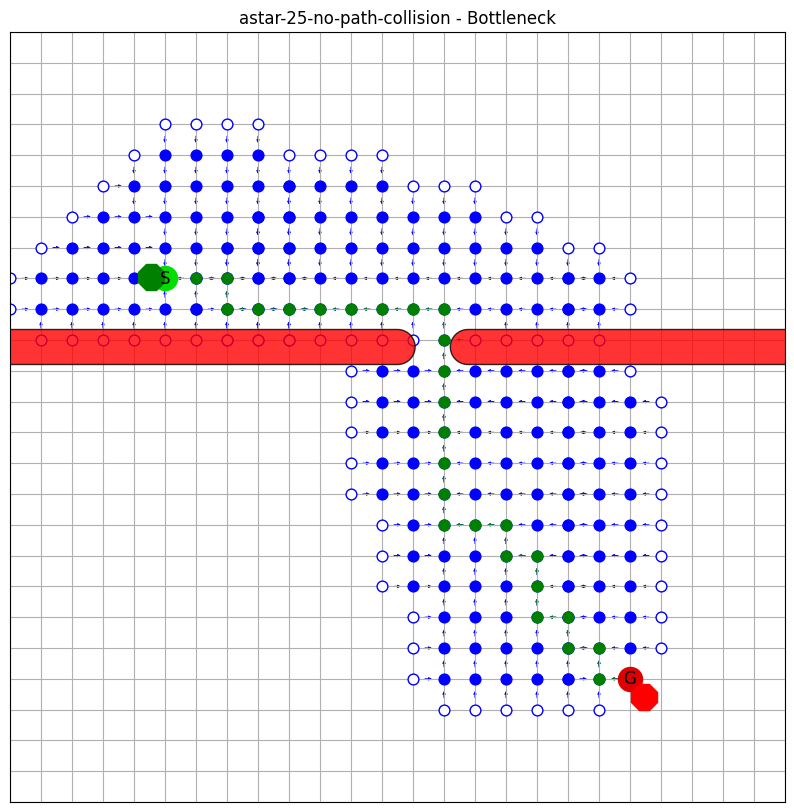

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.4, 17.6]
Goal: [17.6, 3.52]


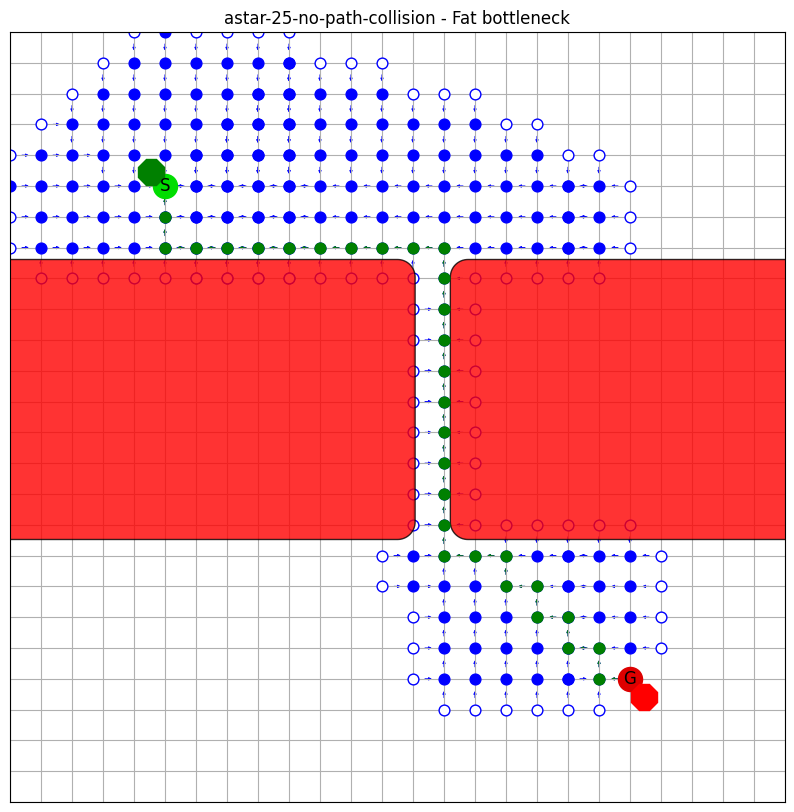

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.52, 10.56]
Goal: [17.6, 3.52]


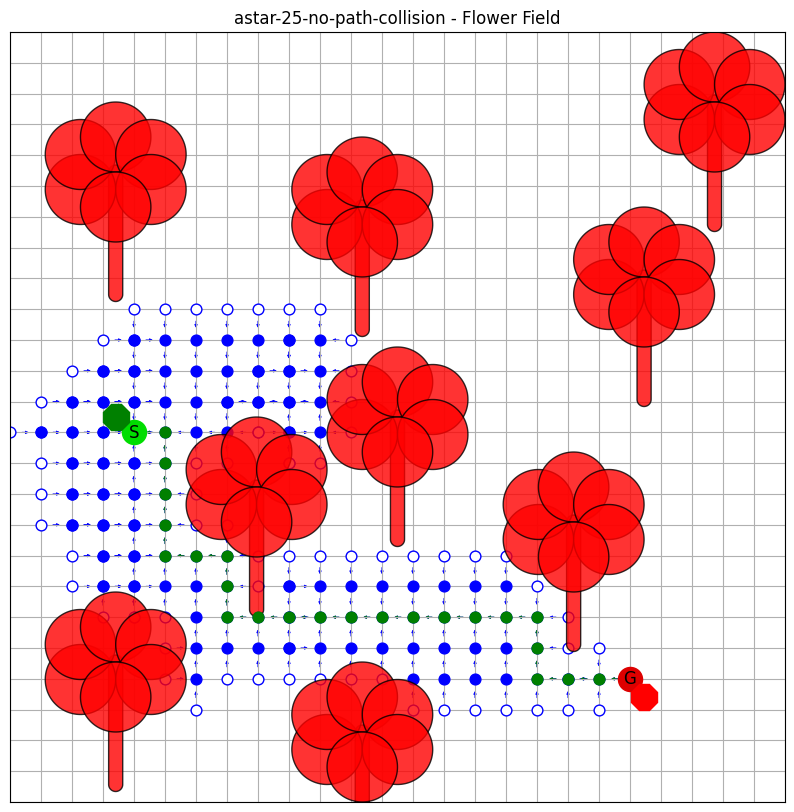

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.76, 10.56]
Goal: [12.32, 1.76]


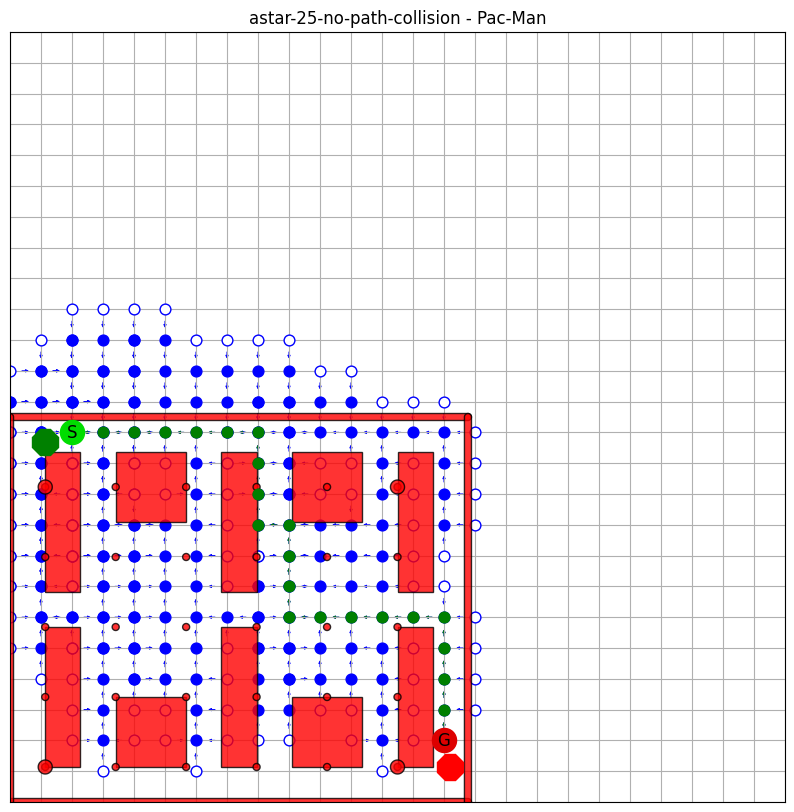

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.28, 5.28]
Goal: [19.36, 19.36]


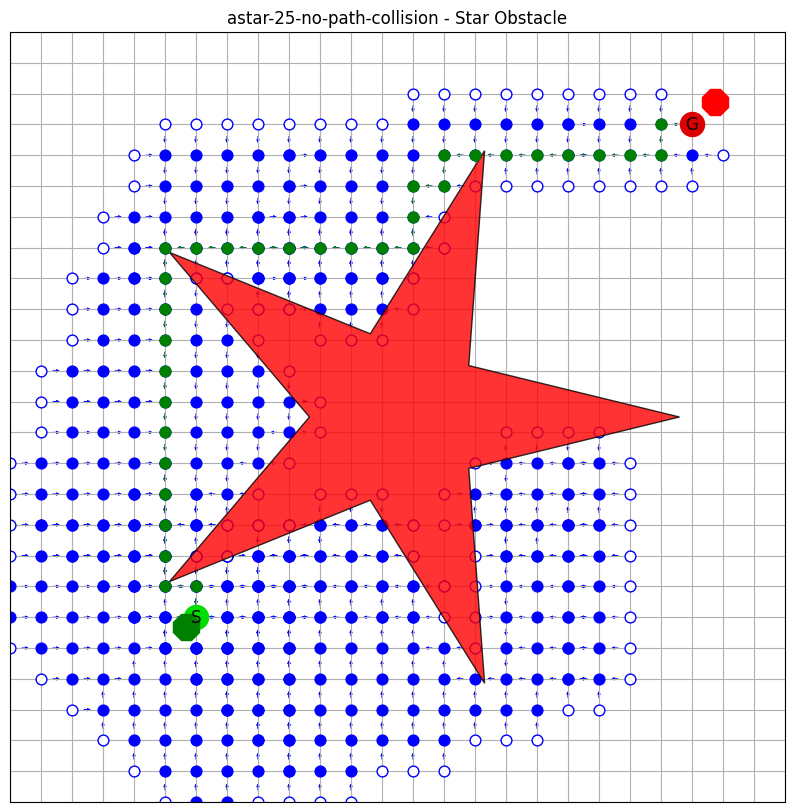

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.4, 4.4]
Goal: [19.36, 19.36]


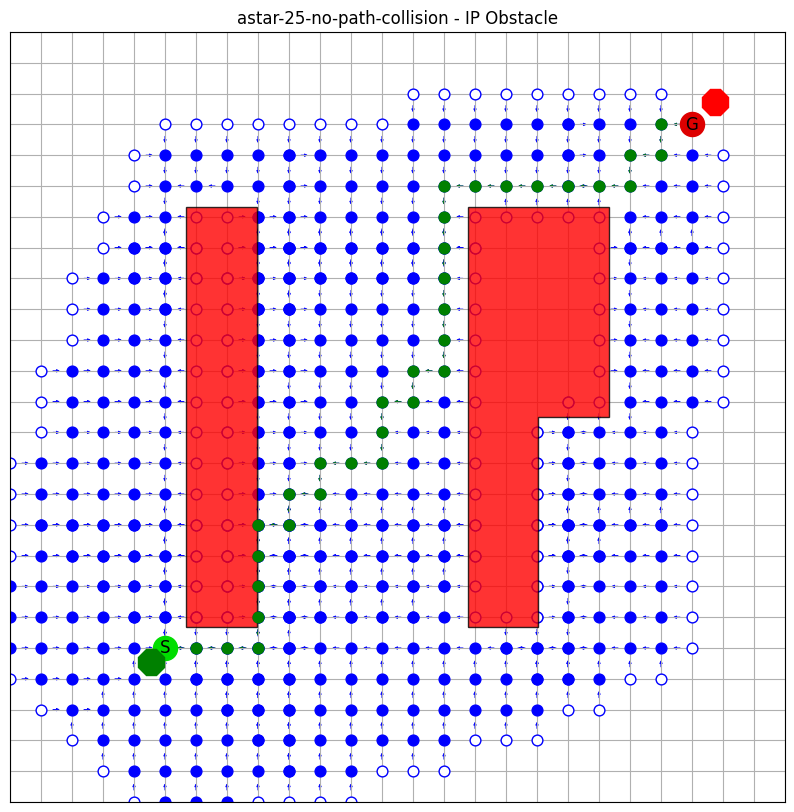

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [10.56, 2.64]
Goal: [10.56, 19.36]


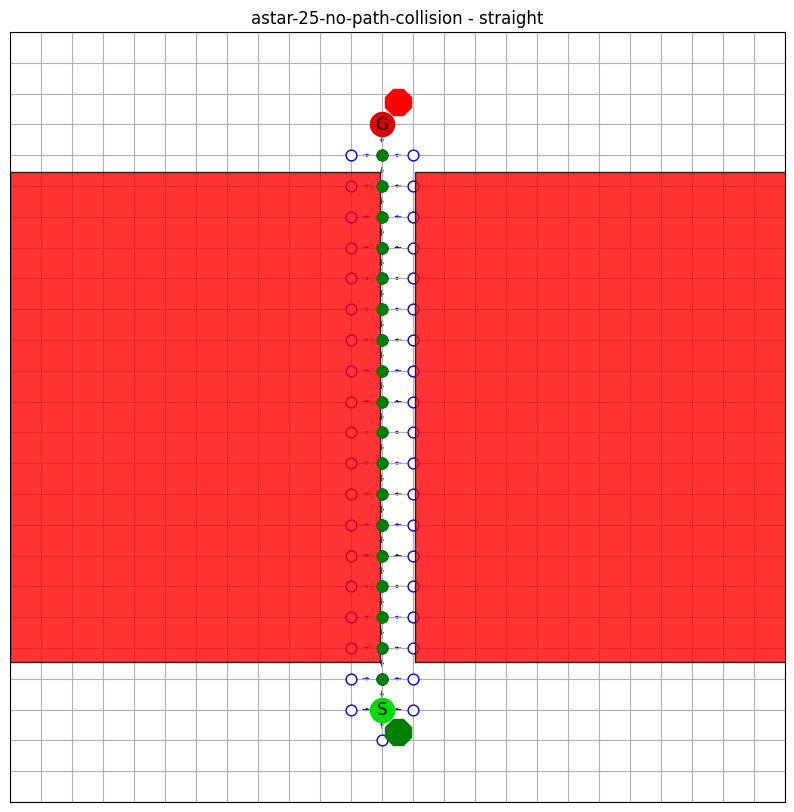

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.88, 0.88]
Goal: [19.36, 19.36]


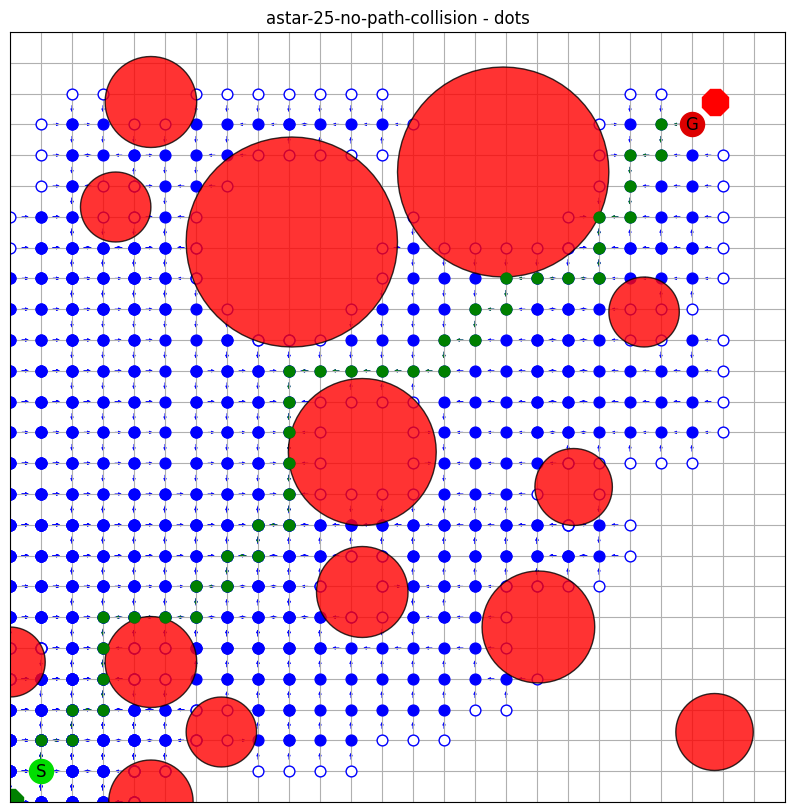

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [0.88, 5.28]
Goal: [21.12, 5.28]


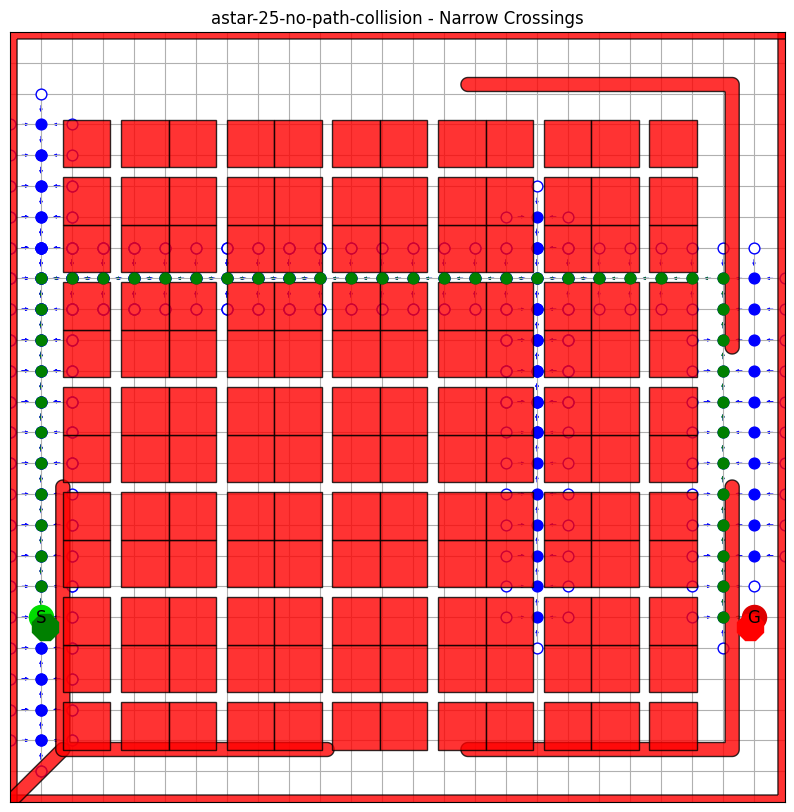

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.56, 0.88]
Goal: [17.6, 17.6]


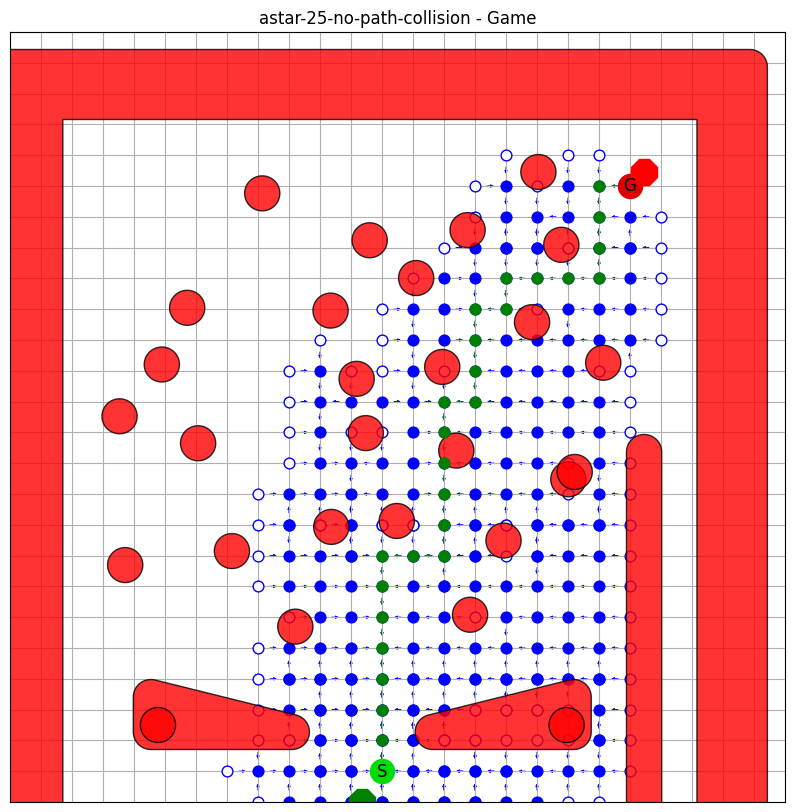

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.266666666666666, 9.533333333333333]
Goal: [10.266666666666666, 5.133333333333333]


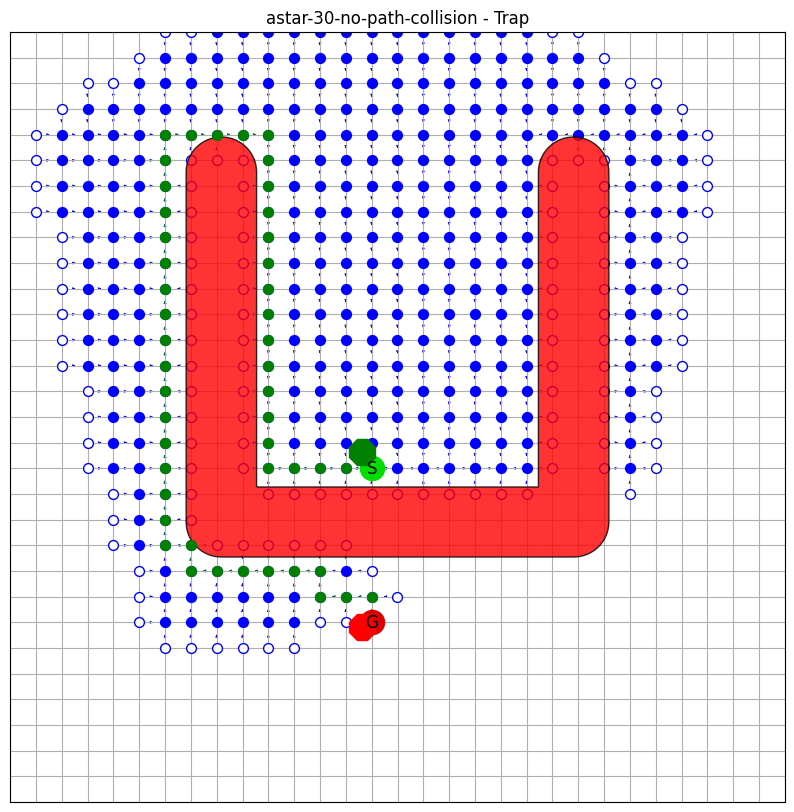

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.3999999999999995, 14.666666666666666]
Goal: [17.599999999999998, 3.6666666666666665]


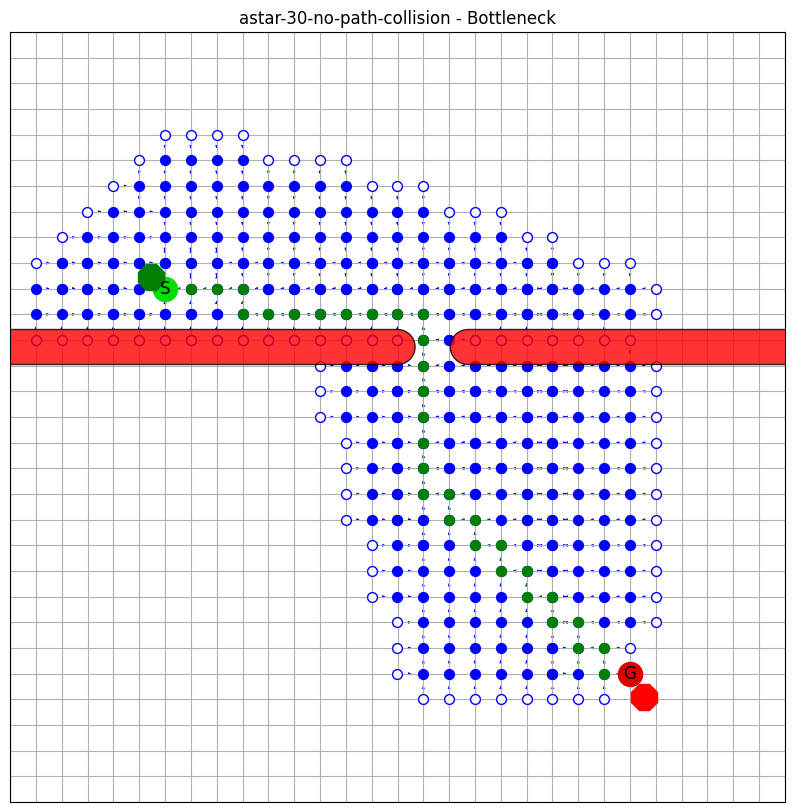

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.3999999999999995, 17.599999999999998]
Goal: [17.599999999999998, 3.6666666666666665]


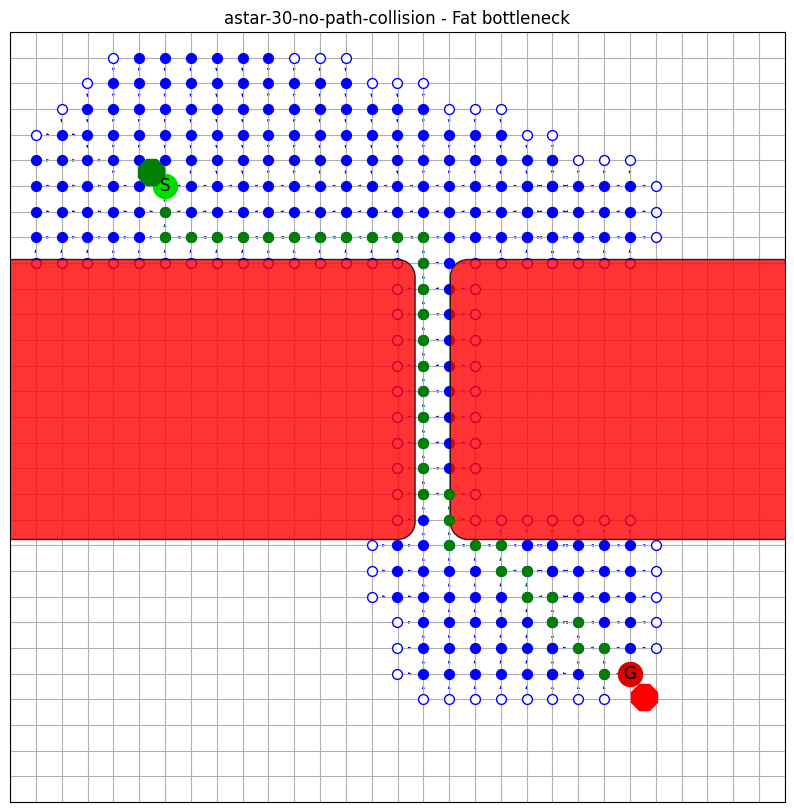

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.6666666666666665, 11.0]
Goal: [17.599999999999998, 3.6666666666666665]


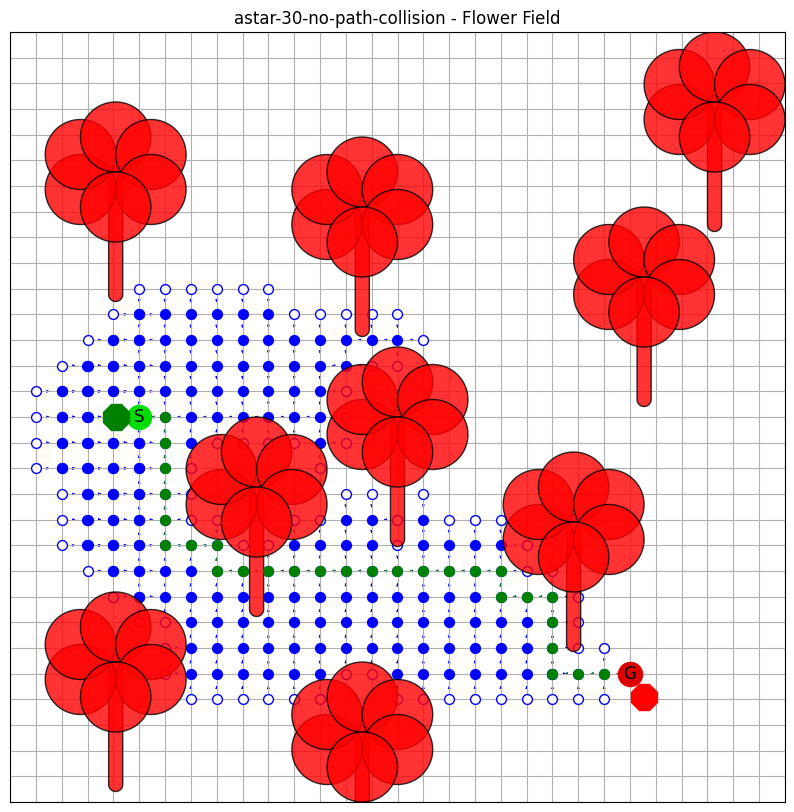

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.4666666666666666, 10.266666666666666]
Goal: [12.466666666666665, 1.4666666666666666]


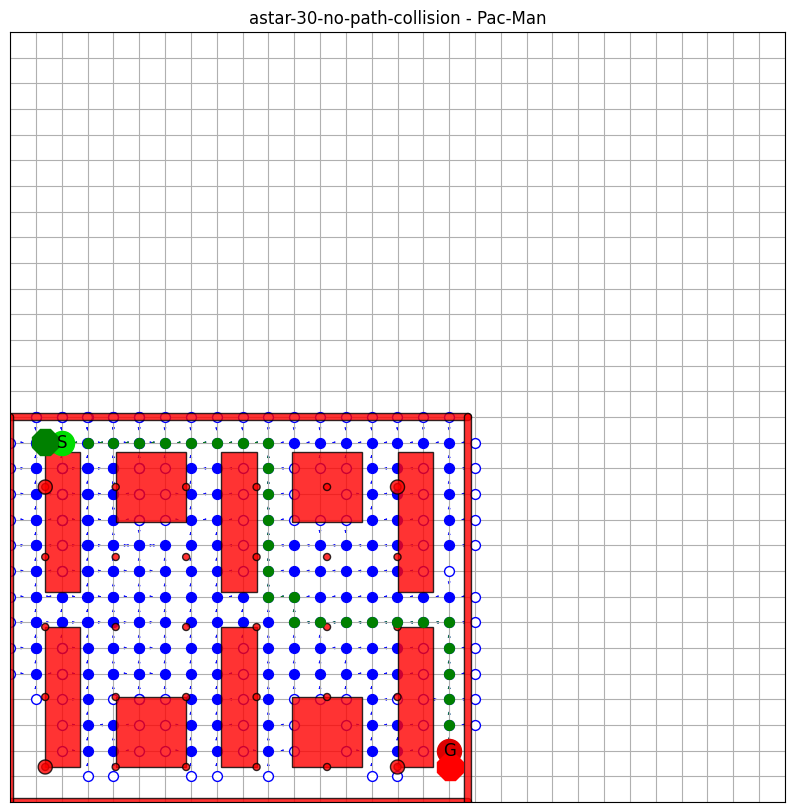

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.133333333333333, 5.133333333333333]
Goal: [19.799999999999997, 19.799999999999997]


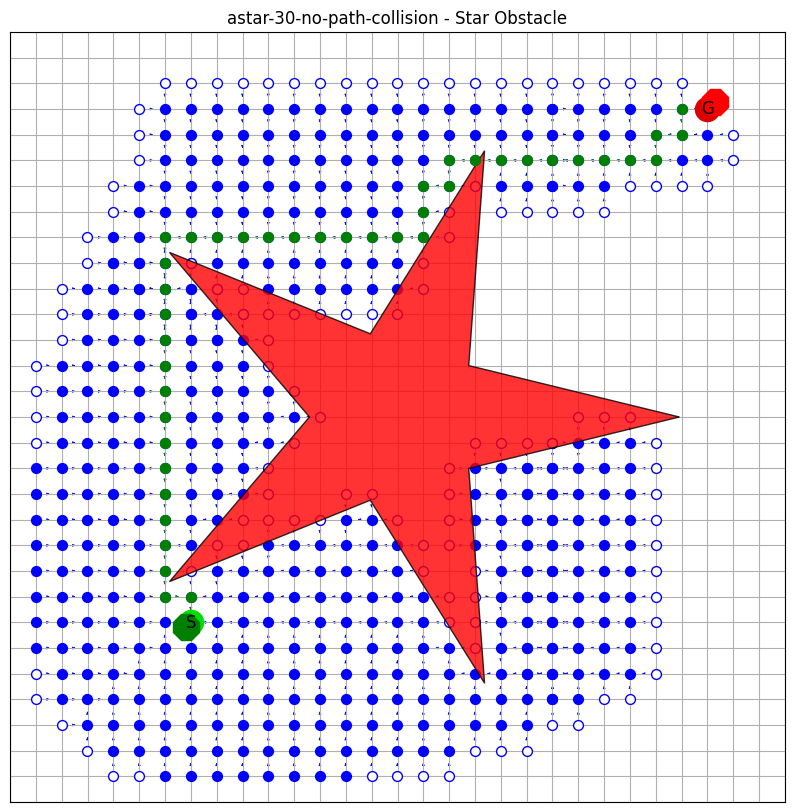

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.3999999999999995, 4.3999999999999995]
Goal: [19.799999999999997, 19.799999999999997]


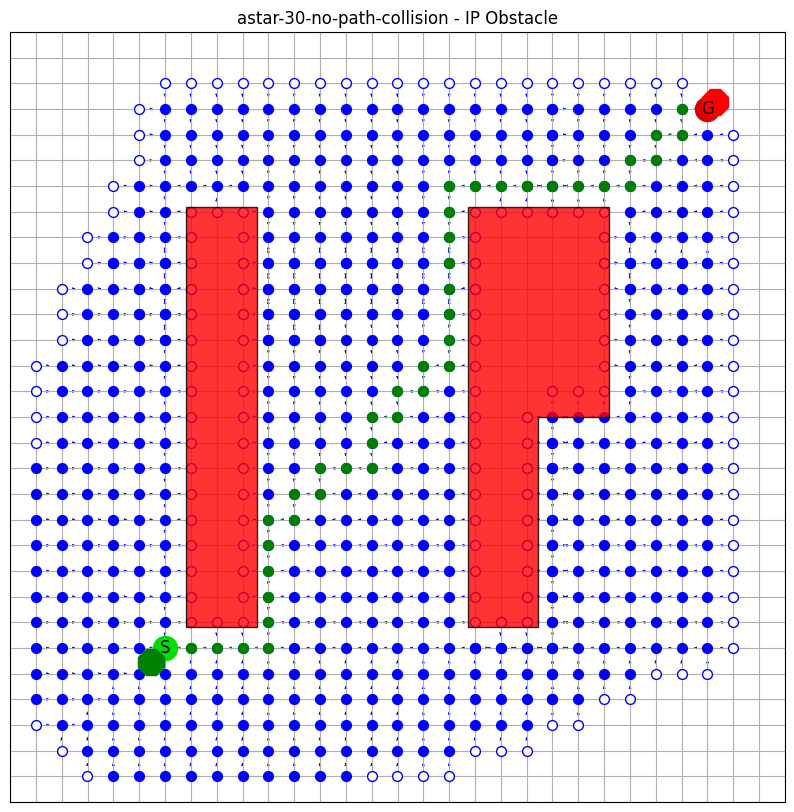

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.1999999999999997]
Goal: [11.0, 19.799999999999997]


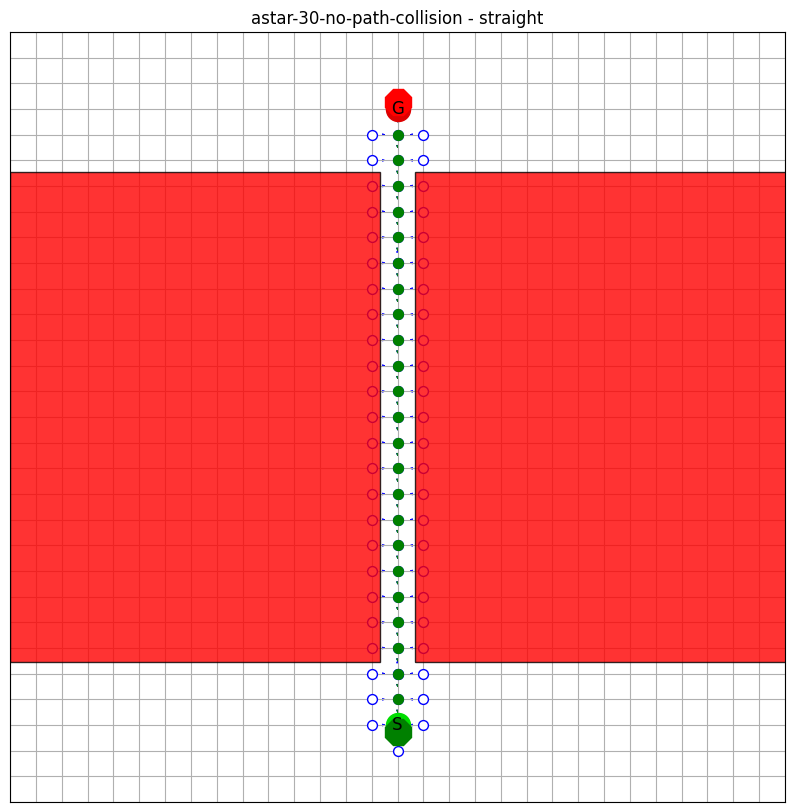

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.7333333333333333, 0.7333333333333333]
Goal: [19.799999999999997, 19.799999999999997]


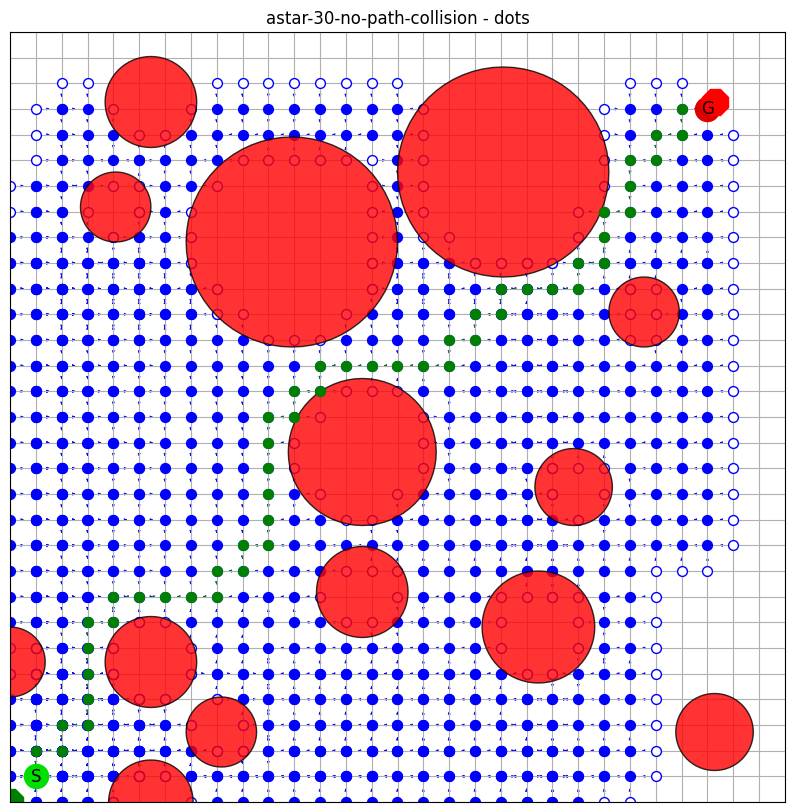

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [0.7333333333333333, 5.133333333333333]
Goal: [21.266666666666666, 5.133333333333333]


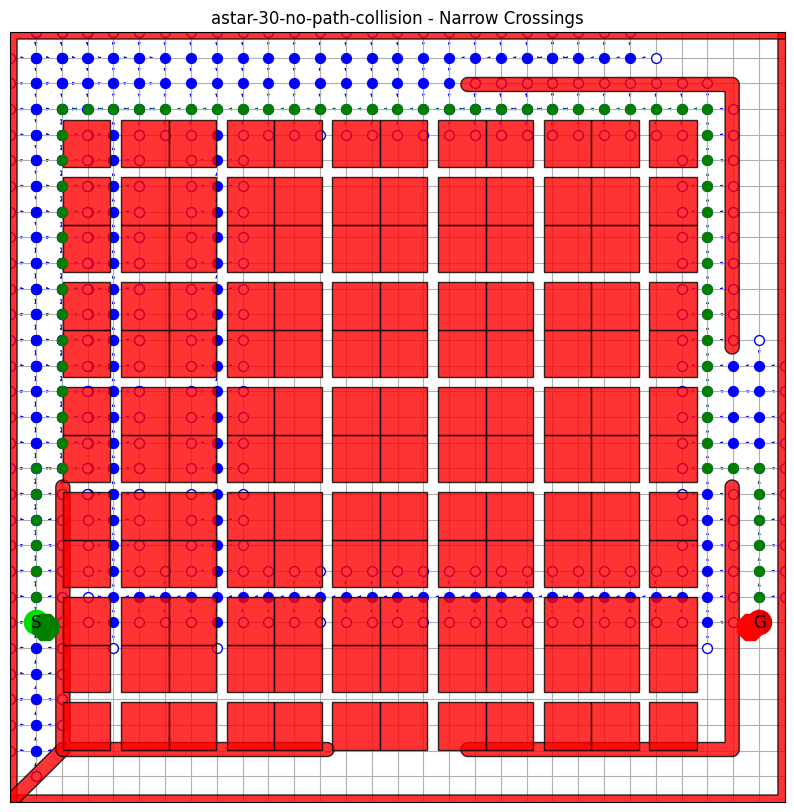

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.266666666666666, 0.7333333333333333]
Goal: [17.599999999999998, 17.599999999999998]


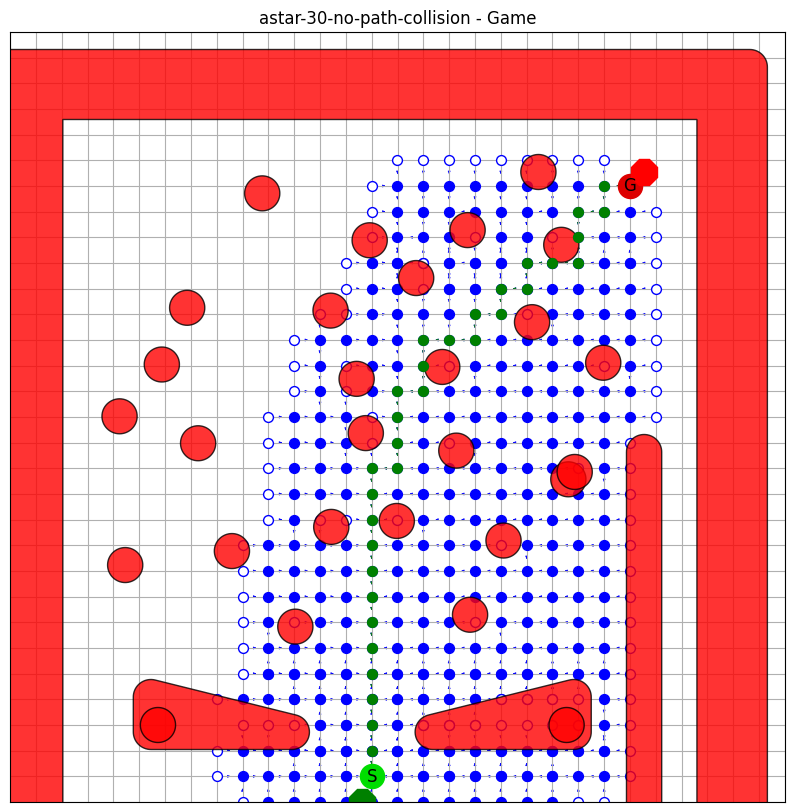

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.12, 9.68]
Goal: [10.12, 5.28]


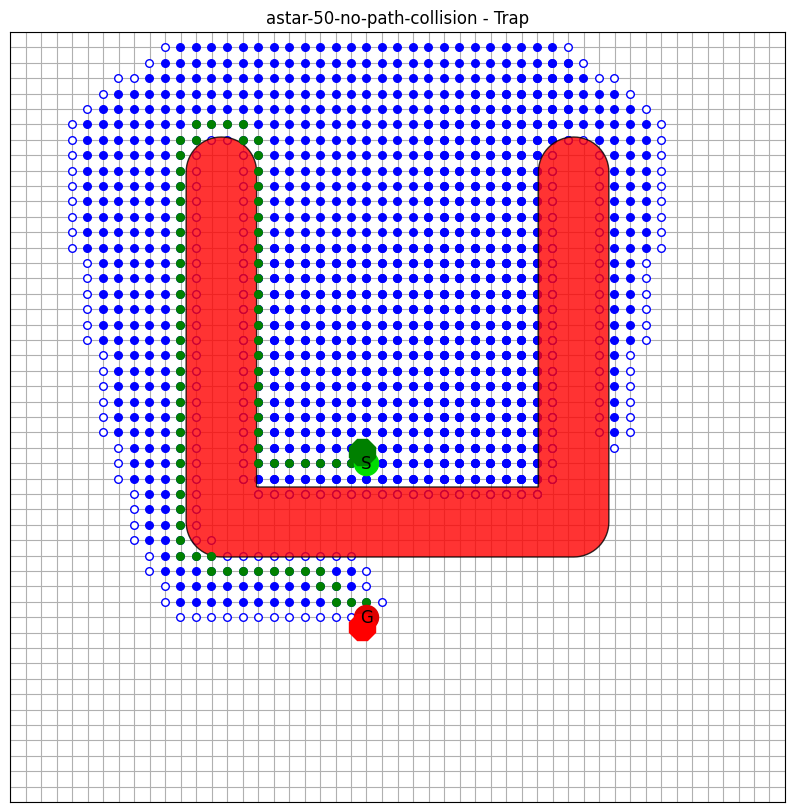

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.4, 14.96]
Goal: [17.6, 3.08]


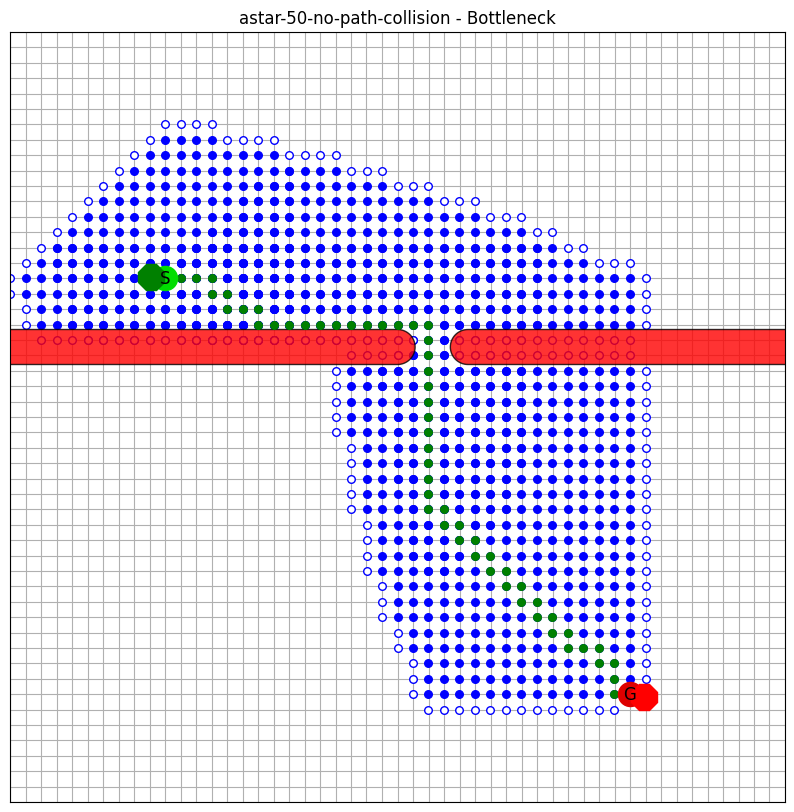

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.4, 17.6]
Goal: [17.6, 3.08]


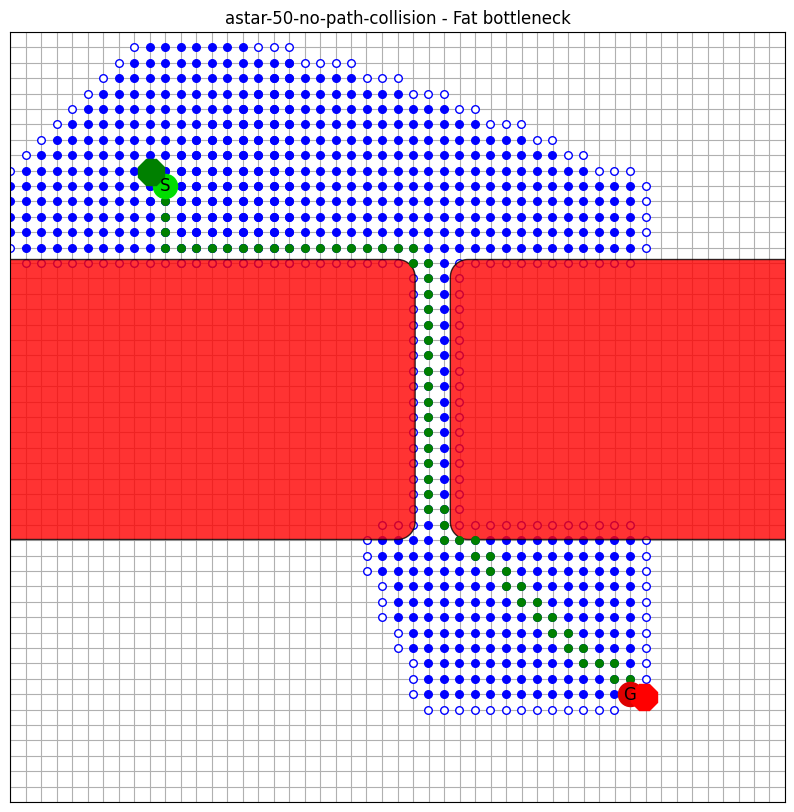

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.08, 11.0]
Goal: [17.6, 3.08]


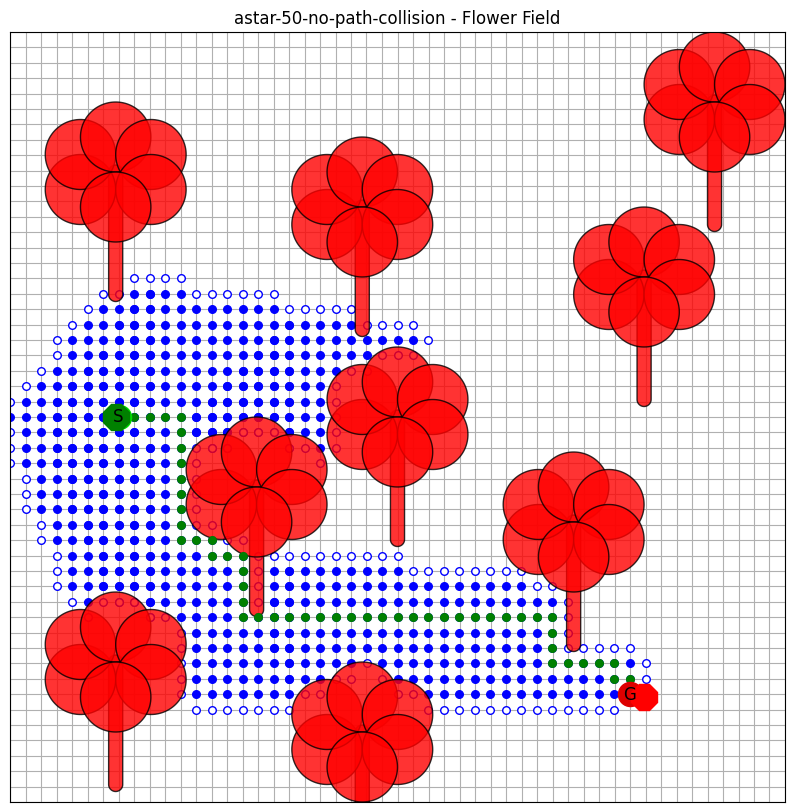

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.32, 10.12]
Goal: [12.32, 1.32]


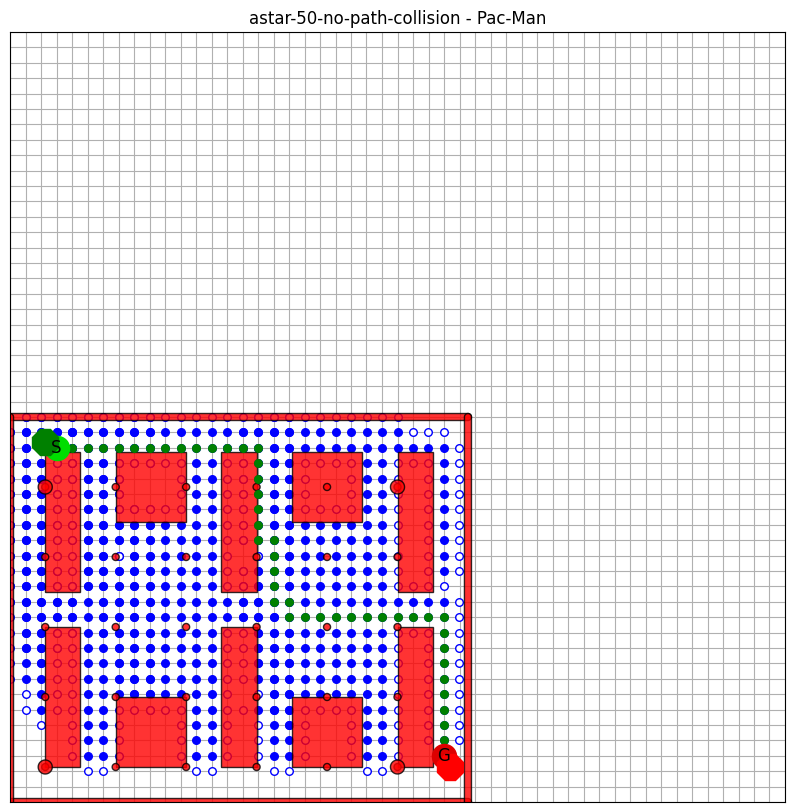

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.28, 5.28]
Goal: [19.8, 19.8]


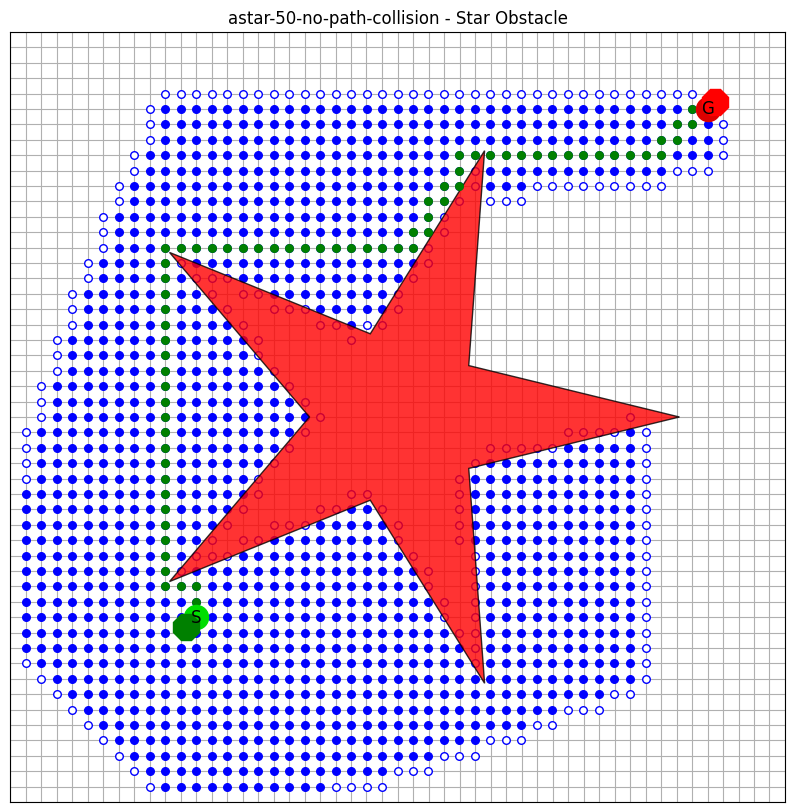

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.4, 4.4]
Goal: [19.8, 19.8]


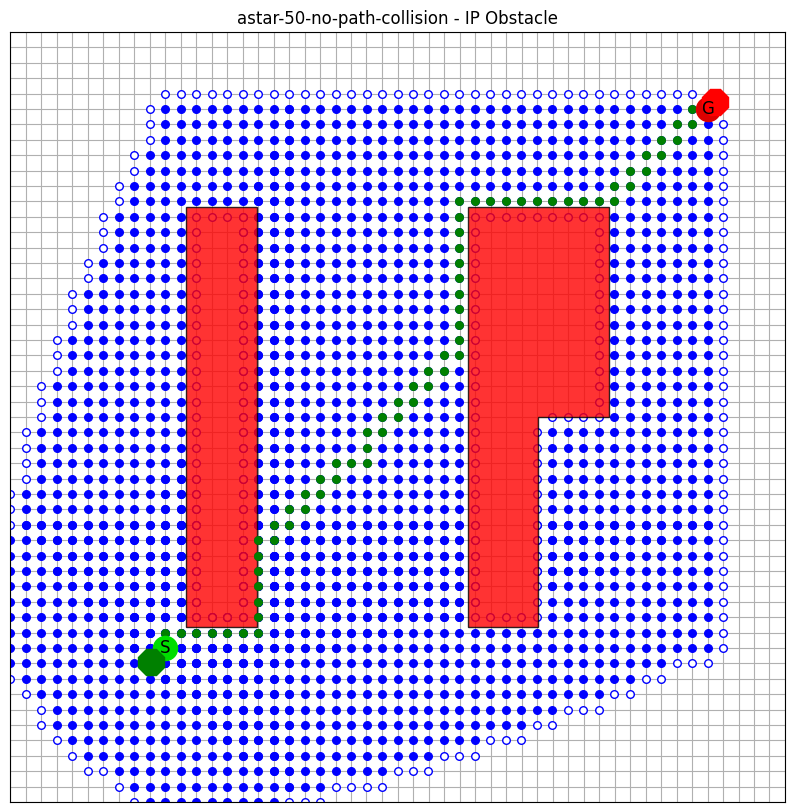

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.2]
Goal: [11.0, 19.8]


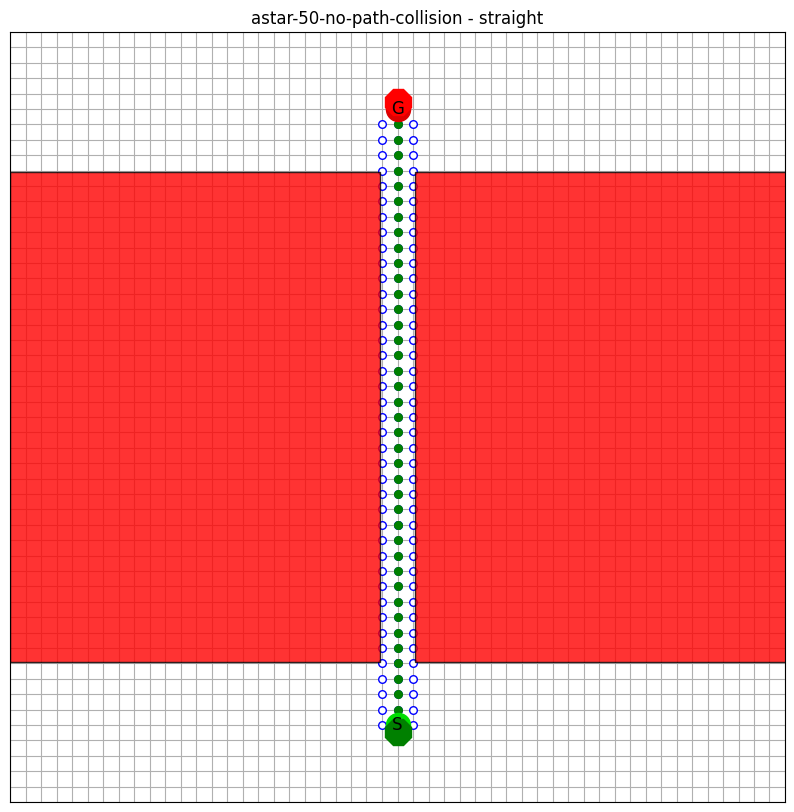

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.44, 0.44]
Goal: [19.8, 19.8]


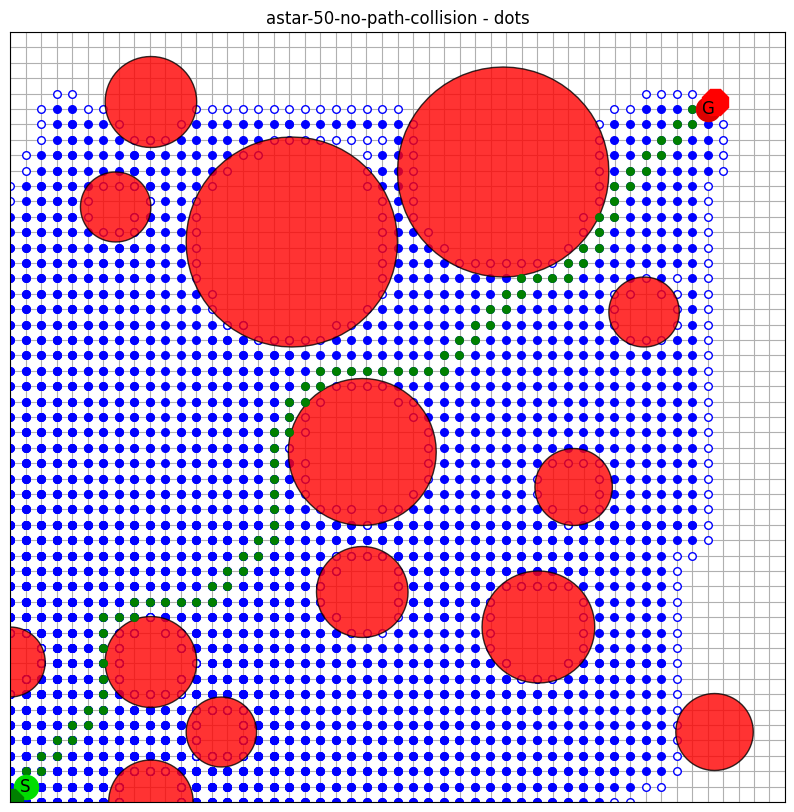

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [0.88, 4.84]
Goal: [21.12, 4.84]


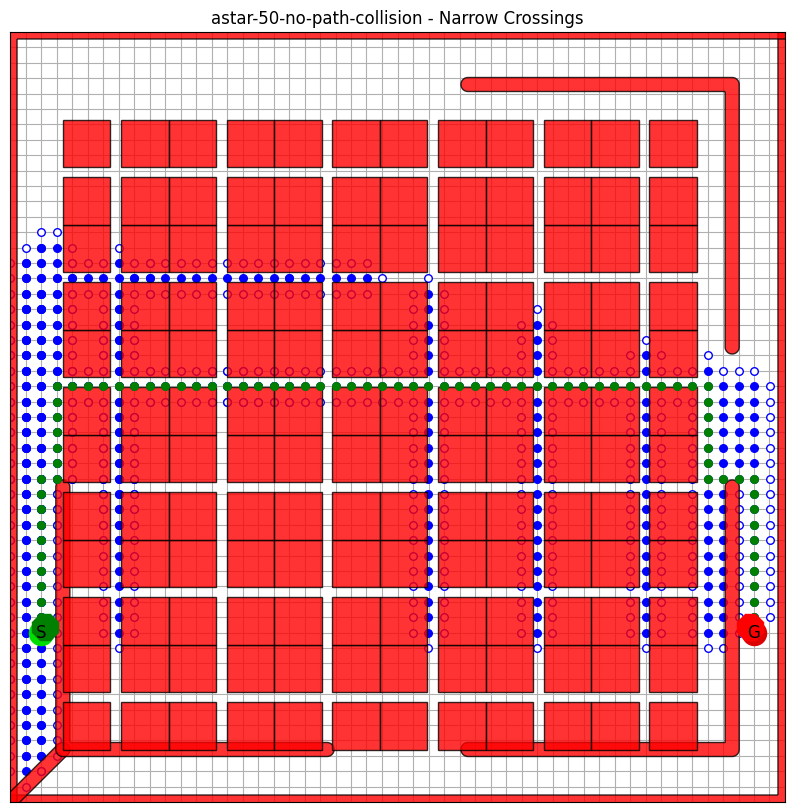

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.12, 0.44]
Goal: [17.6, 17.6]


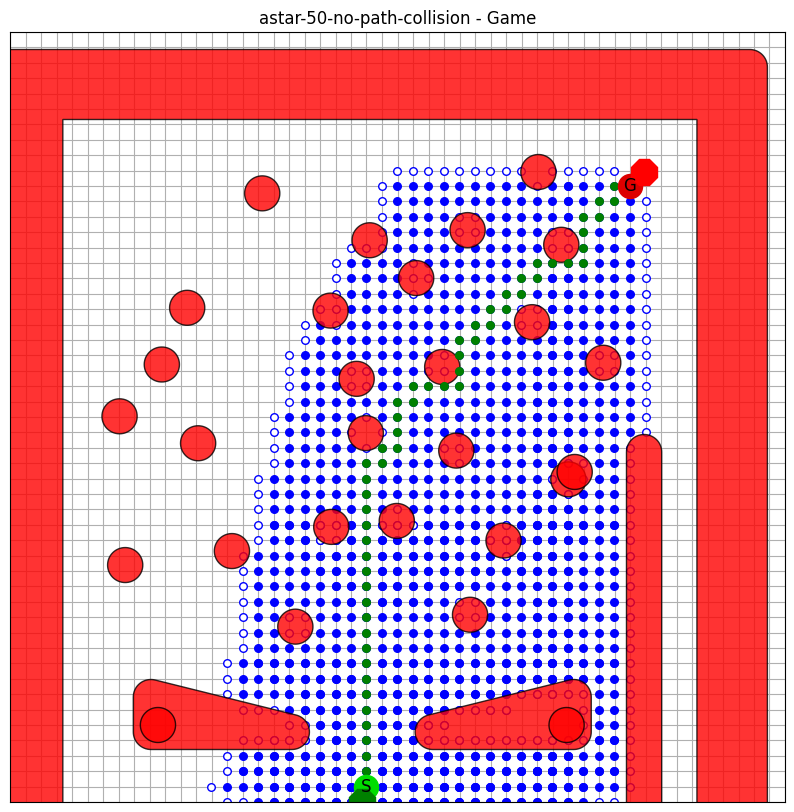

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [9.9, 9.9]
Goal: [9.9, 5.06]


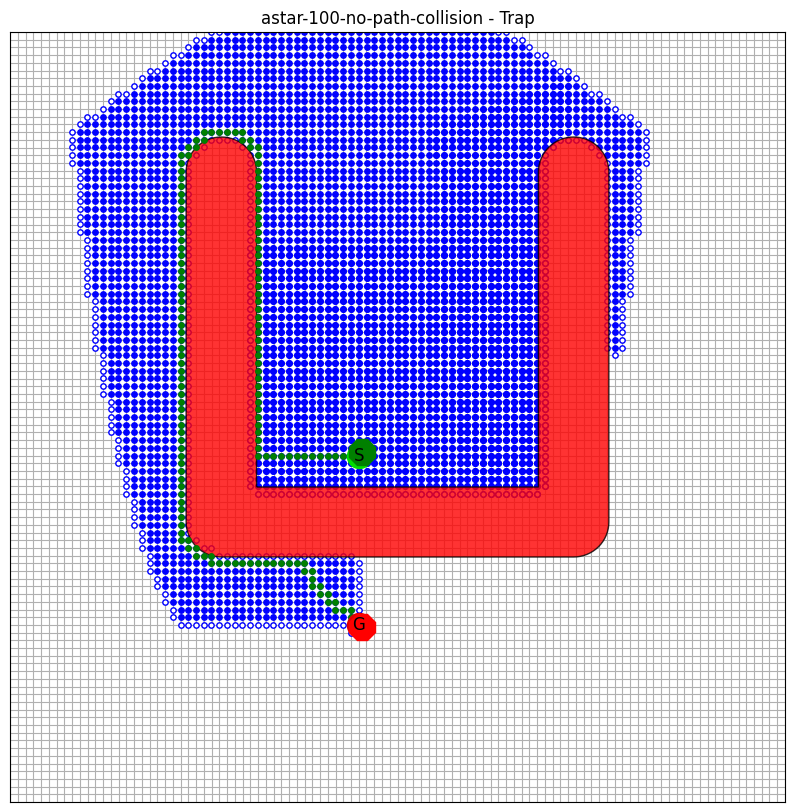

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.18, 14.96]
Goal: [17.82, 3.08]


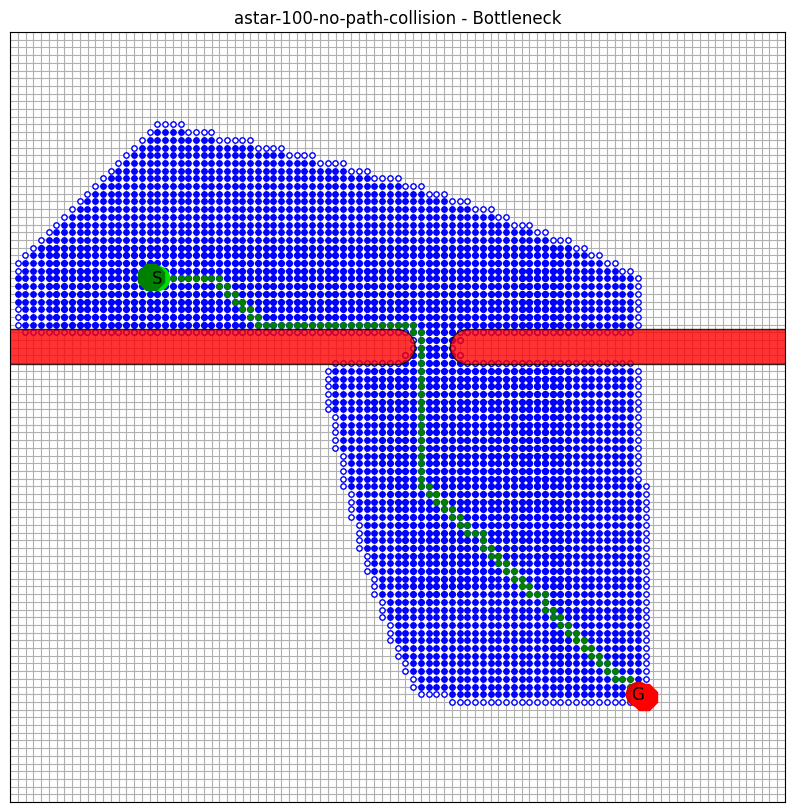

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.18, 17.82]
Goal: [17.82, 3.08]


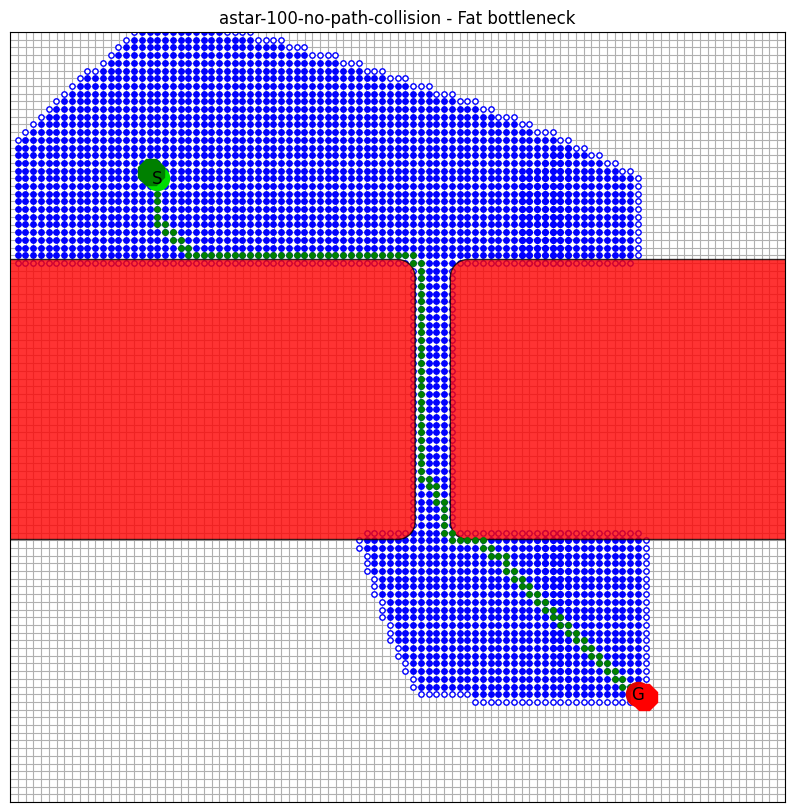

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [3.08, 11.0]
Goal: [17.82, 3.08]


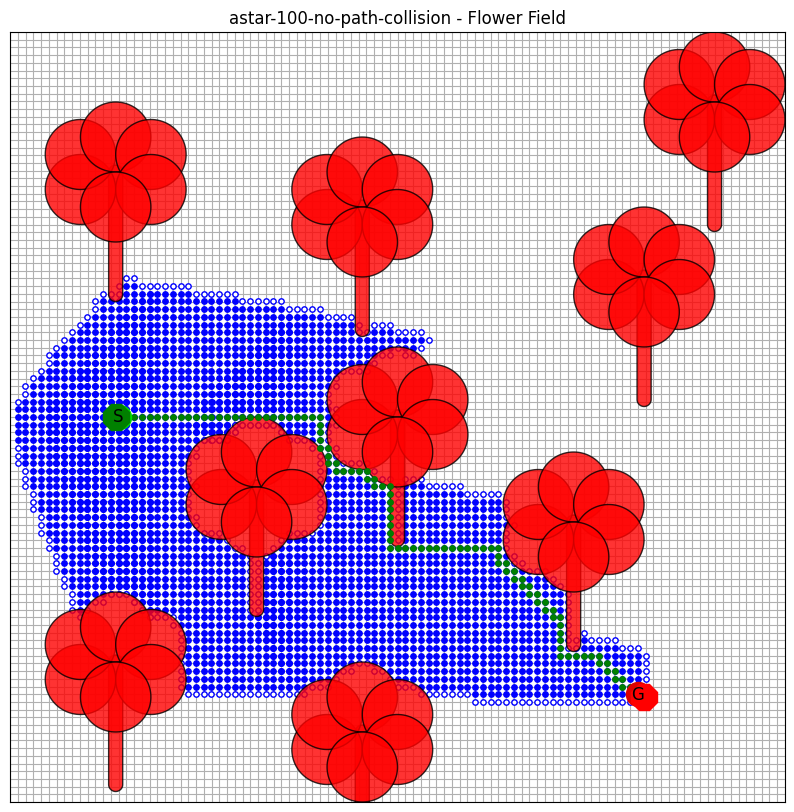

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]
Start: [1.1, 10.12]
Goal: [12.32, 1.1]


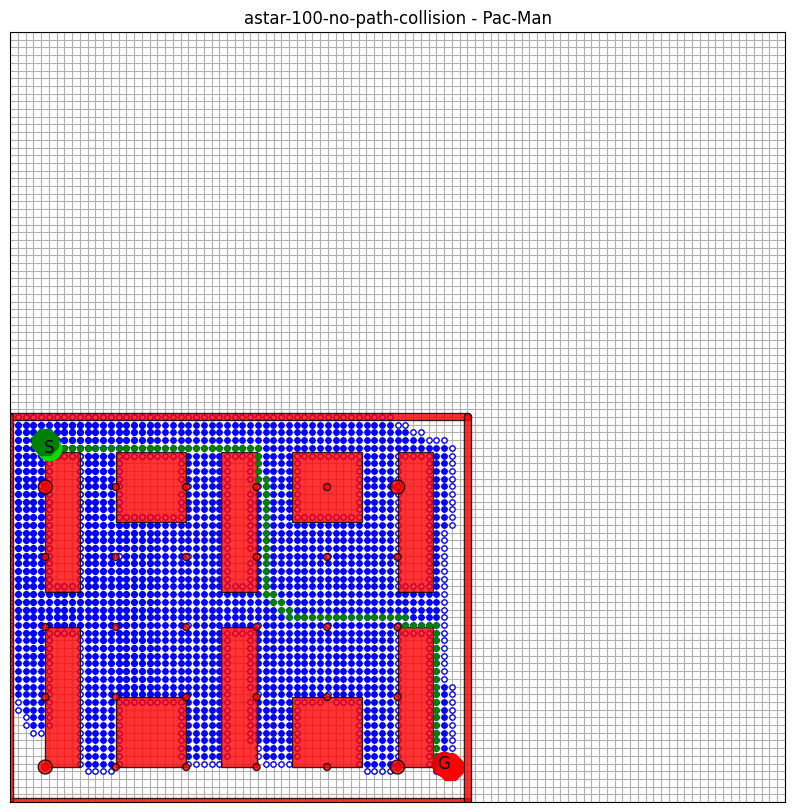

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [5.06, 5.06]
Goal: [19.8, 19.8]


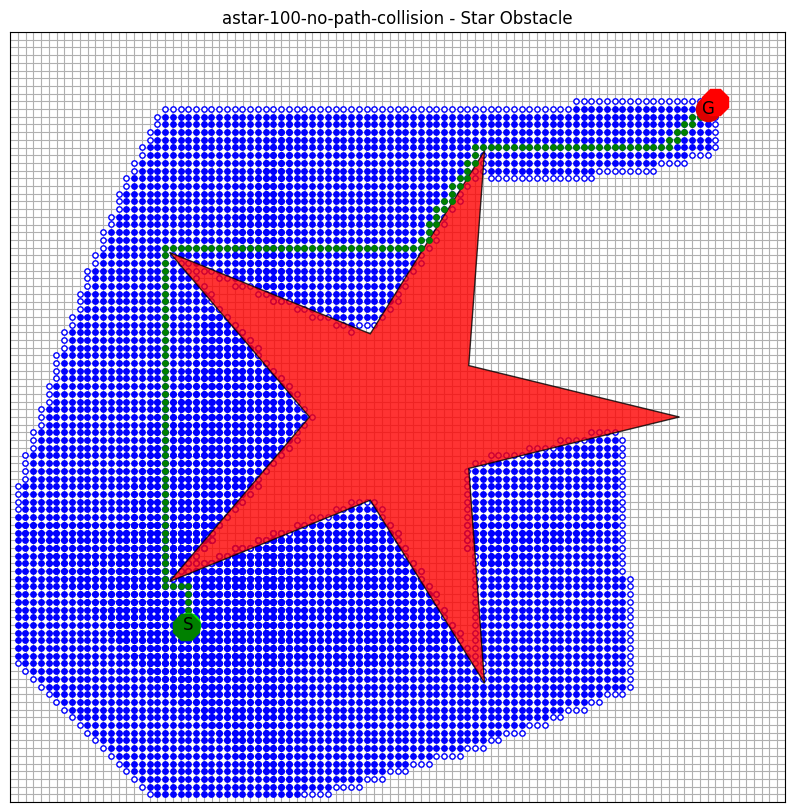

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.18, 4.18]
Goal: [19.8, 19.8]


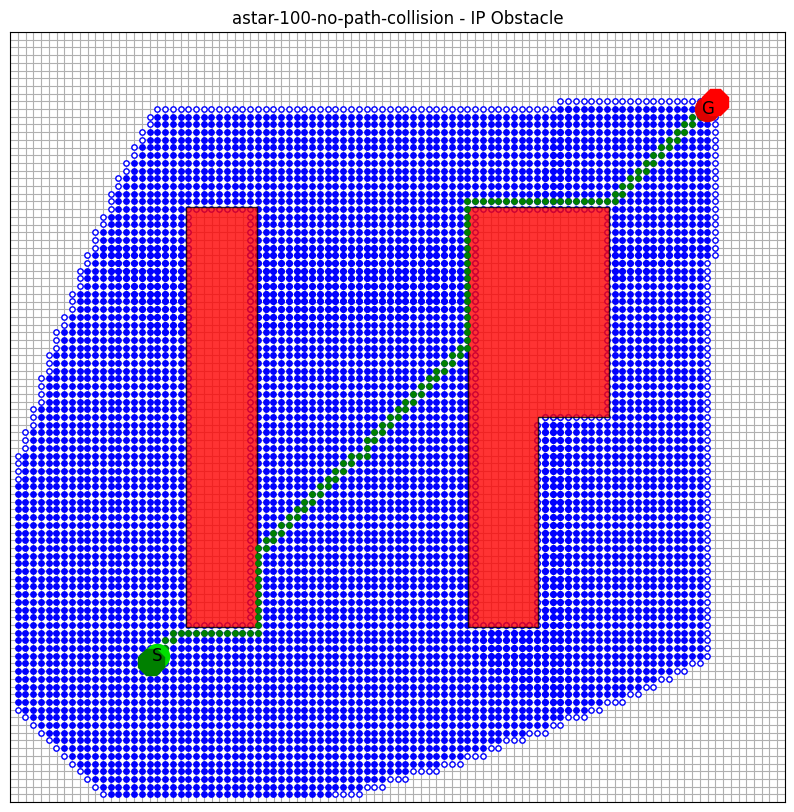

Initial start: [11, 2]
Initial goal: [11, 20]
Start: [11.0, 2.2]
Goal: [11.0, 19.8]


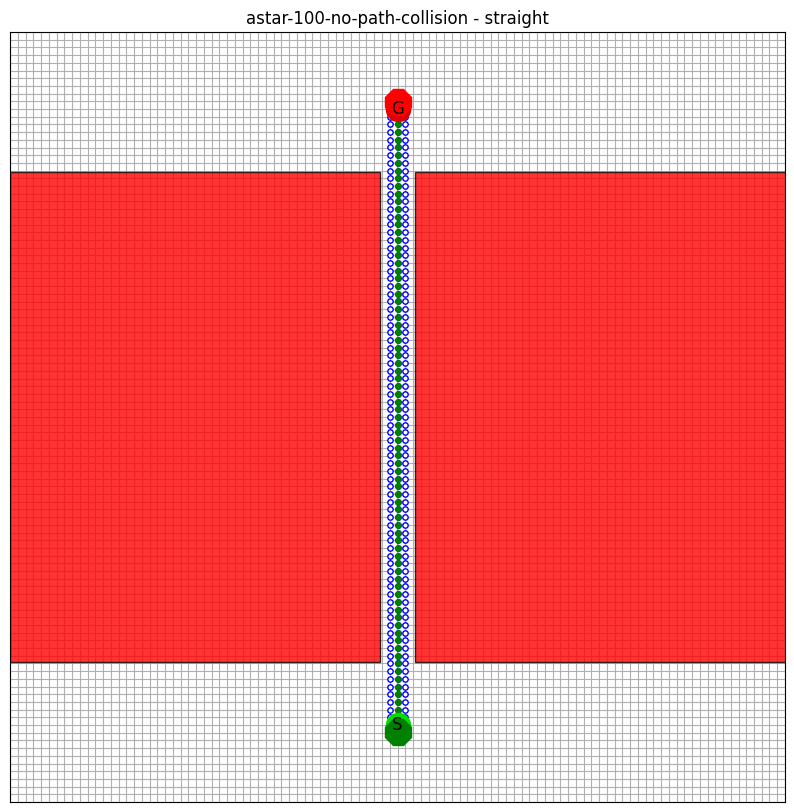

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [0.22, 0.22]
Goal: [19.8, 19.8]


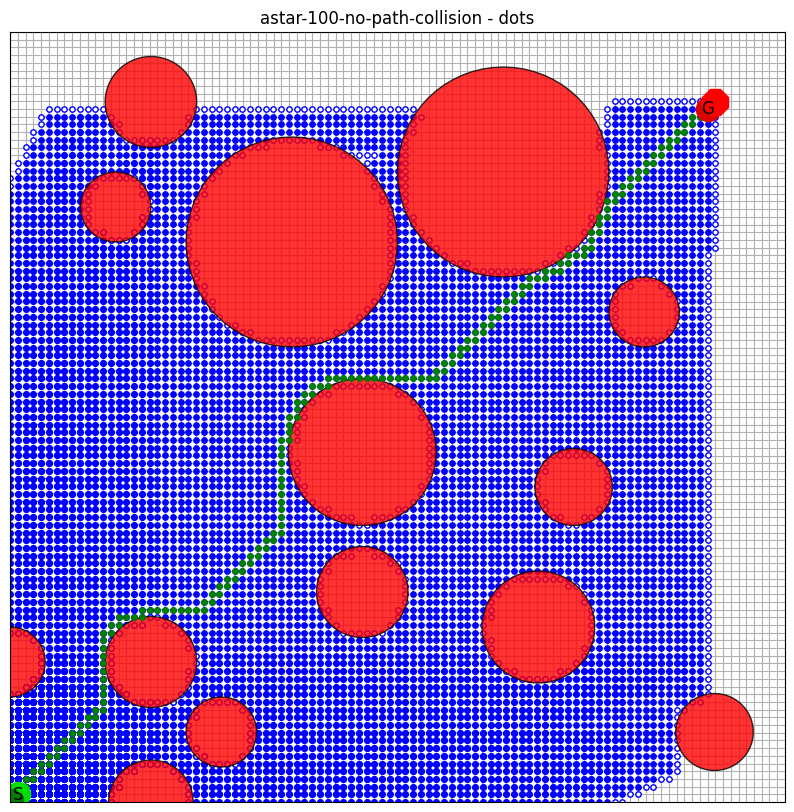

Initial start: [1.0, 5]
Initial goal: [21, 5.0]
Start: [1.1, 5.06]
Goal: [20.9, 5.06]


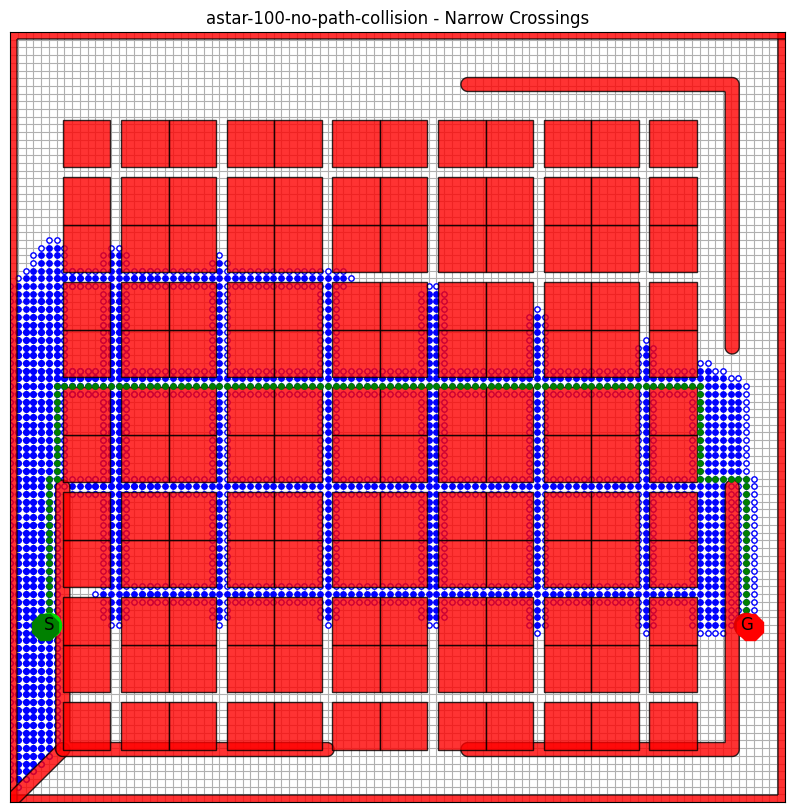

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.12, 0.22]
Goal: [17.82, 17.82]


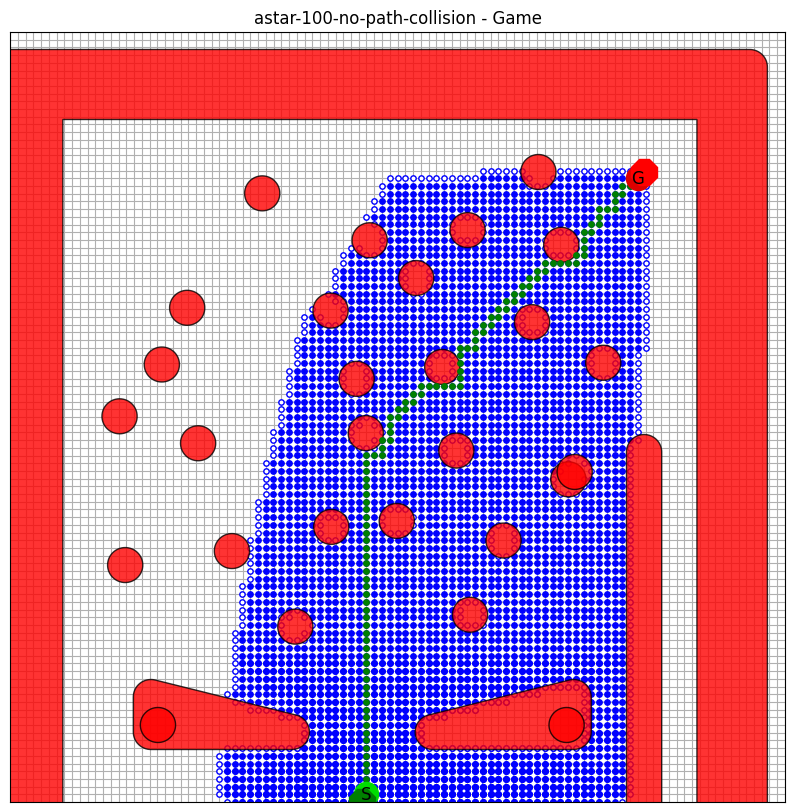

Initial start: [10, 10]
Initial goal: [10, 5]
Start: [10.0, 10.0]
Goal: [10.0, 5.0]


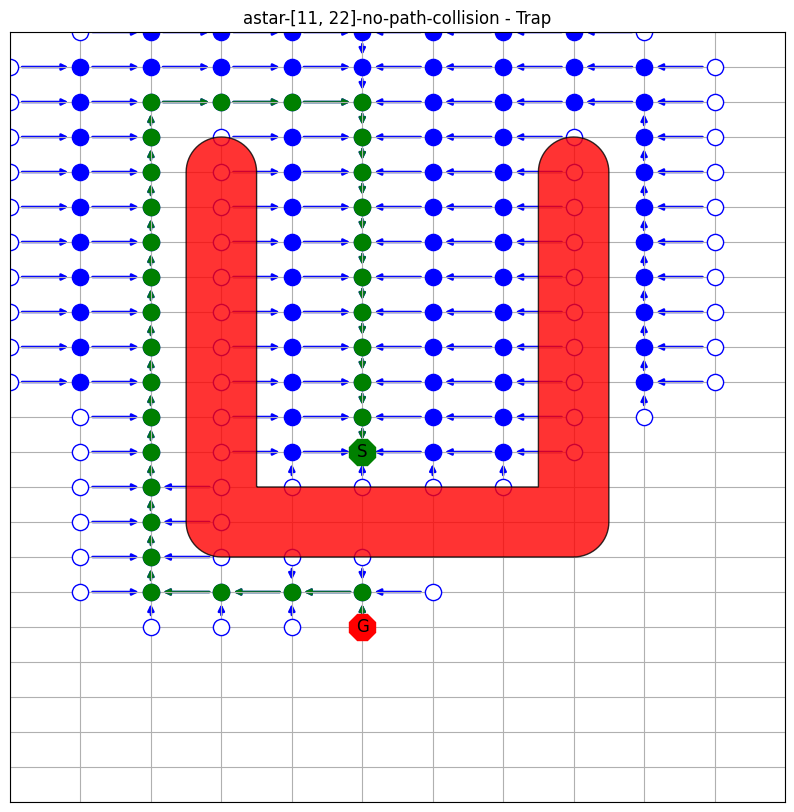

Initial start: [4, 15]
Initial goal: [18, 3]
Start: [4.0, 15.0]
Goal: [16.0, 3.0]


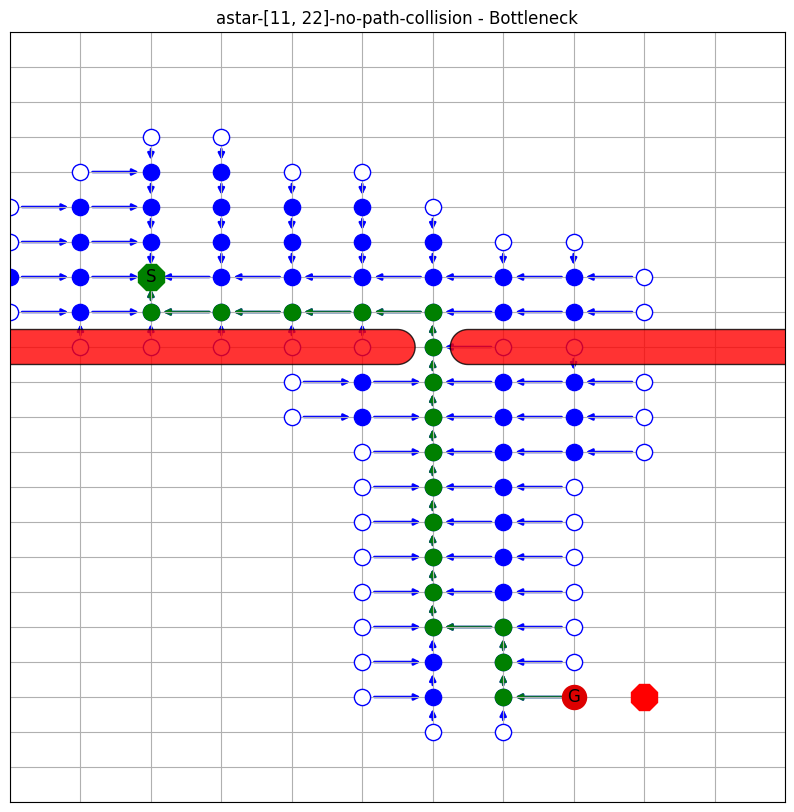

Initial start: [4, 18]
Initial goal: [18, 3]
Start: [4.0, 18.0]
Goal: [16.0, 3.0]


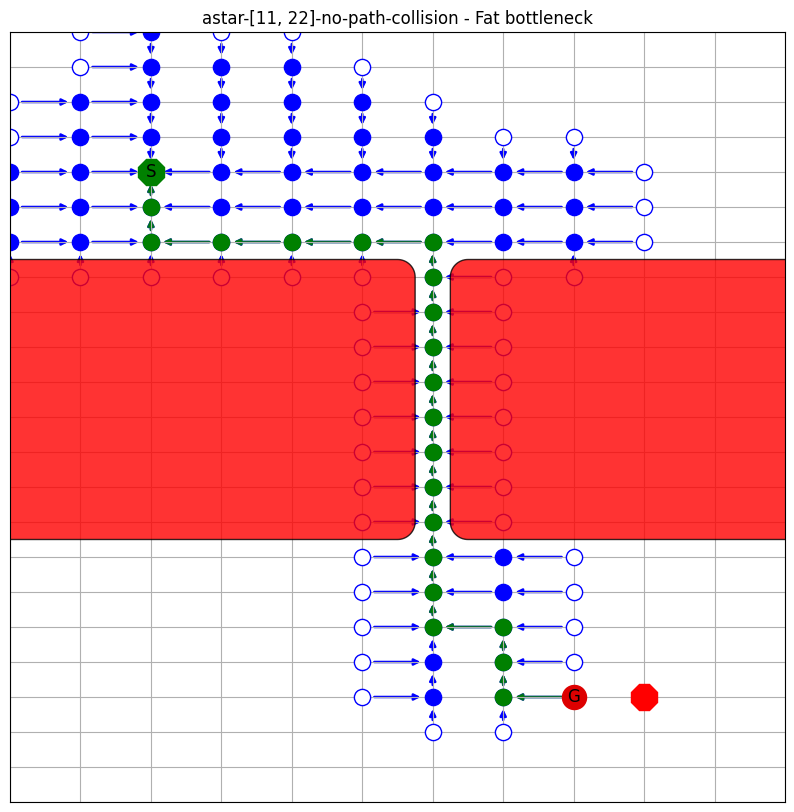

Initial start: [3, 11]
Initial goal: [18, 3]
Start: [4.0, 11.0]
Goal: [16.0, 3.0]


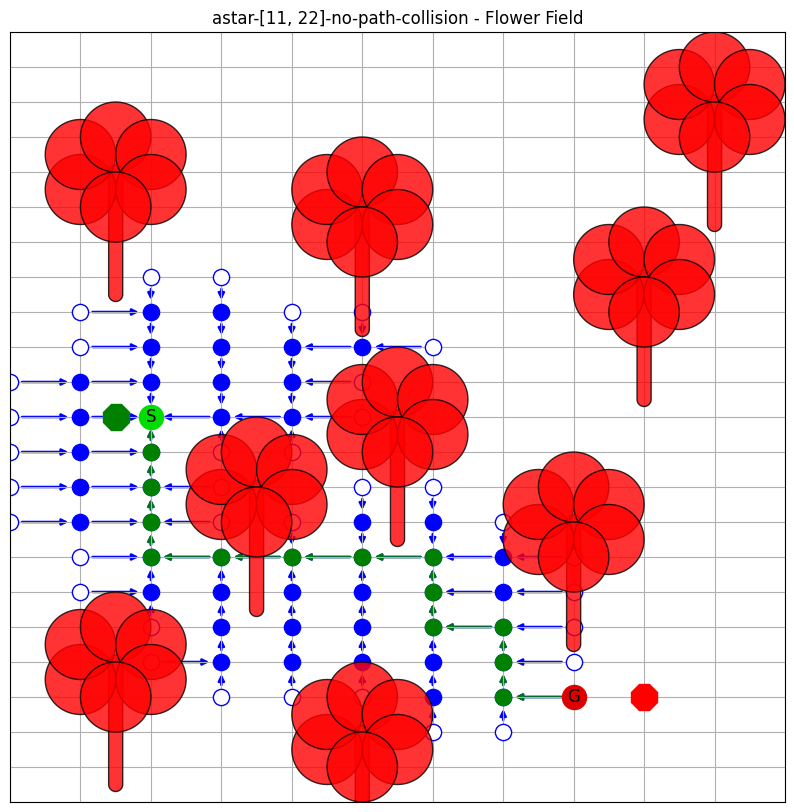

Initial start: [1.0, 10.3]
Initial goal: [12.5, 1]


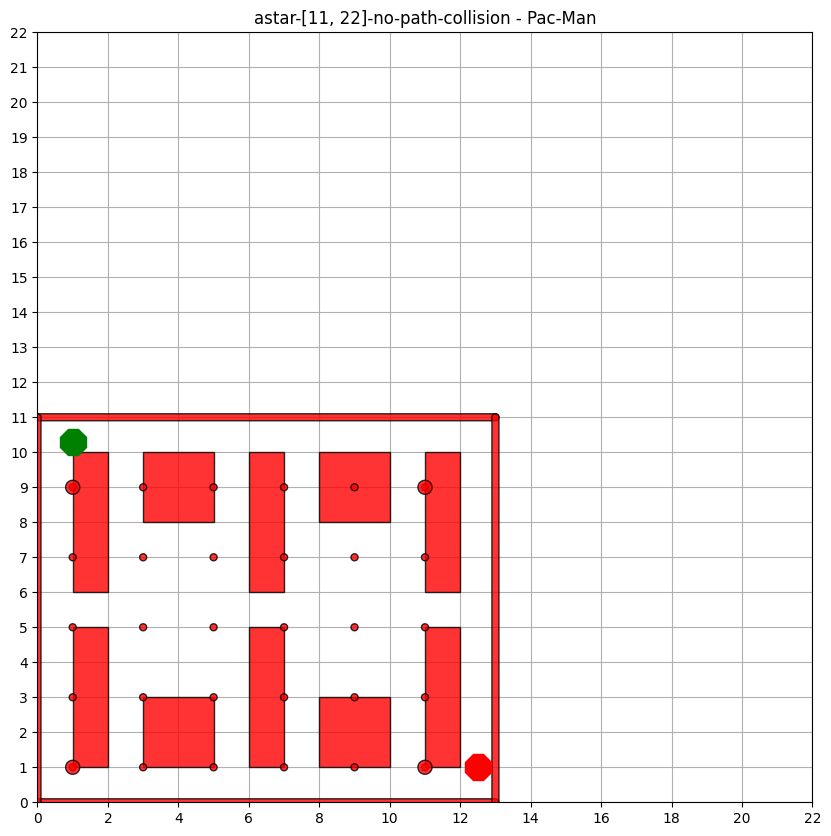

Initial start: [5, 5]
Initial goal: [20, 20]
Start: [6.0, 5.0]
Goal: [18.0, 19.0]


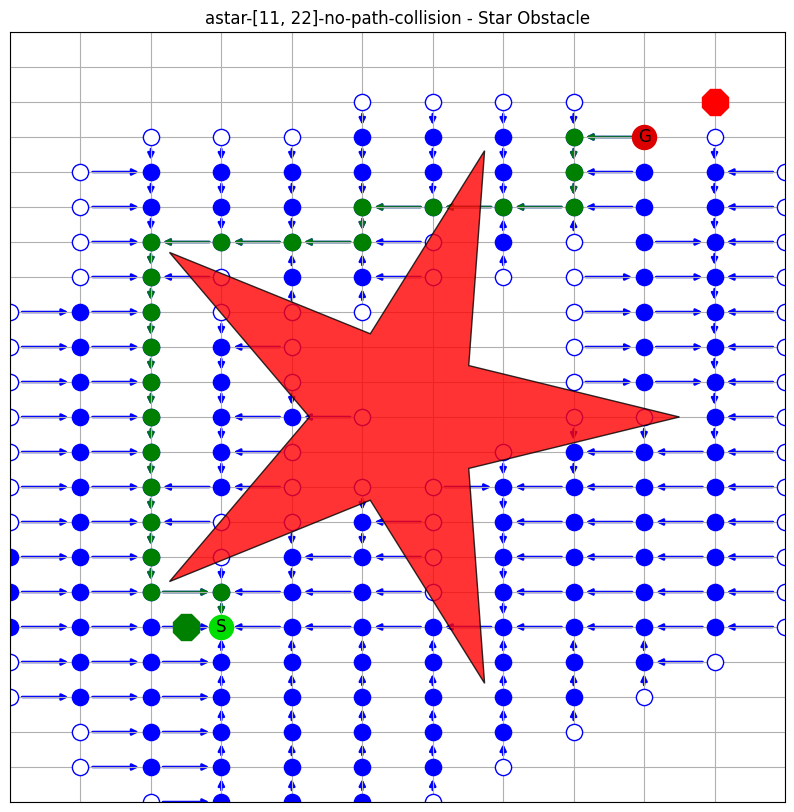

Initial start: [4, 4]
Initial goal: [20, 20]
Start: [4.0, 4.0]
Goal: [18.0, 19.0]


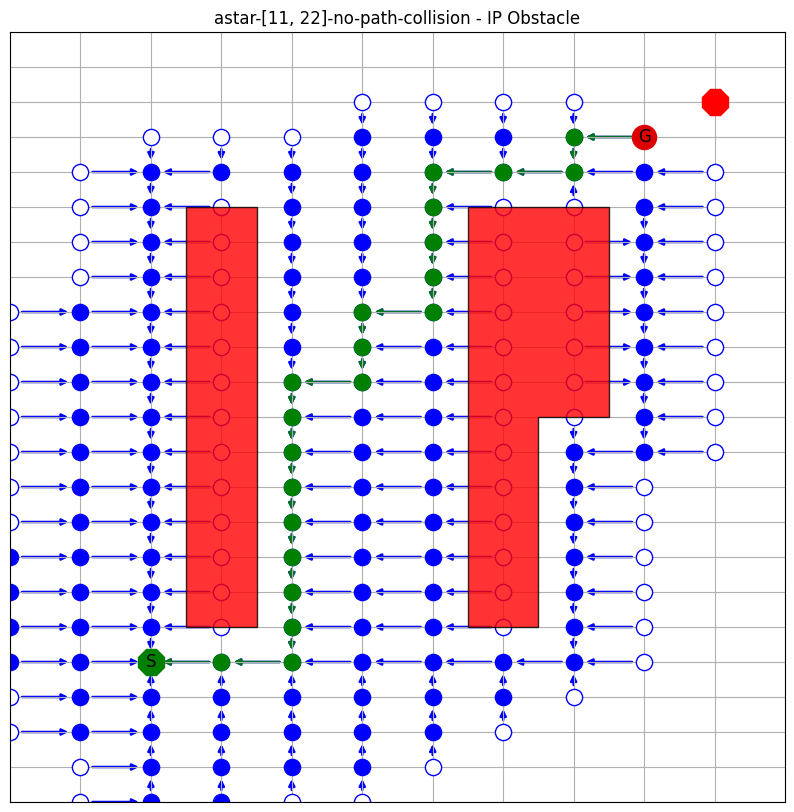

Initial start: [11, 2]
Initial goal: [11, 20]


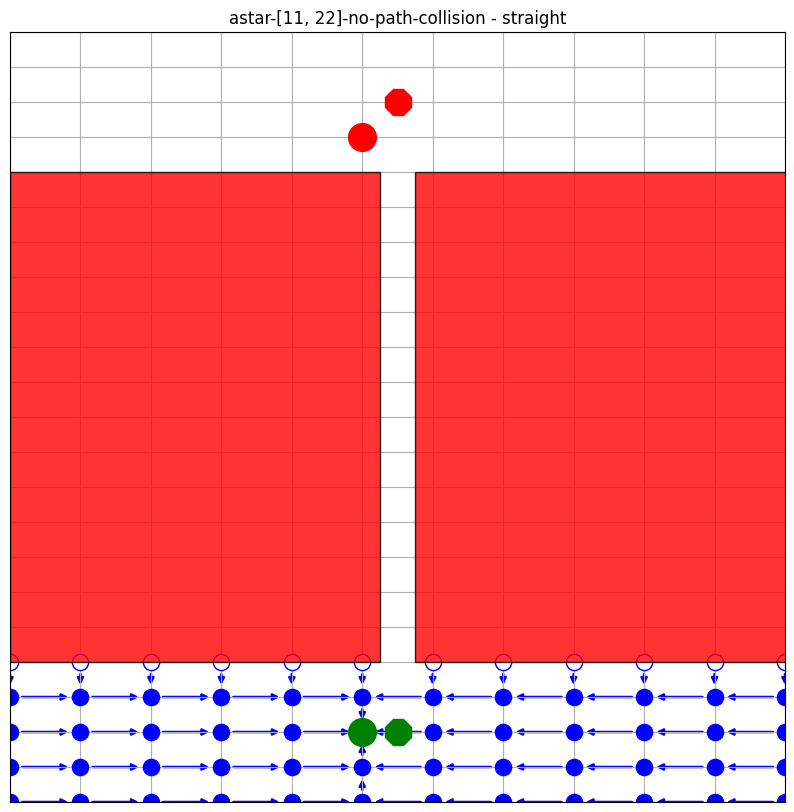

Initial start: [0, 0]
Initial goal: [20, 20]
Start: [2.0, 1.0]
Goal: [18.0, 19.0]


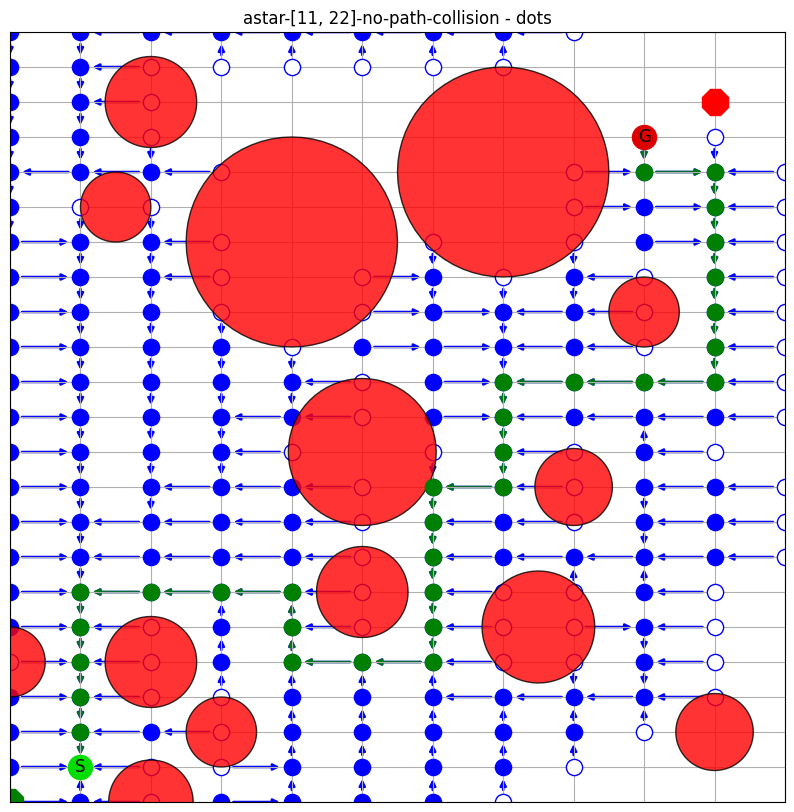

Initial start: [1.0, 5]
Initial goal: [21, 5.0]


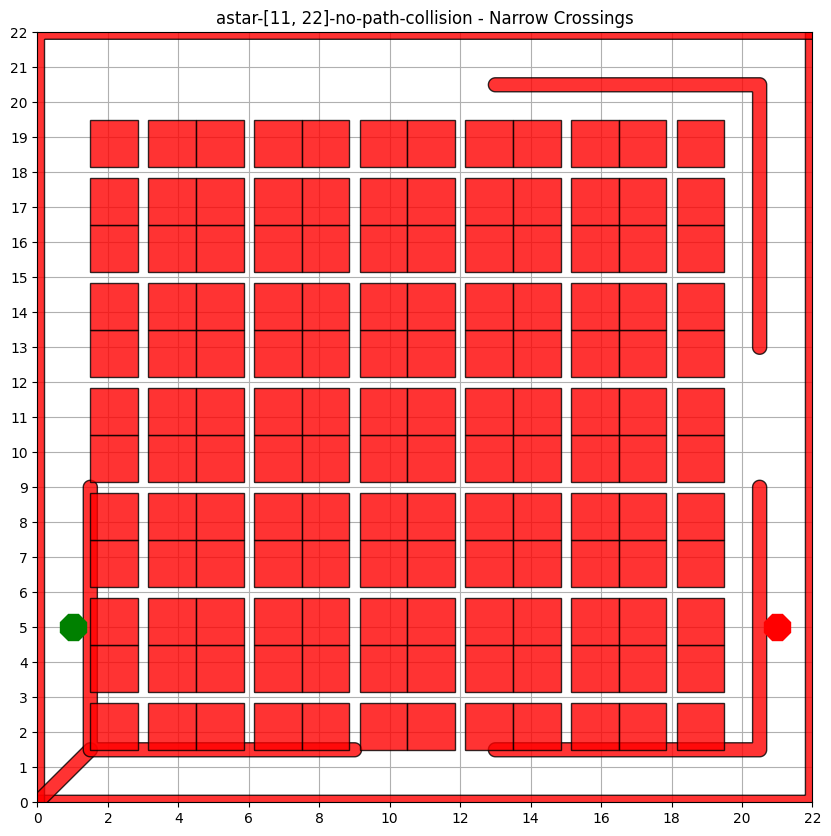

Initial start: [10, 0]
Initial goal: [18, 18]
Start: [10.0, 1.0]
Goal: [16.0, 18.0]


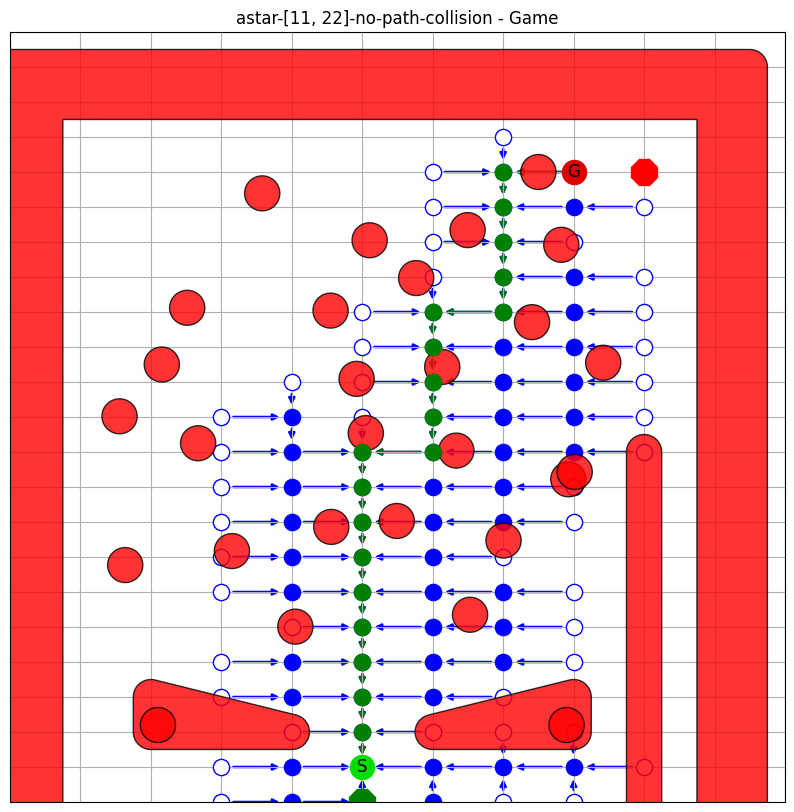

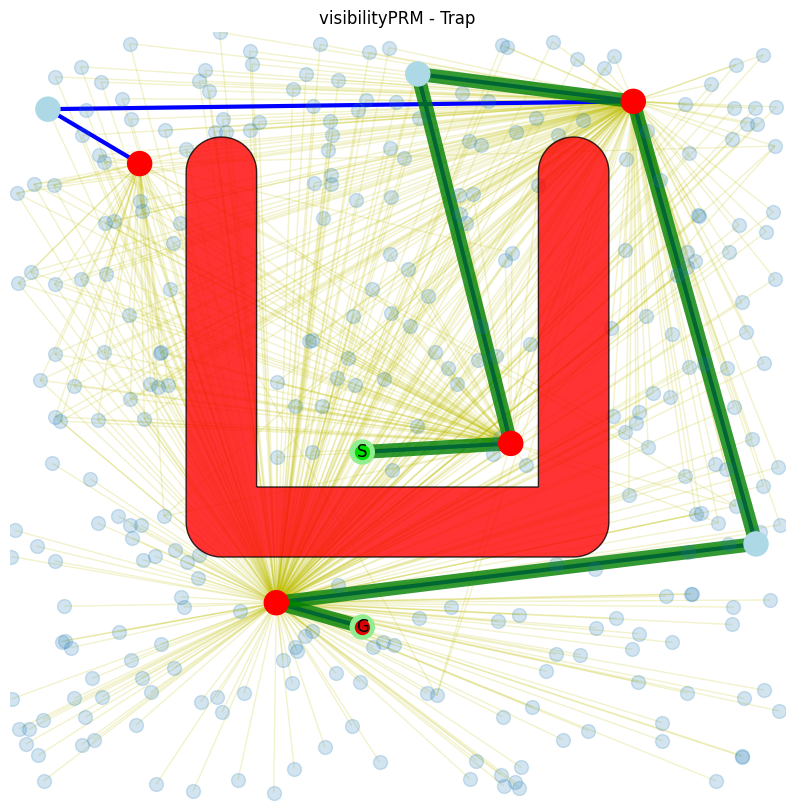

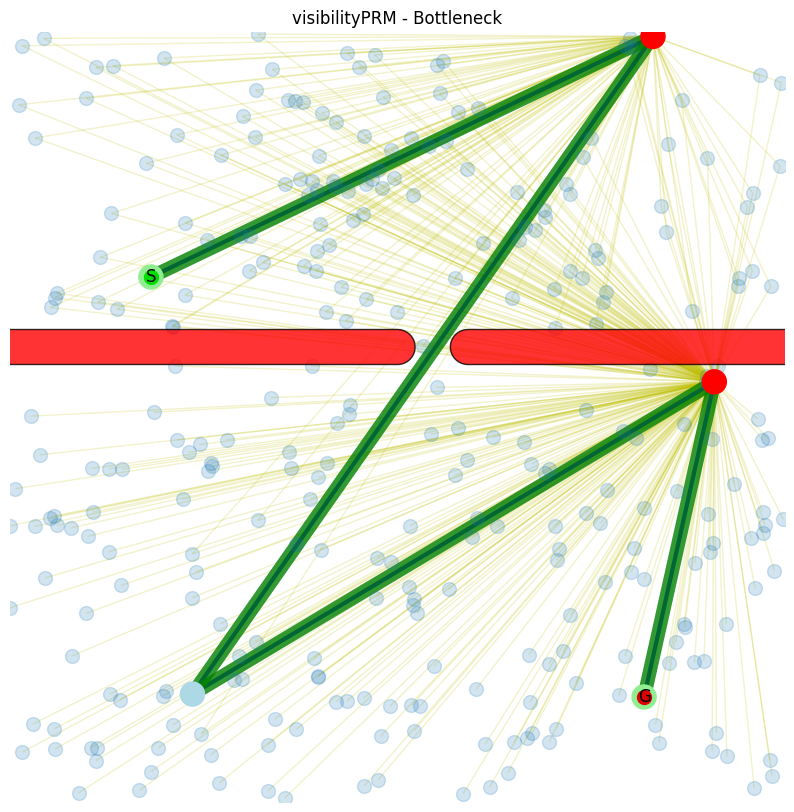

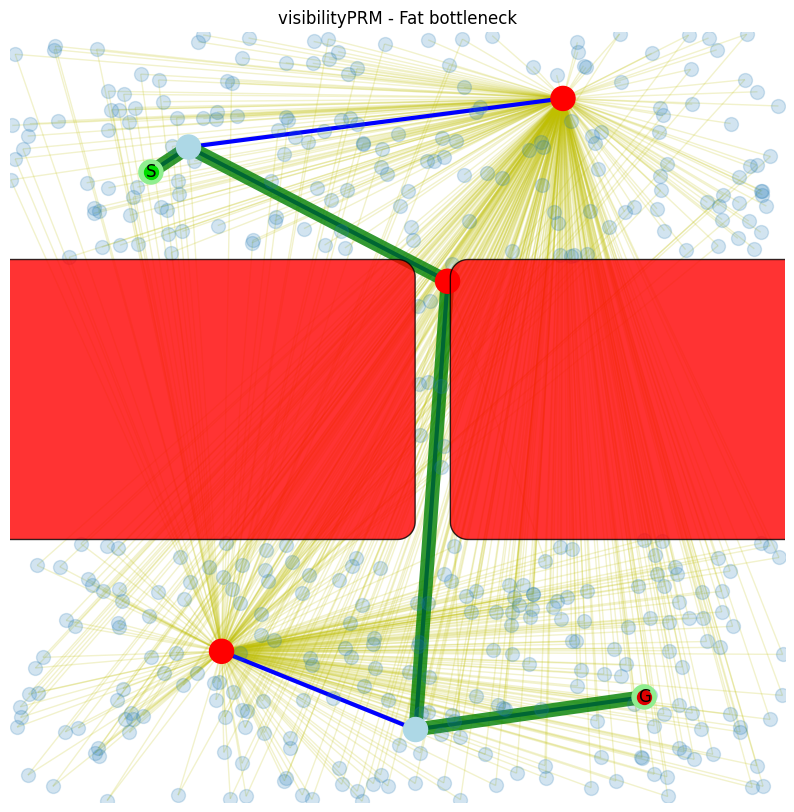

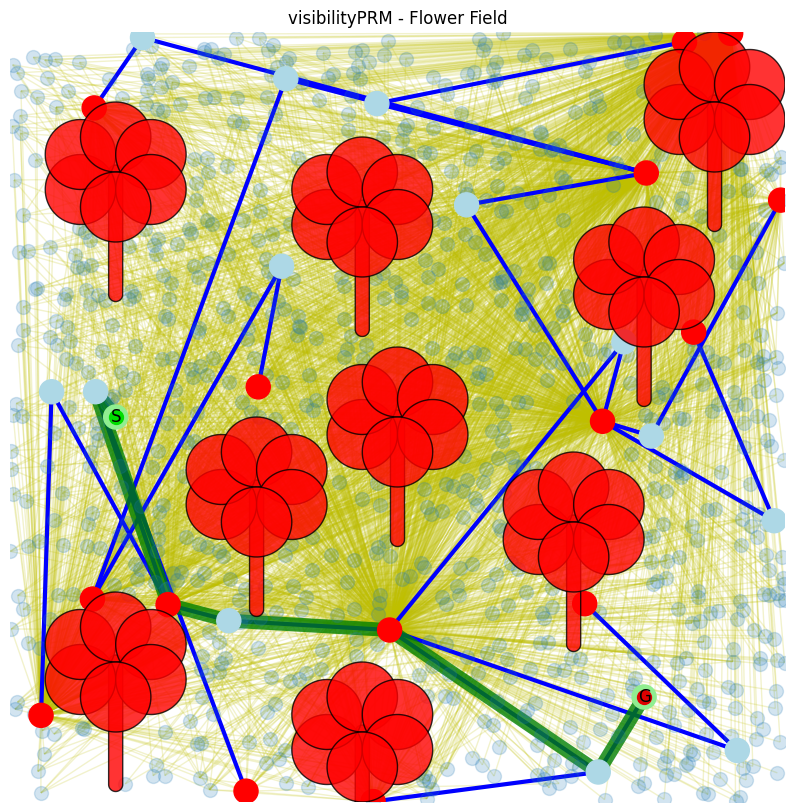

...

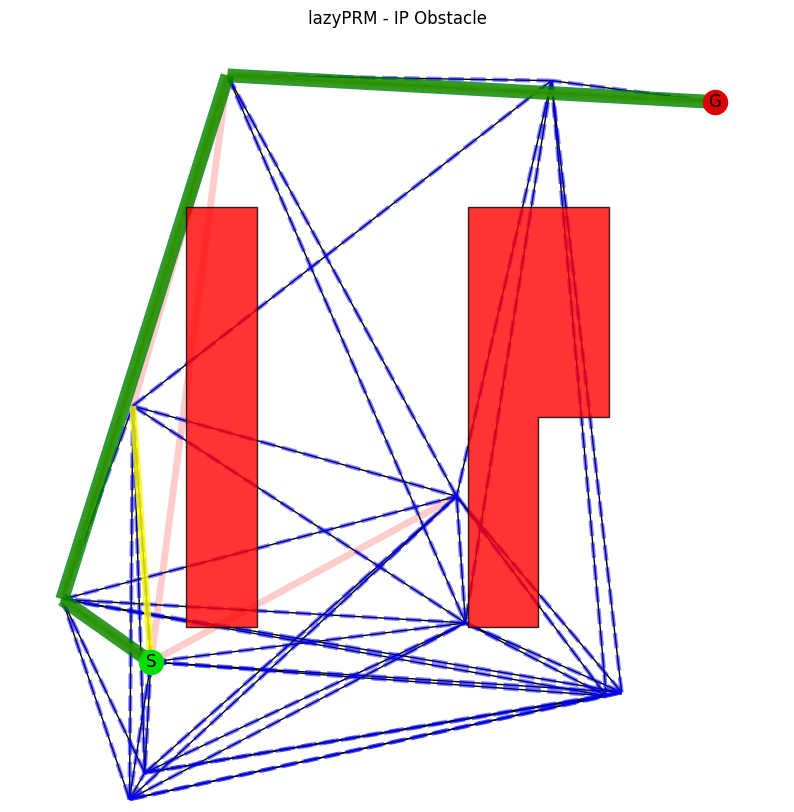

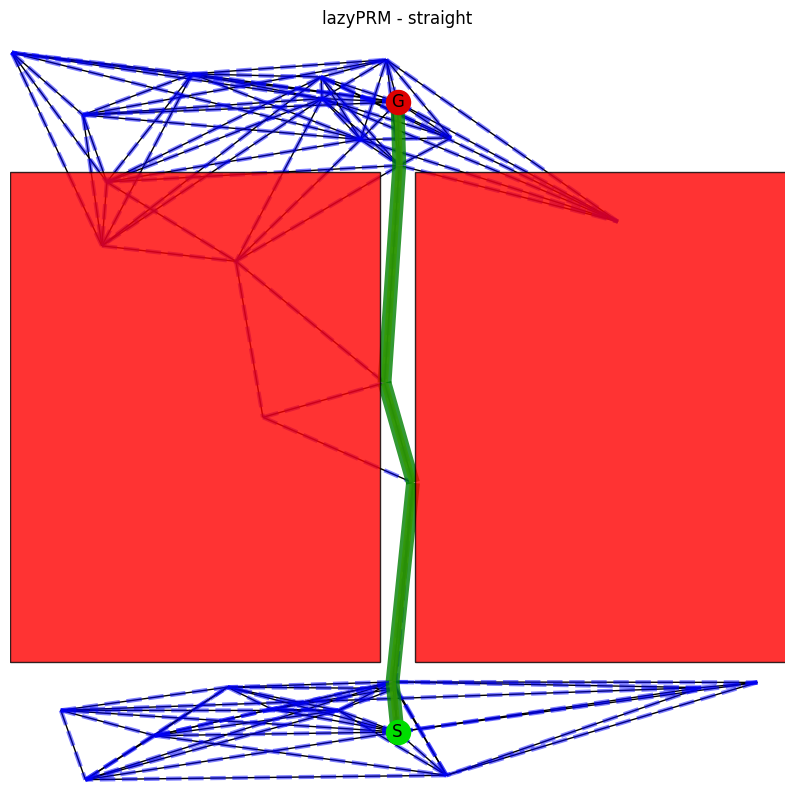

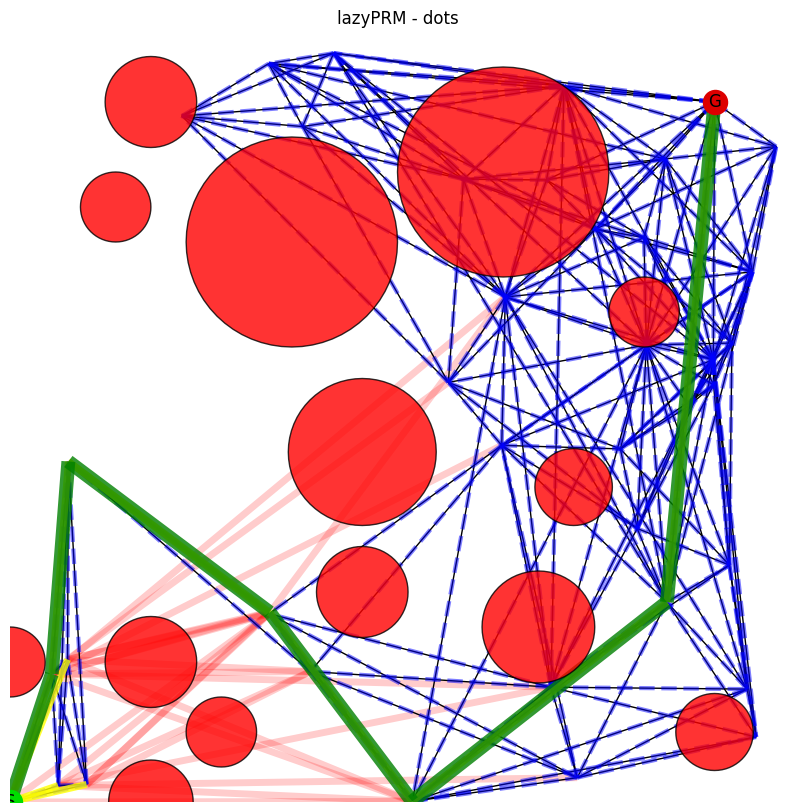

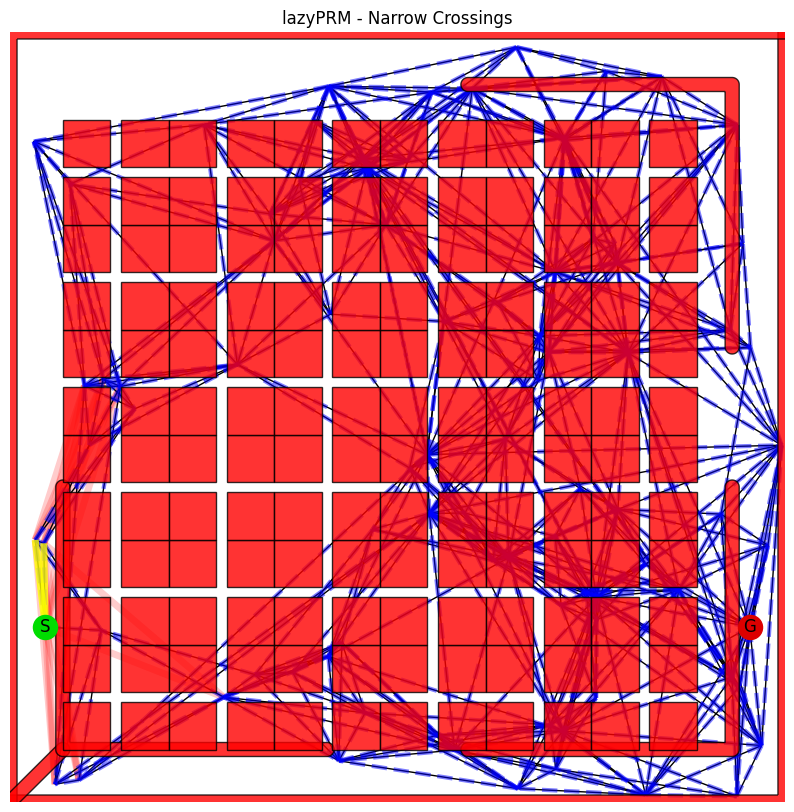

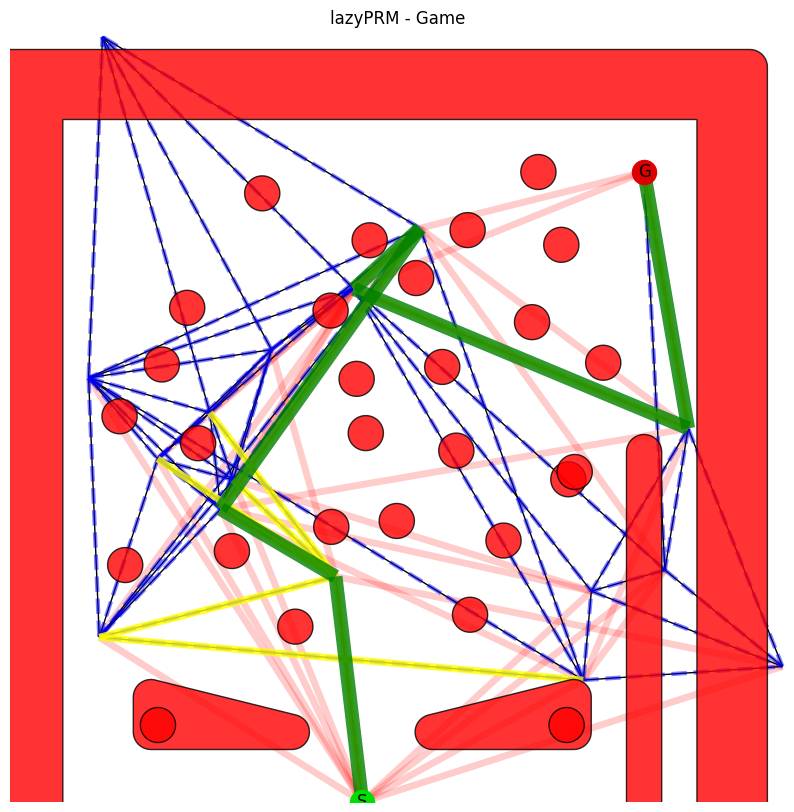

In [12]:

if export:
    os.makedirs("./export/graphs", exist_ok=True)

if visualize:
    for result in resultList:
        fig, ax = plt.subplots(figsize=(10,10))

        if "astar" in result.plannerFactoryName:
            ax.set_xlim(result.planner.limits[0])
            ax.set_ylim(result.planner.limits[1])
            ax.set_xticks(np.linspace(result.planner.limits[0][0], result.planner.limits[0][1], result.planner.n_steps[0] + 1))
            ax.set_yticks(np.linspace(result.planner.limits[1][0], result.planner.limits[1][1], result.planner.n_steps[1] + 1))
        else:
            ax.set_xlim([0, 22])
            ax.set_ylim([0, 22])
        
        ax.grid(True)
        ax.axis('on')
        
        title = result.plannerFactoryName + " - " + result.benchmark.name
        "\n Assumed complexity level " + str(result.benchmark.level)
        ax.set_title(title)
        
        plannerFactory[result.plannerFactoryName][2](result.planner, result.solution, ax=ax, nodeSize=100)
        plt.show()
        
        if export:
            fig.savefig(f"./export/graphs/{title}.png")    

# Evaluation

## Planner results

Diagrams for each test environment and planner.

Contains the following metrics
- Path length (amount of nodes)
- Planning time (read crossed if no path was found)
- Roadmap size
- Path distance (total euclidean distance)
- Success rate (=#paths founds / #environements)


In [13]:
# Options
visualize = True # plot diagrams
export = False   # export diagrams to "./export/statistics"

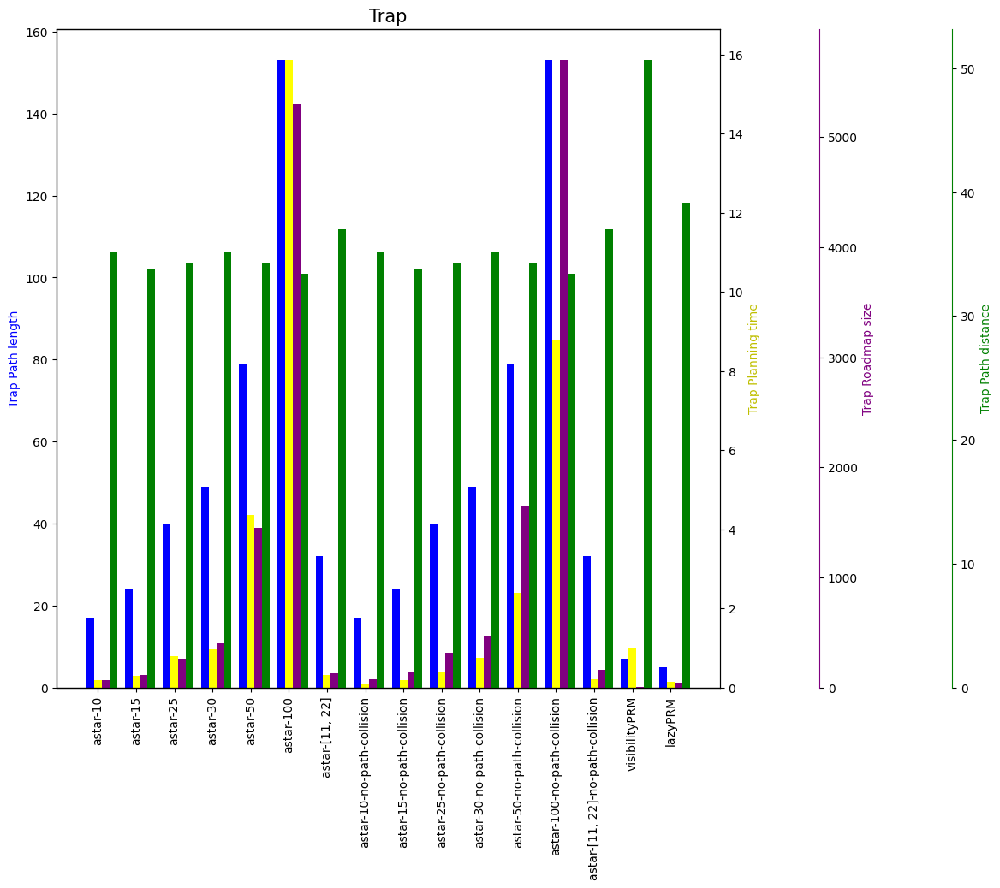

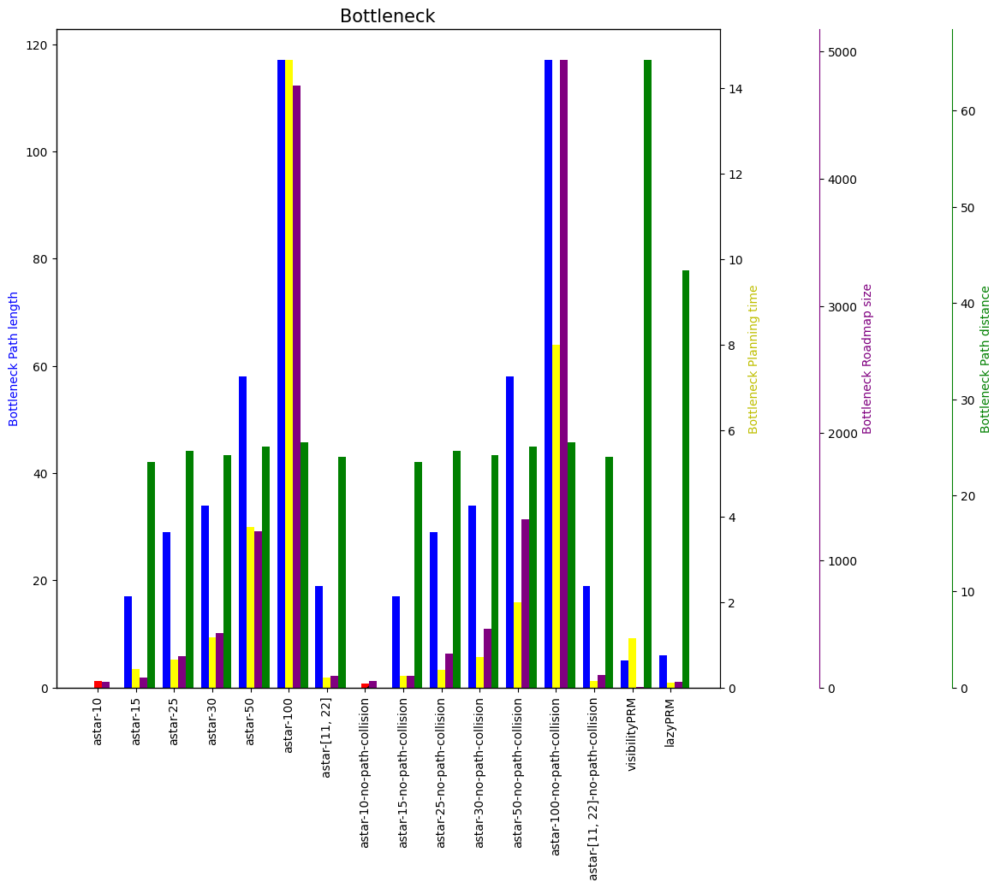

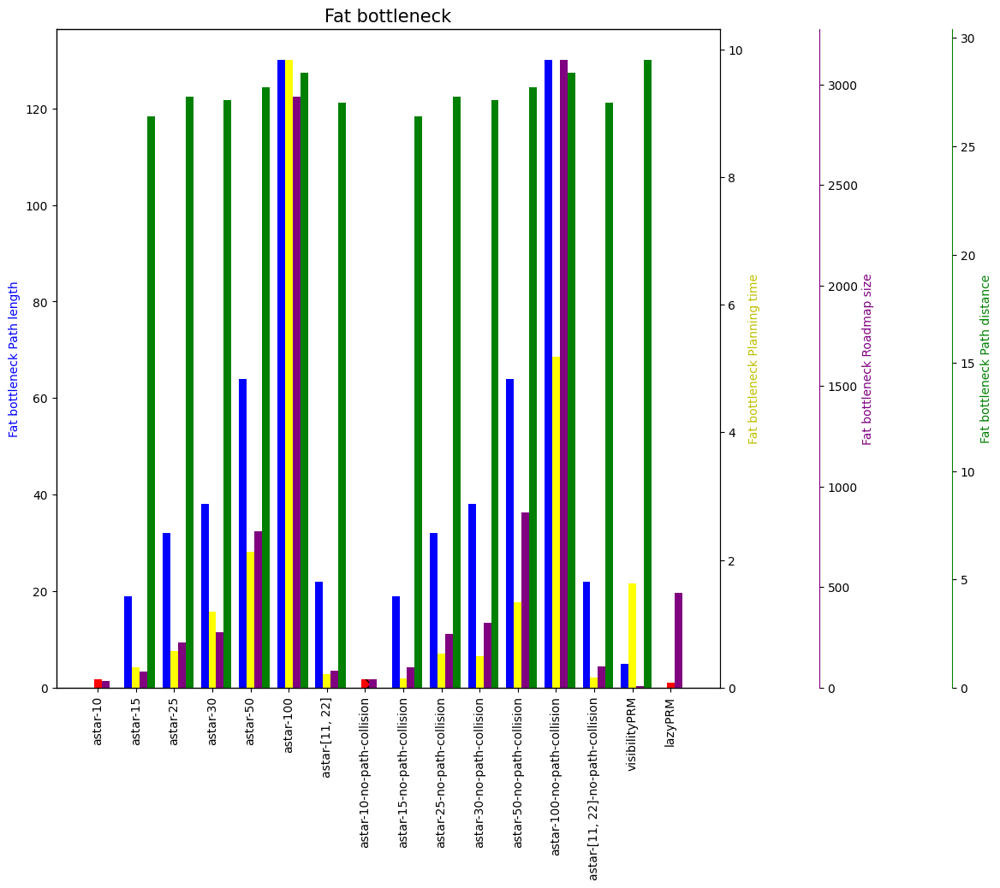

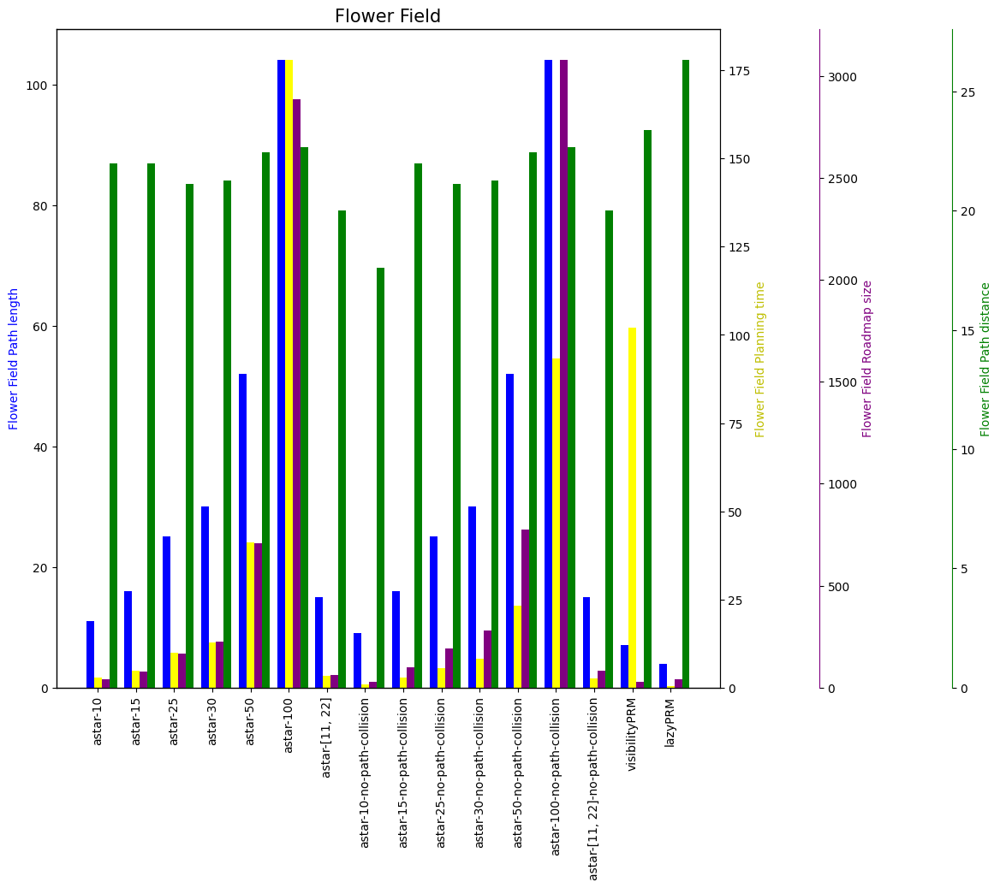

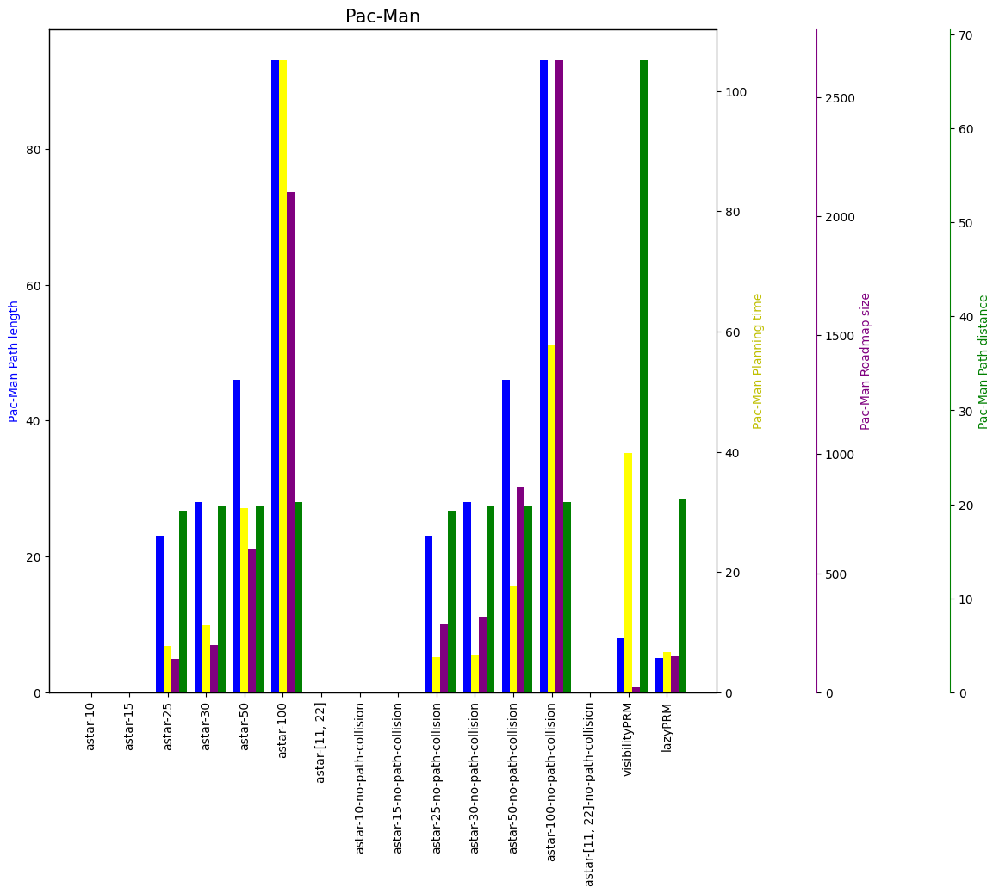

...

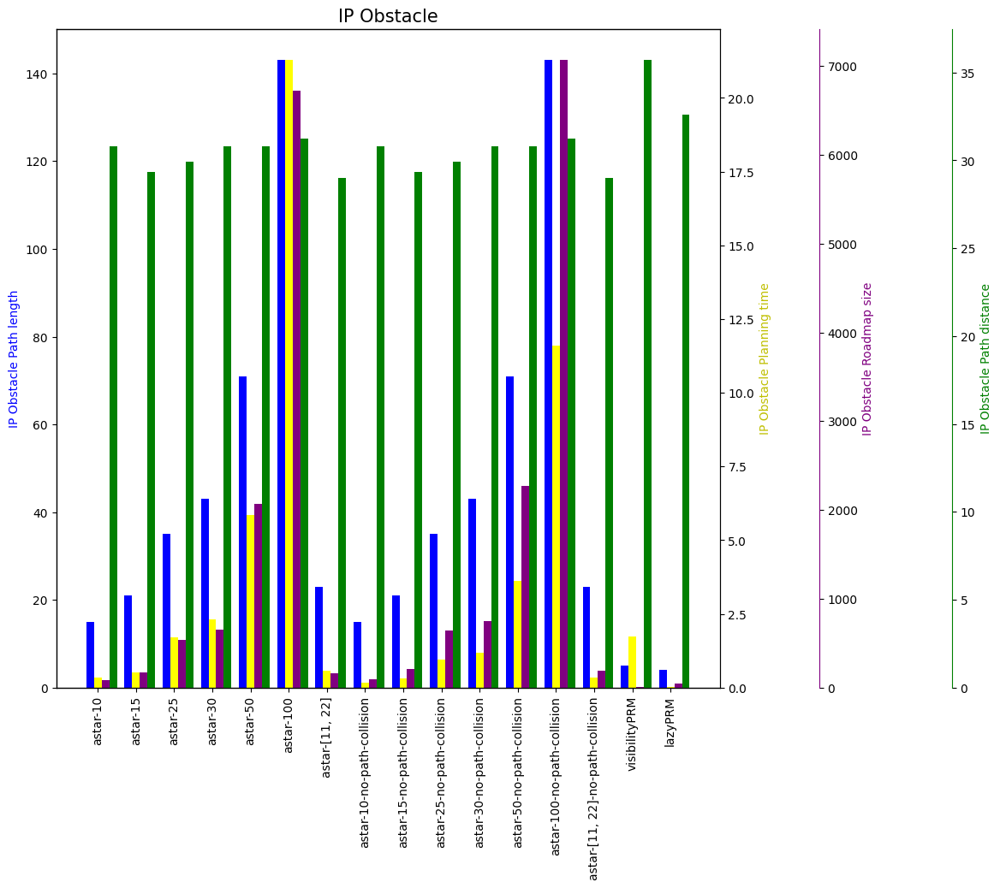

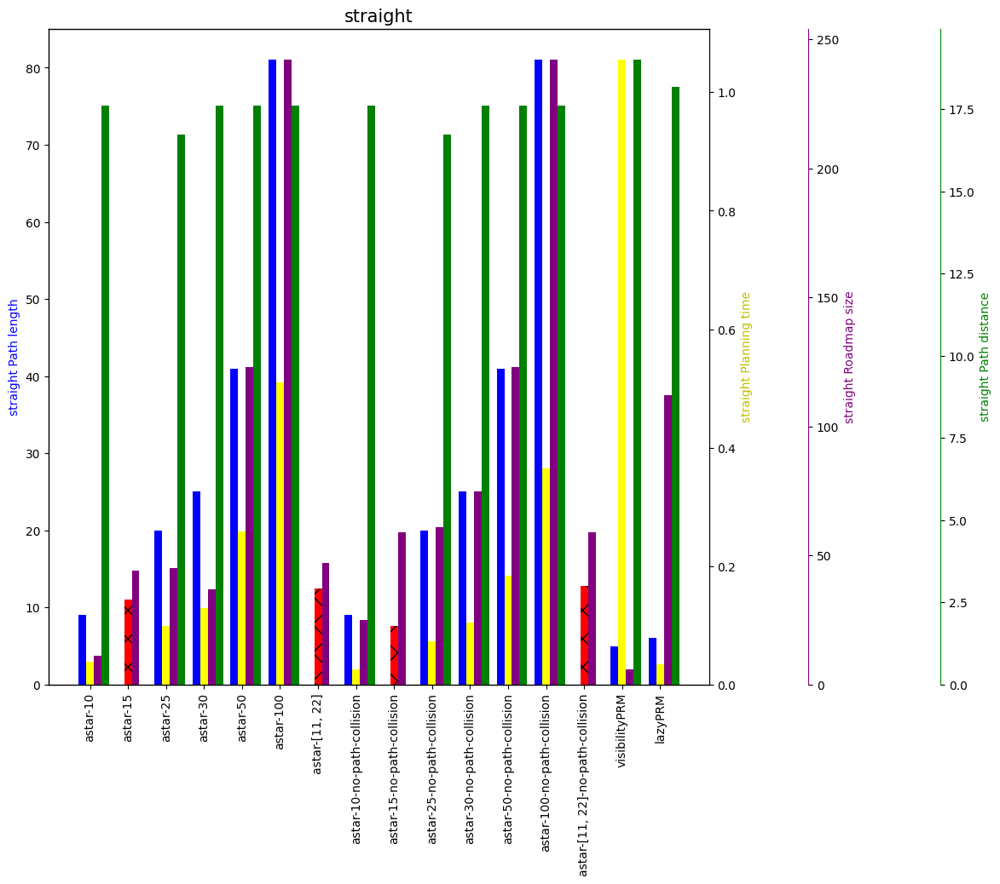

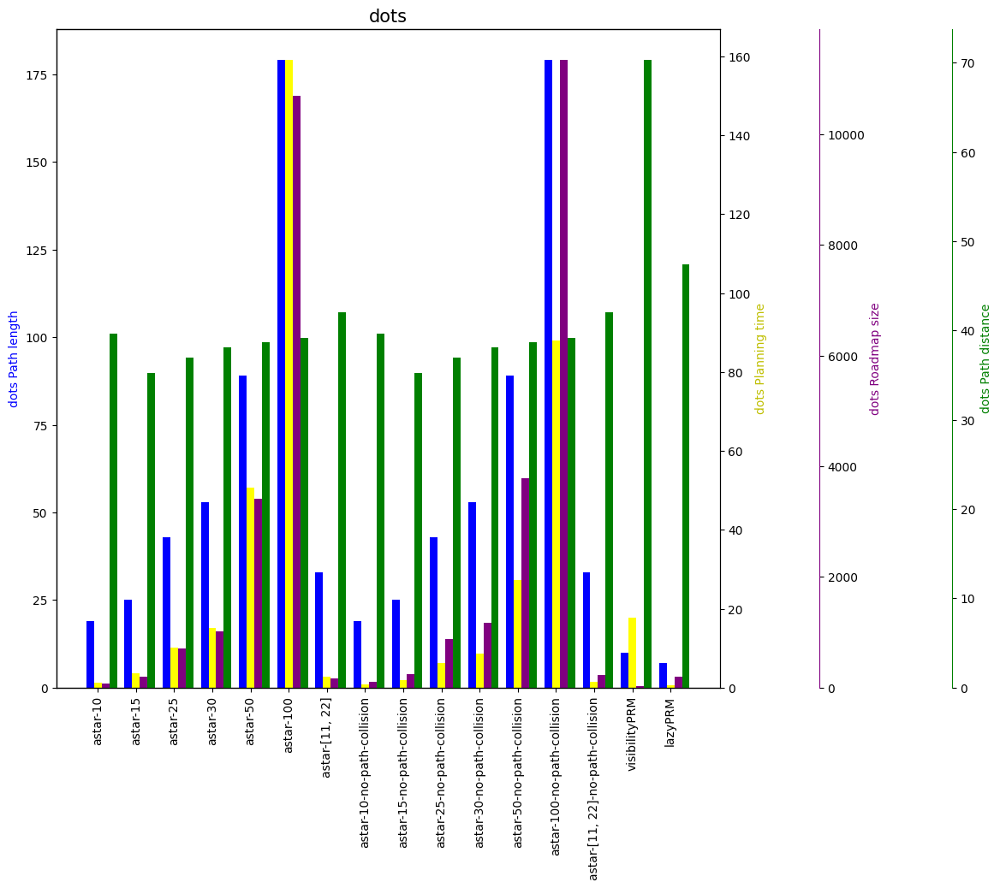

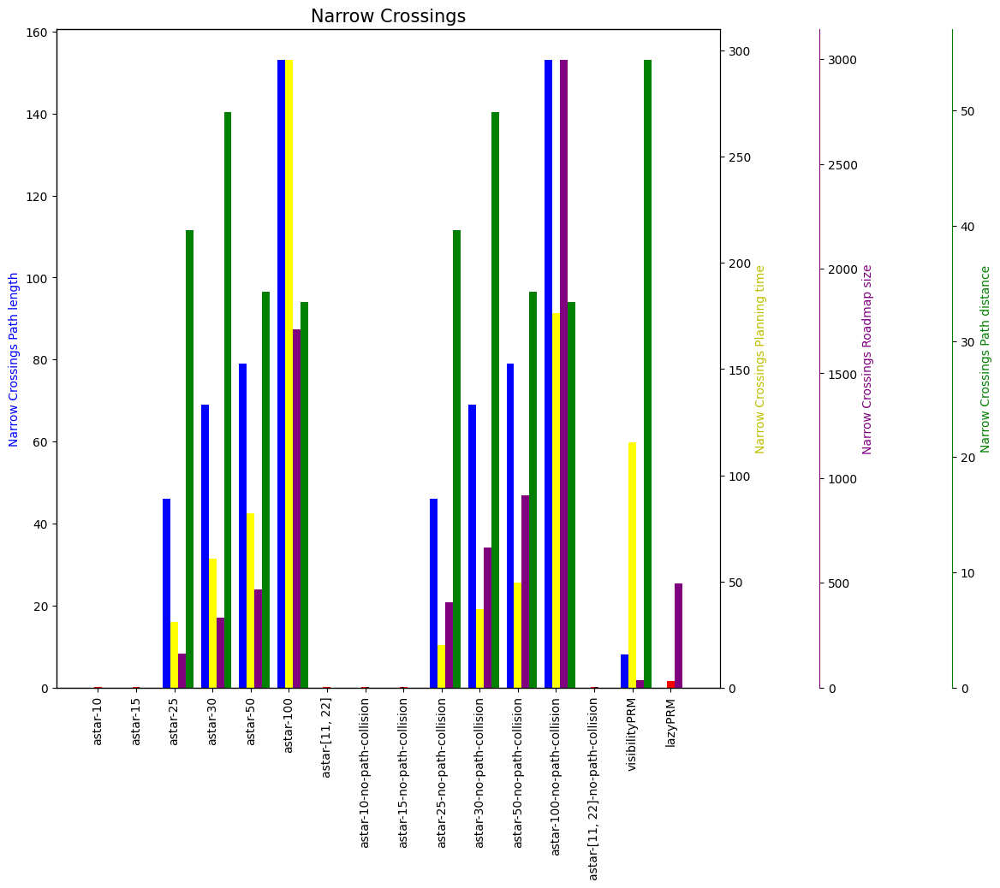

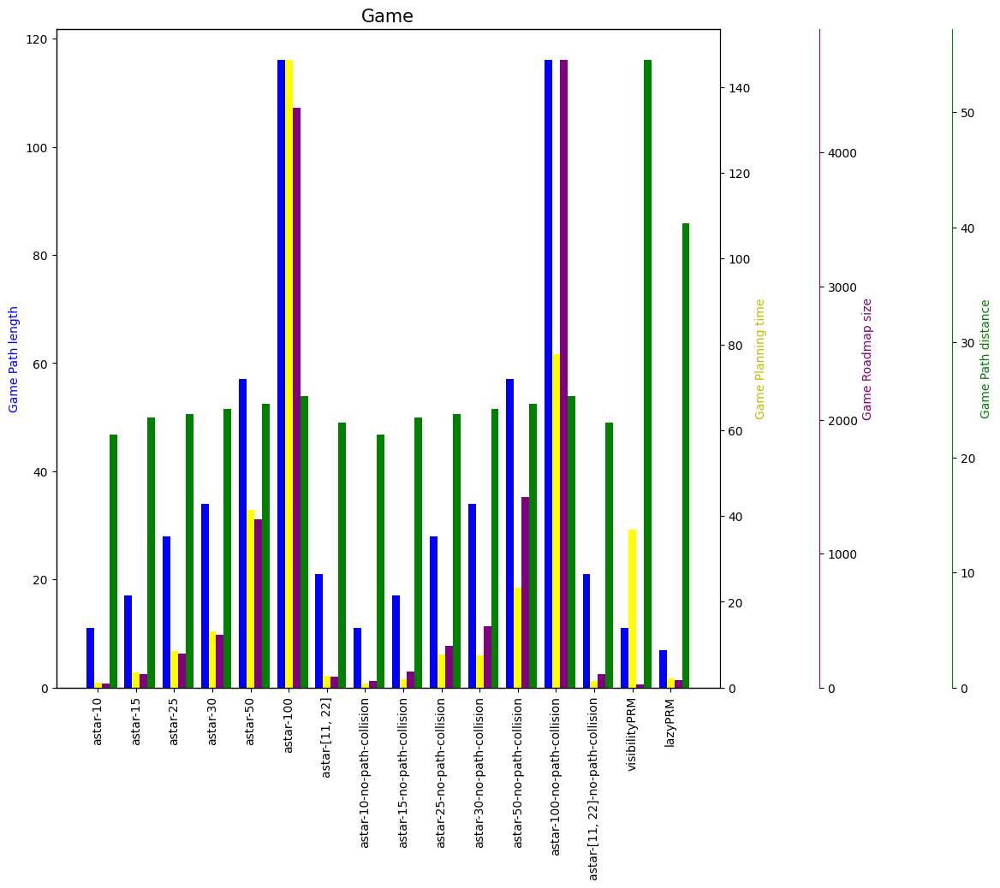

In [17]:
if export:
    os.makedirs("./export/statistics", exist_ok=True)

@dataclass
class AvgValue:
    sum: float = 0.0
    count: int = 0

@dataclass
class PlannerStatistics:
    pathLength: AvgValue
    planningTime: AvgValue
    roadmapSize: AvgValue
    pathDistance: AvgValue
    solutionsFound: AvgValue

averages = dict()

for bench in testList:
    title = bench.name
    pathLength = dict()
    planningTime = dict()
    roadmapSize  = dict()
    pathDistance = dict()
   
    # Initialize pathDistance for each planner factory outside the loop
    for result in resultList:
        pathDistance[result.plannerFactoryName] = 0
 
    for result in resultList:
        if result.benchmark.name == bench.name:
            if result.solution is None:
                pathLength[result.plannerFactoryName] = 0
            else:
                pathLength[result.plannerFactoryName] = len(result.solution)
                for i in range(0, len(result.solution)-1): 
                    pos1 = result.planner.graph.nodes[result.solution[i]]["pos"]
                    pos2 = result.planner.graph.nodes[result.solution[i + 1]]["pos"]
                    pathDistance[result.plannerFactoryName] += euclidean(pos1, pos2)
                
            planningTime[result.plannerFactoryName] = result.perfDataFrame.groupby(["name"]).sum(numeric_only=True)["time"]["planPath"]
            roadmapSize[result.plannerFactoryName] = result.planner.graph.size()

            if result.plannerFactoryName not in averages:
                ps = PlannerStatistics(AvgValue(0.0, 0), AvgValue(0.0, 0), AvgValue(0.0, 0), AvgValue(0.0, 0), AvgValue(0.0, 0))
                averages[result.plannerFactoryName] = ps


            if result.solution is not None:
                averages[result.plannerFactoryName].pathLength.sum += pathLength[result.plannerFactoryName]
                averages[result.plannerFactoryName].pathLength.count += 1

                averages[result.plannerFactoryName].planningTime.sum += planningTime[result.plannerFactoryName]
                averages[result.plannerFactoryName].planningTime.count += 1

                averages[result.plannerFactoryName].roadmapSize.sum += roadmapSize[result.plannerFactoryName]
                averages[result.plannerFactoryName].roadmapSize.count += 1

                averages[result.plannerFactoryName].pathDistance.sum += pathDistance[result.plannerFactoryName]
                averages[result.plannerFactoryName].pathDistance.count += 1

            if result.solution is not None and len(result.solution) > 0:
                averages[result.plannerFactoryName].solutionsFound.sum += 1
            averages[result.plannerFactoryName].solutionsFound.count += 1


    fig, ax = plt.subplots(figsize=(10,10))
    width = 0.2
 
    ax.bar(np.arange(len(pathLength.keys())), pathLength.values(), width, color="blue")
    ax.set_ylabel(title + " Path length", color="blue")
    ax.set_xticks(np.arange(len(pathLength.keys())) + width)
    ax.set_xticklabels(pathLength.keys(), rotation=90)
    ax.set_title(f"{title}", fontsize=15)
 
    ax2 = ax.twinx()
    bar = ax2.bar(np.arange(len(pathLength.keys())) + width, planningTime.values(), width, color="red")
    ax2.set_ylabel(title + " Planning time", color="y")
 
    # Add coloring and patterns on axis two
    hatches = ['x' if length == 0 else '' for length in pathLength.values()]
    color   = ['red' if length == 0 else 'yellow' for length in pathLength.values()]
    for i,thisbar in enumerate(bar.patches):
        thisbar.set_facecolor(color[i])
        thisbar.set_hatch(hatches[i])
 
    # Multiple axes
    ax3 = ax.twinx()
    ax3.bar(np.arange(len(pathLength.keys())) + 2 * width, roadmapSize.values(),width, color="purple")
    ax3.set_ylabel(title + " Roadmap size",  color="purple")
    ax3.spines['right'].set_position(('axes', 1.15))
    ax3.spines['right'].set_color("purple")
 
    ax4 = ax.twinx()
    ax4.bar(np.arange(len(pathLength.keys())) + 3 * width, pathDistance.values(),width, color="green")
    ax4.set_ylabel(title + " Path distance",  color="green")
    ax4.spines['right'].set_position(('axes', 1.35))
    ax4.spines['right'].set_color("green")


    if export:
        fig.savefig(f"./export/statistics/{title}.png")

## Discretized A-Star steps comparision (Task I.2)

We average over our metrics.

We then compare are different discretization of our A*.

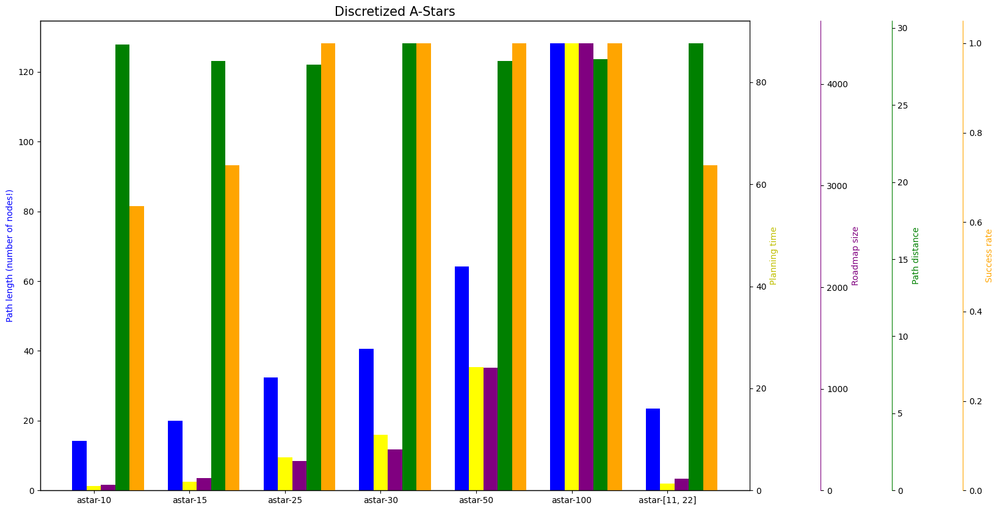

In [18]:
pathLength = dict()
planningTime = dict()
roadmapSize  = dict()
pathDistance = dict()
solutionsFound = dict()
 
for plannerName, avgValues in averages.items():
    if "PRM" not in plannerName and "no-path-collision" not in plannerName:
        pathLength[plannerName] = avgValues.pathLength.sum / avgValues.pathLength.count
        planningTime[plannerName] = avgValues.planningTime.sum / avgValues.planningTime.count
        roadmapSize[plannerName] = avgValues.roadmapSize.sum / avgValues.roadmapSize.count
        pathDistance[plannerName] = avgValues.pathDistance.sum / avgValues.pathDistance.count
        solutionsFound[plannerName] = avgValues.solutionsFound.sum / avgValues.solutionsFound.count

fig, ax = plt.subplots(figsize=(15,10))
 
width = 0.15

ax.bar(np.arange(len(pathLength.keys())), pathLength.values(), width, color="blue")
ax.set_ylabel("Path length (number of nodes!)", color="blue")
ax.set_xticks(np.arange(len(pathLength.keys())) + width)
ax.set_xticklabels(pathLength.keys())
ax.set_title("Discretized A-Stars", fontsize=15)

ax2 = ax.twinx()
bar = ax2.bar(np.arange(len(pathLength.keys()))+width, planningTime.values(), width, color="red")
ax2.set_ylabel("Planning time", color="y")

# Add coloring and patterns on axis two
hatches = ['x' if length==0 else '' for length in pathLength.values()]
color   = ['red' if length==0 else 'yellow' for length in pathLength.values()]
for i,thisbar in enumerate(bar.patches):
    thisbar.set_facecolor(color[i])
    thisbar.set_hatch(hatches[i])

# Multiple axes
ax3 = ax.twinx()
ax3.bar(np.arange(len(pathLength.keys())) + 2 * width, roadmapSize.values(), width, color="purple")
ax3.set_ylabel("Roadmap size",  color="purple")
ax3.spines['right'].set_position(('axes', 1.1))
ax3.spines['right'].set_color("purple")

ax4 = ax.twinx()
ax4.bar(np.arange(len(pathLength.keys())) + 3 * width, pathDistance.values(), width, color="green")
ax4.set_ylabel("Path distance",  color="green")
ax4.spines['right'].set_position(('axes', 1.2))
ax4.spines['right'].set_color("green")

ax5 = ax.twinx()
ax5.bar(np.arange(len(pathLength.keys())) + 4 * width, solutionsFound.values(),width, color="orange")
ax5.set_ylabel("Success rate",  color="orange")
ax5.spines['right'].set_position(('axes', 1.3))
ax5.spines['right'].set_color("orange")


if export:
    plt.savefig(f"./export/statistics/average_astar_discretized.png", bbox_inches='tight')


## Discussion: A* with different discretization (Task I.2)

In general, a finer discretization leads to shorter paths. Outliers might still occur, like in *astar-30*. Reason for this is, that the collision object and the grid might be positioned unfavorable for *astar-30*, resp. favorable in the case for *astar-25*. Still the gains look marginal, but this might also due to the fact that we did not compare the averaged relative changes and only the average absolute path distances, leading to a lesser impact on gains in shorter paths.
Additionally, we get an increasing success rate. But even with coarse steps, an optimal success rate can be achieved.
The planning time looks like an exponentially function. 

With the exponentially costs in the planning time and only marginal shorter paths for very fine discretization as well as a high success rate for coarse discretization, a relatively coarse step size would be favorable. Choosing the right discretization would be an open problem for this solution.


## Success rates

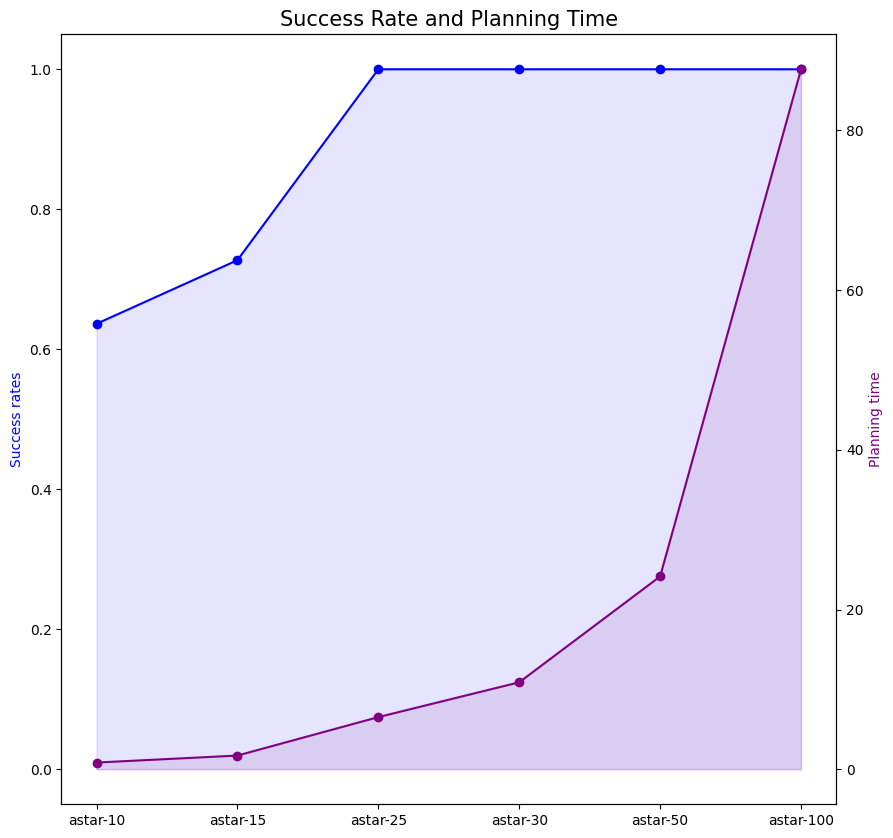

In [19]:
solutionsFound = dict()
planningTime = dict()

for plannerName, avgValues in averages.items():
    if "PRM" not in plannerName and "no-path-collision" not in plannerName and "[" not in plannerName:
        solutionsFound[plannerName] = avgValues.solutionsFound.sum / avgValues.solutionsFound.count
        planningTime[plannerName] = avgValues.planningTime.sum / avgValues.planningTime.count

fig, ax = plt.subplots(figsize=(10,10))
 
width = 0.2


#ax.bar(np.arange(len(solutionsFound.keys())), solutionsFound.values(),width, color=["blue", "red", "yellow", "green"])
ax.plot(solutionsFound.values(), linestyle='-', marker='o', color='b')
ax.fill_between(
        np.arange(len(solutionsFound.keys())),
        solutionsFound.values(),
        color= "b",
        alpha= 0.1)
ax.set_ylabel("Success rates", color="blue")
ax.set_xticks(np.arange(len(solutionsFound.keys())))
ax.set_xticklabels(solutionsFound.keys())
ax.set_title("Success Rate and Planning Time", fontsize=15)
ax2 = ax.twinx()
ax2.plot(planningTime.values(), linestyle='-', marker='o', color='purple')
ax2.set_ylabel("Planning time", color="purple")
ax2.fill_between(
        np.arange(len(planningTime.keys())),
        planningTime.values(),
        color= "purple",
        alpha= 0.1)

if export:
    plt.savefig(f"./export/statistics/average_astar_discret_success_planning.png", bbox_inches='tight')


## A*: With path collision and without (Task I.2)

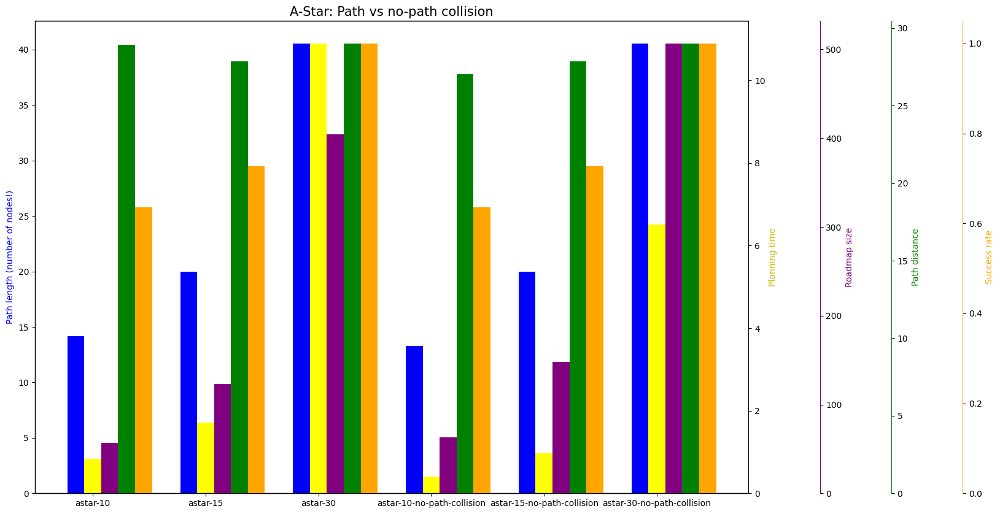

In [20]:
pathLength = dict()
planningTime = dict()
roadmapSize  = dict()
pathDistance = dict()
solutionsFound = dict()


for plannerName, avgValues in averages.items():
    if "PRM" not in plannerName and "100" not in plannerName and ("10" in plannerName or "15" in plannerName or "30" in plannerName):
        pathLength[plannerName] = avgValues.pathLength.sum / avgValues.pathLength.count
        planningTime[plannerName] = avgValues.planningTime.sum / avgValues.planningTime.count
        roadmapSize[plannerName] = avgValues.roadmapSize.sum / avgValues.roadmapSize.count
        pathDistance[plannerName] = avgValues.pathDistance.sum / avgValues.pathDistance.count
        solutionsFound[plannerName] = avgValues.solutionsFound.sum / avgValues.solutionsFound.count


fig, ax = plt.subplots(figsize=(15,10))
 
width = 0.15

ax.bar(np.arange(len(pathLength.keys())), pathLength.values(), width, color="blue")
ax.set_ylabel("Path length (number of nodes!)", color="blue")
ax.set_xticks(np.arange(len(pathLength.keys())) + width)
ax.set_xticklabels(pathLength.keys())
ax.set_title("A-Star: Path vs no-path collision", fontsize=15)

ax2 = ax.twinx()
bar = ax2.bar(np.arange(len(pathLength.keys()))+width, planningTime.values(), width, color="red")
ax2.set_ylabel("Planning time", color="y")

# Add coloring and patterns on axis two
hatches = ['x' if length==0 else '' for length in pathLength.values()]
color   = ['red' if length==0 else 'yellow' for length in pathLength.values()]
for i,thisbar in enumerate(bar.patches):
    thisbar.set_facecolor(color[i])
    thisbar.set_hatch(hatches[i])

# Multiple axes
ax3 = ax.twinx()
ax3.bar(np.arange(len(pathLength.keys())) + 2 * width, roadmapSize.values(), width, color="purple")
ax3.set_ylabel("Roadmap size",  color="purple")
ax3.spines['right'].set_position(('axes', 1.1))
ax3.spines['right'].set_color("purple")

ax4 = ax.twinx()
ax4.bar(np.arange(len(pathLength.keys())) + 3 * width, pathDistance.values(), width, color="green")
ax4.set_ylabel("Path distance",  color="green")
ax4.spines['right'].set_position(('axes', 1.2))
ax4.spines['right'].set_color("green")

ax5 = ax.twinx()
ax5.bar(np.arange(len(pathLength.keys())) + 4 * width, solutionsFound.values(),width, color="orange")
ax5.set_ylabel("Success rate",  color="orange")
ax5.spines['right'].set_position(('axes', 1.3))
ax5.spines['right'].set_color("orange")

# Adjust layout to make room for all axes labels


if export:
    plt.savefig(f"./export/statistics/average_astar_discretized_no_path_comparison.png", bbox_inches='tight')


## Discussion A* with and without collision (Task 2)
When you implement path collision for every new neighbor you have to calculate if the line is in collision with x intermediate points. This number of collision checks increases the planning time immensely as seen in this histogram. The left-hand side shows longer planning time which increases exponentially with the number of discretization steps.

A benefit of activating path collisions/line collisions is that we avoid the possibility of running into obstacles along the line from one configuration to the other.

![collision.png](images/collision.png)


Finally one can say that the line collisions could be beneficial for coarse discretized environments due to the large gap between points. The finer the grid the fewer points should be checked in between due to the higher computational costs.


## PRM vs A* (Task I.3)

Vergleich des Visibility- und Lazy-PRM Verfahrens mit verschiedenen A-Stern Diskretisierungen.

Stufen = \[10, 15, 25\]

Die Metriken werden über alle Testumgebungen gemittelt.

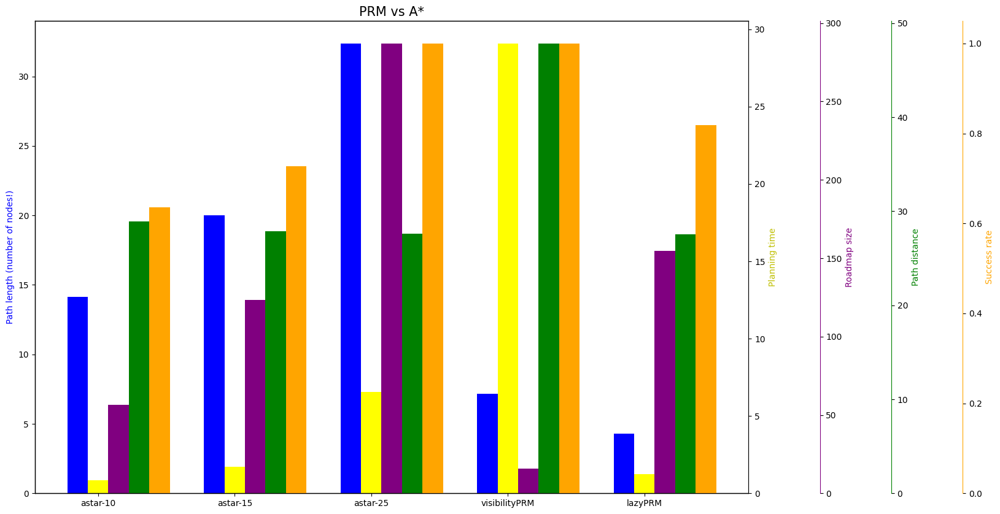

In [21]:
pathLength = dict()
planningTime = dict()
roadmapSize  = dict()
pathDistance = dict()
solutionsFound = dict()


for plannerName, avgValues in averages.items():
    if "no-path-collision" not in plannerName and "astar-100" not in plannerName and ("PRM" in plannerName or "astar-10" in plannerName or "astar-15" in plannerName or "astar-25" in plannerName):
        pathLength[plannerName] = avgValues.pathLength.sum / avgValues.pathLength.count
        planningTime[plannerName] = avgValues.planningTime.sum / avgValues.planningTime.count
        roadmapSize[plannerName] = avgValues.roadmapSize.sum / avgValues.roadmapSize.count
        pathDistance[plannerName] = avgValues.pathDistance.sum / avgValues.pathDistance.count
        solutionsFound[plannerName] = avgValues.solutionsFound.sum / avgValues.solutionsFound.count


fig, ax = plt.subplots(figsize=(15,10))
 
width = 0.15

ax.bar(np.arange(len(pathLength.keys())), pathLength.values(), width, color="blue")
ax.set_ylabel("Path length (number of nodes!)", color="blue")
ax.set_xticks(np.arange(len(pathLength.keys())) + width)
ax.set_xticklabels(pathLength.keys())
ax.set_title("PRM vs A*", fontsize=15)

ax2 = ax.twinx()
bar = ax2.bar(np.arange(len(pathLength.keys()))+width, planningTime.values(), width, color="red")
ax2.set_ylabel("Planning time", color="y")

# Add coloring and patterns on axis two
hatches = ['x' if length==0 else '' for length in pathLength.values()]
color   = ['red' if length==0 else 'yellow' for length in pathLength.values()]
for i,thisbar in enumerate(bar.patches):
    thisbar.set_facecolor(color[i])
    thisbar.set_hatch(hatches[i])

# Multiple axes
ax3 = ax.twinx()
ax3.bar(np.arange(len(pathLength.keys())) + 2 * width, roadmapSize.values(), width, color="purple")
ax3.set_ylabel("Roadmap size",  color="purple")
ax3.spines['right'].set_position(('axes', 1.1))
ax3.spines['right'].set_color("purple")

ax4 = ax.twinx()
ax4.bar(np.arange(len(pathLength.keys())) + 3 * width, pathDistance.values(), width, color="green")
ax4.set_ylabel("Path distance",  color="green")
ax4.spines['right'].set_position(('axes', 1.2))
ax4.spines['right'].set_color("green")

ax5 = ax.twinx()
ax5.bar(np.arange(len(pathLength.keys())) + 4 * width, solutionsFound.values(),width, color="orange")
ax5.set_ylabel("Success rate",  color="orange")
ax5.spines['right'].set_position(('axes', 1.3))
ax5.spines['right'].set_color("orange")

# Adjust layout to make room for all axes labels


if export:
    plt.savefig(f"./export/statistics/average_astar_prm.png", bbox_inches='tight')


## Discussion: PRM vs A*

**lazyPRM**
The lazyPRM is the most competitive finds the shortest paths and contains the lowest planning time in relation to the high success rate. It provides a well-balanced mix of all the metrics.

**visibilityPRM**
The visibilityPRM has a 100% success rate but a high path distance and a high planning time. This makes the visibilityPRM the least competitive choice.

**A\***
The A* finds the optimal paths in its discrete world. In terms of planning time, it can only compete in relative coarse discretization like the *astar-10* or *astar-15*. However, the success rate is very low compared to the lazyPRM. Also, the path distances are on average longer than the lazyPRM. Only starting with *astar-25* we achieve also an optimal success rate and comparable path distances. But the planning time is considerably longer. Nonetheless, the path is more directed, so the post-processing might be faster.

# Execute A* path

## Naiv approach (Task II.1)

Our result path comprises the respective points in the implicit C-space as a sequence of configurations (e.g. 2D [-1.3-2.5-; -1.6-2.5- ...]). The movement directives the robot could use would comprise functions relating to the movement angle of the respective joint.

Given our path in the joint room, we can call for each point pair $(p_i, p_{i+1})$ on the path a point-to-point command. The movement should stop at the current endpoint $p_{i+1}$ so we will not get any abrupt direction changes.
Synchronous or asynchronous would not matter due to the fact that only one joint is moved at a time.

**Possible problems**

1. This would be an easy option but due to the current nature that we have many points on our current path, this would require a lot of stops and go's even if no direction change occurred.

2. Dynamic obstacles along the way when moving to a point have to be handled (see Task II.2)

3. The inaccuracy of sensors and actors has to be accounted for in the obstacles and the movements.  (we assume it is).

## Better approach (Task II.2)

Solving problem 1: Post-processing on the path
1. Remove collinear points
= Otherwise we would have to stop often

![image.png](images/output4.png)
![image.png](images/output5.png)

3. Delete triangle points
= Only if the three involved points are next to each other in the grid and not collision occurs on the diagonal

![image.png](images/output2.png)
![image.png](images/output3.png)

4. Merge diagonal
= Remove diagonal collinear points

Why can we do this?
1. The path between was collision-free
2. Collision check explicitly
3. The path was collision-free

Leads to a path that minimized stop and go's but still not complete eliminated.
Additional smoothing afterward would be required using the post-processed path.

Solving problem 2

In general, always update the collision domain. A possible solution would then:

Dynamic A* replanning
- Collision detected on the current path?
- Either stop the current motion and replan from the current point, or do the replanning at a later start point to avoid stopping the robot if possible.

Solving problem 3
- Extent collision boxes to mitigate any possible sensory accuracies



